StatementMeta(, 20d17564-5dd5-4e98-bd83-371f4163e709, 6, Finished, Available)

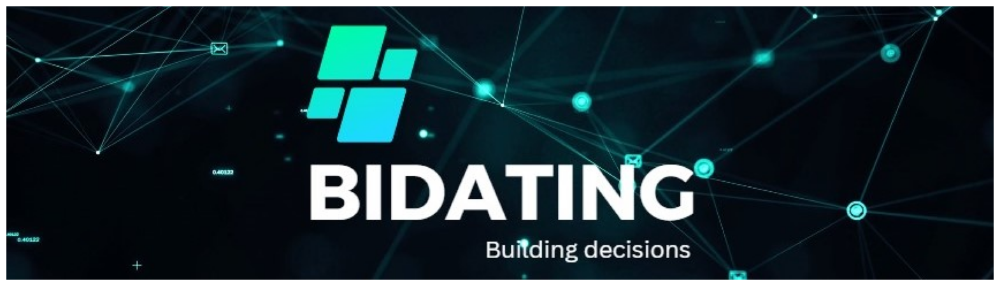

In [4]:
Imagen("Files/BANNER BIDATING.jpeg", (20,10))

# <h1 align=center> **INFORME E D A** </h1>

# Instalación de librerías y dependencias.

In [2]:
!pip install missingno -q

StatementMeta(, feccef4b-c867-465c-80fb-95beaf0f2752, 4, Finished, Available)

In [3]:
!pip install wordcloud

StatementMeta(, feccef4b-c867-465c-80fb-95beaf0f2752, 5, Finished, Available)

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 511.1/511.1 kB 12.1 MB/s eta 0:00:00a 0:00:01


In [12]:
# Modulos a utilizar
import os
import pandas as pd
import numpy as np
import pyarrow as pa
import pyarrow.parquet as pq
import missingno as msno
import matplotlib.pyplot as plt
import seaborn as sns
from collections import Counter
import warnings
warnings.filterwarnings(action= 'ignore')
import matplotlib.pyplot as plt
import seaborn as sns
from wordcloud import WordCloud
from nltk.tokenize import word_tokenize
from nltk.corpus import stopwords
from nltk.sentiment.vader import SentimentIntensityAnalyzer
import nltk
nltk.download('punkt')
import nltk
nltk.download('stopwords')

StatementMeta(, feccef4b-c867-465c-80fb-95beaf0f2752, 14, Finished, Available)

[nltk_data] Downloading package punkt to /home/trusted-service-
[nltk_data]     user/nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package stopwords to /home/trusted-service-
[nltk_data]     user/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.


True

In [3]:
def Imagen(path_relativo: str, size: tuple[int,int], path_absoluto: None|str= None):


    import matplotlib.pyplot as plt
    import matplotlib.image as mpimg

    # image
    # "Files/ESQUEMA INFORME E D A.png"
    if path_absoluto == None:
        # Load image
        image = mpimg.imread("/lakehouse/default/" + path_relativo)
    else:
        # Load image
        image = mpimg.imread(path_absoluto)
    # Let the axes disappear
    plt.figure(figsize= size)
    plt.axis('off')
    # Plot image in the output
    image_plot = plt.imshow(image)

StatementMeta(, ef72fbd7-4cd5-4501-8758-3f0e5b562cef, 5, Finished, Available)

# Funciones

### Para Análisis general.

In [40]:
def informe_general(dataframe):

    df_info = verificar_tipo_datos(dataframe)

    informe_df = informe_dataframe(dataframe)

    columnas_info = []
    for columna in dataframe.columns:
        info = informe_columna(dataframe, columna)
        columnas_info.append(info)
    
    visualizar_nulos(dataframe)
    
    analisis_frecuencia_palabras(dataframe)
    
    boxplots_numericas(dataframe)

    hist_duplicados(dataframe)

    return df_info, informe_df, columnas_info


StatementMeta(, 76ae3ccc-0ff3-43ab-b08b-381e5e4bde92, 41, Finished, Available)

- VERIFICAR TIPO DE DATOS.

In [5]:
def verificar_tipo_datos(df):
    
    mi_dict = {"nombre_campo": [], "tipo_datos": [], "no_nulos_%": [], "nulos_%": [], "nulos": []}

    for columna in df.columns:
        porcentaje_no_nulos = (df[columna].count() / len(df)) * 100
        mi_dict["nombre_campo"].append(columna)
        mi_dict["tipo_datos"].append(df[columna].apply(type).unique())
        mi_dict["no_nulos_%"].append(round(porcentaje_no_nulos, 2))
        mi_dict["nulos_%"].append(round(100-porcentaje_no_nulos, 2))
        mi_dict["nulos"].append(df[columna].isnull().sum())

    df_info = pd.DataFrame(mi_dict)
    pd.set_option('display.max_rows', None)

    return df_info

StatementMeta(, 76ae3ccc-0ff3-43ab-b08b-381e5e4bde92, 6, Finished, Available)

- INFORME DATAFRAME.

In [6]:
def informe_dataframe(dataframe: pd.DataFrame) -> None:

    df = dataframe

    print('INFORME PRELIMINAR SOBRE CARACTERISTICAS DEL DATASET:\n')
    print(f'--Dimensiones del DataFrame--\nFilas: {df.shape[0]}\nColumnas: {df.shape[1]}\n')
    print(f'--Numero de datos--\n{df[df.isna() == False].count().sum()}\n')
    print(f'--Filas y Columnas--\nFilas: muestra de indices-------> {list(df.index)[0:5]}  -----> Desde {list(df.index)[0]}  Hasta {list(df.index)[-1]}\nColumnas: {list(df.columns)}\n')
    print(f'--Tipo de columnas--\n{df.dtypes}\n')
    columnas= df.columns

    if 'hours' in columnas and 'attributes' not in columnas:
        print(f'--Cantidad de registros duplicados--\n{df.drop(columns=["hours"]).duplicated().sum()}\n')
    elif 'hours' not in columnas and 'attributes' in columnas:
        print(f'--Cantidad de registros duplicados--\n{df.drop(columns=["attributes"]).duplicated().sum()}\n')
    elif 'hours' in columnas and 'attributes' in columnas:
        print(f'--Cantidad de registros duplicados--\n{df.drop(columns=["hours","attributes"]).duplicated().sum()}\n')
    else:
        print(f'--Cantidad de registros duplicados--\n{df.duplicated().sum()}\n')


    # print(f'--Estadisticos preliminares generales--\n{df.describe()}\n')

    return ('~'*50)+'oo'+('~'*50)

StatementMeta(, 76ae3ccc-0ff3-43ab-b08b-381e5e4bde92, 7, Finished, Available)

- INFORME COLUMNAS.

In [32]:
def informe_columna(df: None|pd.DataFrame, columna: None|str) -> None:

    data = df[columna]

    def valores_atipicos(muestra):
        import numpy as np

        if muestra.dtype != 'datetime64[ns]' and muestra.dtype != 'object':
            Q1= muestra.quantile(0.25)
            Q3= muestra.quantile(0.75)
            mediana= muestra.median()
            IQR= Q3-Q1

            print(f'Rango intercuartilico: {IQR}')

            limit_sup= Q3 + 1.5*IQR
            limit_inf= Q1 - 1.5*IQR
            print(f'Limite superior de la caja: {limit_sup}\n')
            # print(limit_inf)

            ## buscamos los valores atipicos
            superior= muestra >= (Q3 + 1.5*IQR)
            inferior=  muestra <= (Q1 - 1.5*IQR)

            print(f'Indices donde el valor excede el valor excede el limite superior de la caja:\n {np.where(superior)}\n')
            print(f'Indices donde el valor excede el valor excede el limite inferior de la caja:\n {np.where(inferior)}\n')
        else:
            pass

    # print(f'Informe preliminar sobre la columna/feature {columna}:\n')
    print(f'INFORME PRELIMINAR SOBRE LA COLUMNA/FEATURE {columna}:\n')
    if data.dtype == 'object':
        print(f'--Numero de datos nulos--\n{data.isna().sum()}\n')
        print(f'--Cantidad de valores unicos en la columna--\n{data.describe()[1]}\n')

        if len(data.unique()) > 5:
            print(f'--Valores unicos en la columna (Primeros 5 valores)--\n{data.unique()[0:5]}\n')
        else:
            print(f'--Valores unicos en la columna--\n{data.unique()}\n')
            
        print(f'--Moda de la columna especificada--\nValor modal -----> {data.describe()[2]}\nFrecuencia acumulada ------> {data.describe()[3]}\n')
        print(f'--Distribucion de frecuencias (primeros valores con mayor cantidad de frecuencias)--\n {data.value_counts().nlargest(3)}\n')
        print('-'*120)
        print('-'*120)
    elif data.dtype == 'datetime64[ns]':
        print(f'--Numero de datos nulos--\n{data.isna().sum()}\n')
        print(f'--Cantidad de valores unicos en la columna--\n{data.describe()[1]}\n')
        ## En el print siguinte, realizamos un formateo de los valores de la columna, ya que la salida predeterminada (el output) agrega otros valores que hacen la intrepretacion mas dificil e incomoda
        print(f'--Valores unicos en la columna--\nEj: {data.dt.strftime("%Y-%m-%d").unique()[0:3]}  -----> Desde {list(data.dt.strftime("%Y-%m-%d").unique())[0]}  Hasta {list(data.dt.strftime("%Y-%m-%d").unique())[-1]}\n')
        print(f'--Moda de la columna especificada--\nValor modal -----> {data.describe()[2]}\nFrecuencia acumulada ------> {data.describe()[3]}\n')
        print(f'--Distribucion de frecuencias (primeros valores con mayor cantidad de frecuencias)--\n {data.value_counts().nlargest(3)}\n')
        print(f'--Valor maximo y minimo--\nMaximo: {data.max()}\nMinimo: {data.min()}\n')
        print('-'*120)
        print('-'*120)
    else:
        print(f'--Numero de datos nulos--\n{data.isna().sum()}\n')
        print(f'--Valores unicos en la columna--\nEj: {data.unique()[0:5]}  -----> Desde {list(data.unique())[0]}  Hasta {list(data.unique())[-1]}\n')
        print(f'--Estadisticos Principales de la columna--\nMedia: {round(data.mean(),2)}\nDesviacion Estandar: {round(data.std(),2)}\nPrimer cuartil: {data.quantile(0.25)}\nMediana: {data.median()}\nTercer cuartil: {data.quantile(0.75)}\n')
        print(f'--Valores extremos--\nValor maximo: {data.max()}\nValor minimo: {data.min()}\n')
        print(f'--Distribucion de frecuencias (primeros valores con mayor cantidad de frecuencias)--\n {data.value_counts().nlargest(3)}\n')
        print(f'--Valor maximo y minimo--\nMaximo: {data.max()}\nMinimo: {data.min()}\n')
        valores_atipicos(data)
        print('-'*120)
        print('-'*120)
    return

StatementMeta(, 76ae3ccc-0ff3-43ab-b08b-381e5e4bde92, 33, Finished, Available)

- VISUALIZAR NULOS.

In [8]:
def visualizar_nulos(df):
    fig, axes = plt.subplots(2, 2, figsize=(40, 40))

    msno.matrix(df, ax=axes[0, 0])
    msno.bar(df, ax=axes[0, 1])  
    msno.heatmap(df, ax=axes[1, 0])
    msno.dendrogram(df, ax=axes[1, 1])

    axes[0, 0].set_title('Matrix Plot')
    axes[0, 1].set_title('Bar Plot')
    axes[1, 0].set_title('Heatmap')
    axes[1, 1].set_title('Dendrogram')
    #plt.figure(figsize= (30,30))

    #msno.matrix(df)
    #plt.title('Matrix Plot')

    #msno.bar(df)
    #plt.title('Bar Plot')  

    #msno.heatmap(df)
    #plt.title('Heatmap')
    
    #msno.dendrogram(df)
    #plt.title('Dendrogram')

    plt.tight_layout()
    plt.show()

    

StatementMeta(, 76ae3ccc-0ff3-43ab-b08b-381e5e4bde92, 9, Finished, Available)

- VISUALIZACIÓN DE VALORES ATÍPICOS, EXTREMOS Y OUTLIERS.

_Columnas Cualitativas._

In [9]:
def analisis_frecuencia_palabras(dataframe: pd.DataFrame|None, ax=None):

    columnas_cualitativas = dataframe.select_dtypes(include=['object']).columns.tolist()

    if not columnas_cualitativas:
        return 'No existen columnas de tipo str en el dataframe'
    for columna in columnas_cualitativas:
        dataframe[columna] = dataframe[columna].astype(str)
    for columna in columnas_cualitativas:
        texto_columna = dataframe[columna].str.lower().str.replace(r'[^a-zA-Z\s]', '').str.split()
        palabras_columna = [word for sublist in texto_columna for word in sublist]
        frecuencia_palabras = Counter(palabras_columna)
        palabras_mas_frecuentes = frecuencia_palabras.most_common(20)
        plt.figure(figsize=(10, 6))
        plt.bar(*zip(*palabras_mas_frecuentes))
        plt.xticks(rotation=45)
        plt.xlabel('Palabra')
        plt.ylabel('Frecuencia')
        plt.title(f'Palabras más frecuentes en la columna {columna}')
        plt.show()

StatementMeta(, 76ae3ccc-0ff3-43ab-b08b-381e5e4bde92, 10, Finished, Available)

_Columnas Cuantitativas._

In [10]:
def boxplots_numericas(dataframe):
    df_numericas = dataframe.select_dtypes(include=['number'])
    if df_numericas.empty:
        return 'No existen columnas de tipo numericas en el dataframe'
    for columna in df_numericas.columns:
        sns.boxplot(x=dataframe[columna])
        plt.title(f'Diagrama de caja para {columna}')
        plt.show()

StatementMeta(, 76ae3ccc-0ff3-43ab-b08b-381e5e4bde92, 11, Finished, Available)

 - VISUALIZACIÓN DE VALORES DUPLICADOS.

In [11]:
def hist_duplicados(dataframe: str|pd.DataFrame):

    columnas= dataframe.columns

    if 'hours' in columnas and 'attributes' not in columnas:
        df_duplicates= dataframe.drop(columns=["hours"]).duplicated().value_counts()
    elif 'hours' not in columnas and 'attributes' in columnas:
        df_duplicates= dataframe.drop(columns=["attributes"]).duplicated().value_counts()
    elif 'hours' in columnas and 'attributes' in columnas:
        df_duplicates= dataframe.drop(columns=["hours","attributes"]).duplicated().value_counts()
    else:
        df_duplicates= dataframe.duplicated().value_counts()
        
    df_duplicates = pd.DataFrame({'Duplicados': df_duplicates.index, 'Frecuencia': df_duplicates.values})
    if not df_duplicates.empty: 
        sns.barplot(x='Duplicados', y='Frecuencia', data=df_duplicates)
        plt.title('Conteo de Frecuencias de Registros Duplicados')
        plt.xlabel('Duplicados')
        plt.ylabel('Frecuencia')
        plt.xticks([0, 1], ['No Duplicados', 'Duplicados'])
        plt.show()
    else:
        print("No se encontraron registros duplicados.")

StatementMeta(, 76ae3ccc-0ff3-43ab-b08b-381e5e4bde92, 12, Finished, Available)

### Para Análisis descriptivo.


In [5]:
def descripcion_distribucion(df: pd.DataFrame):
    '''
    Crea una serie de gráficos de barras y de torta que muestran la distribución de los valores de la feature/columna.

    También imprime una serie de valores y métricas básicas en referencia a los valores y distribución de valores de la columna/feature

    Parameters:
        df (pandas.DataFrame): El DataFrame que contiene los datos de la recopilación de features de ICFES.

    Returns:
        None
    '''

    columnas = df.columns

    for columna in columnas:
        muestra = df[columna].value_counts().nlargest(10)

        plt.figure(figsize=(20, 10))

        if df[columna].dtype == 'object':
            # Gráfico de barras
            plt.subplot(1, 2, 1)
            ax = sns.barplot(x=muestra.index, y=muestra, data=df)
            ax.set_title(f'Gráfico de distribución de frecuencias (primeros 5 valores) {columna}')
            ax.set_xlabel(columna)
            ax.set_ylabel('Cantidad de frecuencias')
            plt.xticks(rotation=45)

            # Gráfico de torta para las proporciones representativas de los datos
            plt.subplot(1, 2, 2)
            try:
                plt.pie(x=muestra, labels=muestra.index, shadow=True, autopct='%1.1f%%')
            except ValueError:
                muestra = muestra[:5]  # Tomar solo las 5 categorías principales
                plt.pie(x=muestra, labels=muestra.index, shadow=True, autopct='%1.1f%%')
            plt.title('Distribución Relativa de Valores')
            plt.xlabel(columna)
            plt.xticks(rotation=45)
            plt.grid()

        else:
            # Diagrama de caja para columnas numéricas
            plt.subplot(1, 2, 1)
            sns.boxplot(x=df[columna])
            plt.title(f'Diagrama de caja para {columna}')
            
            # Gráfico de torta para las proporciones representativas de los datos
            plt.subplot(1, 2, 2)
            try:
                plt.pie(x=muestra, labels=muestra.index, shadow=True, autopct='%1.1f%%')
            except ValueError:
                muestra = muestra[:5]  # Tomar solo las 5 categorías principales
                plt.pie(x=muestra, labels=muestra.index, shadow=True, autopct='%1.1f%%')
            plt.title('Distribución Relativa de Valores')
            plt.xlabel(columna)
            plt.xticks(rotation=45)
            plt.grid()


        # Mostrar el gráfico
        plt.show()

        # Mostrar algunas estadísticas básicas
        print('\n')
        print('Estadísticas Básicas')
        print('\n')
        print(df[columna].describe())
        print('-' * 160)
        print('-' * 160)
        print('\n')


StatementMeta(, efb51a3a-4f6c-40b4-9f85-f65390734ff5, 7, Finished, Available)

### Para Análisis de correlaciones de columnas.

In [3]:
def correlaciones_heatmap(df, title: str):
    # Selecciona solo las columnas numéricas
    numeric_cols = df.select_dtypes(include=['int', 'float'])
    
    # Calcula la matriz de correlación
    corr = numeric_cols.corr()
    
    # Genera el mapa de calor de la matriz de correlación
    plt.figure(figsize=(10, 8))
    sns.heatmap(corr, annot=True, cmap='coolwarm', fmt=".2f", linewidths=0.5)
    plt.title(f'Correlation Heatmap {title}')
    plt.show()
    print('-'*120)
    print('-'*120)


StatementMeta(, d6ece8bd-9308-4148-b1c8-7a3d5b1fc8e9, 5, Finished, Available)

In [4]:
def correlaciones_hexbin(df, x_var: str, y_var: str, title: str):
    # Selecciona solo las columnas numéricas
    numeric_cols = df.select_dtypes(include=['int', 'float'])
    
    # Extrae las variables de interés
    x_data = numeric_cols[x_var]
    y_data = numeric_cols[y_var]
    
    # Crea el gráfico hexbin
    plt.figure(figsize=(10, 8))
    plt.hexbin(x_data, y_data, gridsize=20, cmap='coolwarm')
    plt.colorbar(label='count')
    plt.xlabel(x_var)
    plt.ylabel(y_var)
    plt.title(f'Hexbin Correlation Plot: {title}')
    plt.show()
    print('-'*120)
    print('-'*120)

StatementMeta(, d6ece8bd-9308-4148-b1c8-7a3d5b1fc8e9, 6, Finished, Available)

### Para Análisis de información brindada por los datos.

#### **YELP**

#### _Review._

In [4]:
# Función para responder: ¿Cuáles son los 10 usuarios que más calificaciones han dado (STARS)?
def top_10_usuarios_mas_calificaciones(df):
    top_10_usuarios = df['user_id'].value_counts().nlargest(10)
    return top_10_usuarios

def graficar_top_10_usuarios_mas_calificaciones(df):
    top_10_usuarios = top_10_usuarios_mas_calificaciones(df)
    
    plt.figure(figsize=(10, 6))
    top_10_usuarios.plot(kind='bar', color='skyblue')
    plt.title('Top 10 Usuarios con más Calificaciones/Reviews')
    plt.xlabel('ID del Usuario')
    plt.ylabel('Cantidad de Calificaciones/Reviews')
    plt.xticks(rotation=45)
    plt.show()

# Función para responder: ¿Cómo varía la distribución de calificaciones a lo largo del tiempo (DATE)?
def distribucion_calificaciones_por_fecha(df):
    df['DATE'] = pd.to_datetime(df['DATE'])
    plt.figure(figsize=(10, 6))
    sns.histplot(data=df, x='DATE', hue='STARS', multiple="stack", bins=30)
    plt.title('Distribución de calificaciones a lo largo del tiempo')
    plt.xlabel('Fecha')
    plt.ylabel('Cantidad de calificaciones')
    plt.show()

# Función para responder: ¿Qué tendencia muestra el análisis de sentimiento en relación con las calificaciones?
def tendencia_sentimiento_y_calificaciones(df):
    plt.figure(figsize=(10, 6))
    sns.boxplot(x='STARS', y='SENTIMENT_ANALYSIS', data=df)
    plt.title('Tendencia de análisis de sentimiento en relación con las calificaciones')
    plt.xlabel('Calificaciones')
    plt.ylabel('Análisis de sentimiento')
    plt.show()

# Función para responder: ¿Cuál es la tendencia de las calificaciones (STARS) a lo largo del tiempo (DATE)?
def tendencia_calificaciones_por_fecha(df):
    df['DATE'] = pd.to_datetime(df['DATE'])
    plt.figure(figsize=(10, 6))
    sns.lineplot(data=df, x='DATE', y='STARS')
    plt.title('Tendencia de calificaciones a lo largo del tiempo')
    plt.xlabel('Fecha')
    plt.ylabel('Calificaciones')
    plt.show()

# Función para responder: ¿Existe alguna correlación entre la longitud de las revisiones y el análisis de sentimiento?
def correlacion_longitud_sentimiento(df):
    df['REVIEW_LENGTH'] = df['text'].apply(len)
    plt.figure(figsize=(8, 5))
    sns.scatterplot(x='REVIEW_LENGTH', y='sentiment_analysis', data=df)
    plt.title('Correlación entre longitud de revisiones y análisis de sentimiento')
    plt.xlabel('Longitud de la revisión')
    plt.ylabel('Análisis de sentimiento')
    plt.show()

# Función para responder: ¿Hay algún patrón en el análisis de sentimiento de las revisiones en función de la ubicación geográfica del usuario?
def patron_sentimiento_por_ubicacion(df_REVIEW, df_BUSINESS):
    # Unir las tablas review y business
    merged_df = pd.merge(df_REVIEW, df_BUSINESS[['BUSINESS_ID', 'STATE']], left_on='business_id', right_on='BUSINESS_ID', how='left')
    
    plt.figure(figsize=(10, 6))
    sns.boxplot(x='STATE', y='sentiment_analysis', data=merged_df)
    plt.title('Patrón en análisis de sentimiento por ubicación del usuario')
    plt.xlabel('Estado del usuario')
    plt.ylabel('Análisis de sentimiento')
    plt.xticks(rotation=45)
    plt.show()

# Función para responder: ¿Hay algún patrón en el análisis de sentimiento de las revisiones de hoteles en función de la ubicación geográfica del usuario?
def patron_sentimiento_por_ubicacion_hoteles(df_REVIEW, df_BUSINESS):
    # Filtrar solo los hoteles en el DataFrame de negocios
    hoteles_ids = df_BUSINESS[df_BUSINESS['CATEGORIES'].str.contains('Hotel', case=False)]['BUSINESS_ID']
    
    # Eliminar duplicados en df_REVIEW
    df_REVIEW_unique = df_REVIEW.drop_duplicates(subset='business_id')
    
    # Eliminar duplicados en df_BUSINESS
    df_BUSINESS_unique = df_BUSINESS.drop_duplicates(subset='BUSINESS_ID')
    
    # Unir las tablas review y business solo para hoteles
    merged_df = pd.merge(df_REVIEW_unique, df_BUSINESS_unique[['BUSINESS_ID', 'STATE']], left_on='business_id', right_on='BUSINESS_ID', how='inner', suffixes=('_REVIEW', '_BUSINESS'), validate='m:1')
    
    # Filtrar solo las reseñas de hoteles
    merged_df = merged_df[merged_df['business_id'].isin(hoteles_ids)]
    
    plt.figure(figsize=(10, 6))
    sns.boxplot(x='STATE', y='sentiment_analysis', data=merged_df)
    plt.title('Patrón en análisis de sentimiento por ubicación del usuario en hoteles')
    plt.xlabel('Estado del usuario')
    plt.ylabel('Análisis de sentimiento')
    plt.xticks(rotation=45)
    plt.show()


StatementMeta(, d12ee513-017a-48d4-bd42-d273b59548d3, 6, Finished, Available)

#### _User._

In [6]:
# Función para responder: ¿Cuáles son los 10 usuarios con mayor cantidad de revisiones (REVIEW_COUNT)?
def top_10_usuarios_con_mas_revisiones(df):
    top_10_usuarios = df.groupby('NAME')['REVIEW_COUNT'].sum().nlargest(10)
    return top_10_usuarios

def graficar_top_10_usuarios_con_mas_revisiones(df):
    top_10_usuarios = top_10_usuarios_con_mas_revisiones(df)
    
    plt.figure(figsize=(10, 6))
    top_10_usuarios.plot(kind='bar', color='skyblue')
    plt.title('Top 10 Usuarios con más Revisiones')
    plt.xlabel('Nombre del Usuario')
    plt.ylabel('Cantidad de Revisiones')
    plt.xticks(rotation=45)
    plt.show()

# Función para responder: ¿Cuál es la distribución de la cantidad de revisiones por usuario?
def distribucion_revisiones_por_usuario(df):
    plt.figure(figsize=(10, 6))
    sns.histplot(data=df, x='REVIEW_COUNT', bins=30)
    plt.title('Distribución de la cantidad de revisiones por usuario')
    plt.xlabel('Cantidad de revisiones')
    plt.ylabel('Cantidad de usuarios')
    plt.show()

# Función para responder: ¿Hay alguna relación entre el nombre del usuario y la cantidad de revisiones que realiza?
def relacion_nombre_revisiones_mejorado(df):
    plt.figure(figsize=(14, 8))  # Aumentamos el tamaño del gráfico
    sampled_df = df.sample(frac=0.01)  # Muestreo aleatorio del 1% de los datos
    sns.scatterplot(x='NAME', y='REVIEW_COUNT', data=sampled_df)
    plt.title('Relación entre nombre de usuario y cantidad de revisiones')
    plt.xlabel('Nombre de usuario')
    plt.ylabel('Cantidad de revisiones')
    plt.xticks(rotation=45, ha='right')  # Alineamos las etiquetas de manera más adecuada
    plt.tight_layout()  # Ajusta automáticamente los subplots para evitar superposiciones
    plt.show()


StatementMeta(, d12ee513-017a-48d4-bd42-d273b59548d3, 8, Finished, Available)

#### _Tip._

In [7]:
# Función para responder: ¿Cuál es el negocio que más consejos (TIPS) ha recibido?
def negocio_con_mas_consejos(df_TIP, df_BUSINESS):
    # Obtener los 10 negocios con más consejos y sus cantidades
    negocios_mas_consejos = df_TIP['BUSINESS_ID'].value_counts().nlargest(10)
    
    # Obtener los nombres de los negocios
    nombres_negocios = [df_BUSINESS[df_BUSINESS['BUSINESS_ID'] == negocio]['NAME'].iloc[0] for negocio in negocios_mas_consejos.index]
    ids_negocios = negocios_mas_consejos.index
    
    # Crear un DataFrame con los datos
    top_negocios_df = pd.DataFrame({'Business ID': ids_negocios, 'Nombre del negocio': nombres_negocios, 'Cantidad de consejos': negocios_mas_consejos.values}, index=range(1, len(negocios_mas_consejos) + 1))
    
    return top_negocios_df

def graficar_top_negocios_consejos(df_TIP, df_BUSINESS):
    top_negocios = negocio_con_mas_consejos(df_TIP, df_BUSINESS)
    plt.figure(figsize=(10, 6))
    plt.bar(range(1, len(top_negocios) + 1), top_negocios['Cantidad de consejos'], color='skyblue')
    plt.title('Top 10 Negocios con más consejos')
    plt.xlabel('ID del negocio')
    plt.ylabel('Número de consejos')
    plt.xticks(range(1, len(top_negocios) + 1), top_negocios['Nombre del negocio'], rotation=45)
    
    plt.show()
    
# Función para responder: ¿Cómo varía la cantidad de consejos en función de la fecha (DATE)?
def variacion_consejos_por_fecha(df):
    df['DATE'] = pd.to_datetime(df['DATE'])
    plt.figure(figsize=(10, 6))
    sns.histplot(data=df, x='DATE', bins=30)
    plt.title('Variación de la cantidad de consejos en función de la fecha')
    plt.xlabel('Fecha')
    plt.ylabel('Cantidad de consejos')
    plt.show()

# Función para responder: ¿Hay alguna relación entre la cantidad de consejos y la ubicación del negocio?
def relacion_consejos_ubicacion(df_TIP, df_BUSINESS):
    # Unir los DataFrames en función del BUSINESS_ID
    merged_df = pd.merge(df_TIP, df_BUSINESS, on='BUSINESS_ID', how='inner')
    
    # Contar la cantidad de consejos por ubicación
    consejos_por_ubicacion = merged_df['CITY'].value_counts()
    
    # Graficar la relación
    plt.figure(figsize=(10, 6))
    sns.barplot(x=consejos_por_ubicacion.index[:10], y=consejos_por_ubicacion.values[:10], palette='coolwarm')
    plt.title('Relación entre cantidad de consejos y ubicación del negocio')
    plt.xlabel('Ubicación del negocio')
    plt.ylabel('Cantidad de consejos')
    plt.xticks(rotation=45, ha='right')
    plt.show()

StatementMeta(, d12ee513-017a-48d4-bd42-d273b59548d3, 9, Finished, Available)

#### _Business._

In [8]:
# Función para responder: ¿Cuál son las 10 ciudades con la mayor cantidad de negocios (BUSINESS_ID) y hoteles?
def ciudad_con_mas_negocios(df_BUSINESS):
    ciudad_mas_negocios = df_BUSINESS['CITY'].value_counts().nlargest(10)
    return ciudad_mas_negocios

def ciudades_con_mas_hoteles(df_BUSINESS):
    # Filtrar los negocios que son hoteles
    hoteles = df_BUSINESS[df_BUSINESS['CATEGORIES'].str.contains('Hotel', case=False, na=False)]
    ciudades_mas_hoteles = hoteles['CITY'].value_counts().nlargest(10)
    return ciudades_mas_hoteles

def graficar_ciudades(df_BUSINESS):
    # Obtener las 10 ciudades con más negocios y hoteles
    top_ciudades_negocios = ciudad_con_mas_negocios(df_BUSINESS)
    top_ciudades_hoteles = ciudades_con_mas_hoteles(df_BUSINESS)
    
    # Crear un DataFrame con las cantidades de negocios y hoteles
    df_ciudades = pd.DataFrame({
        'Ciudad': top_ciudades_negocios.index,
        'Cantidad de negocios': top_ciudades_negocios.values,
        'Cantidad de hoteles': top_ciudades_hoteles.reindex(top_ciudades_negocios.index, fill_value=0).values
    })
    
    # Graficar
    plt.figure(figsize=(12, 6))
    plt.bar(df_ciudades.index - 0.2, df_ciudades['Cantidad de negocios'], width=0.4, label='Negocios', color='skyblue')
    plt.bar(df_ciudades.index + 0.2, df_ciudades['Cantidad de hoteles'], width=0.4, label='Hoteles', color='salmon')
    plt.xticks(df_ciudades.index, df_ciudades['Ciudad'], rotation=45, ha='right')
    plt.xlabel('Ciudad')
    plt.ylabel('Cantidad')
    plt.title('Cantidades de Negocios y Hoteles por Ciudad')
    plt.legend()
    plt.tight_layout()
    plt.show()


# Función para responder: ¿Cuáles son las 10 (CATEGORIES) que tienen la mayor cantidad de negocios?
def categorias_con_mas_negocios(df):
    categorias_mas_negocios = df['CATEGORIEPERS'].value_counts().nlargest(10)
    return categorias_mas_negocios

def graficar_categorias_con_mas_negocios(df):
    # Obtener las 10 categorías con más negocios
    top_categorias = categorias_con_mas_negocios(df)
    
    # Graficar
    plt.figure(figsize=(10, 6))
    top_categorias.plot(kind='bar', color='skyblue')
    plt.title('Top 10 Categorías con más negocios')
    plt.xlabel('Categoría')
    plt.ylabel('Cantidad de negocios')
    plt.xticks(rotation=45)
    
    # Mostrar números de 1 a 10 en el eje y
    plt.gca().yaxis.set_major_locator(plt.MaxNLocator(integer=True))
    
    # Mostrar el gráfico
    plt.show()

# Función para responder: ¿Hay alguna correlación entre la cantidad de revisiones (REVIEW_COUNT) y la calificación del negocio (STARS)?
def correlacion_revisiones_calificacion(df):
    plt.figure(figsize=(8, 5))
    sns.scatterplot(x='REVIEW_COUNT', y='STARS', data=df)
    plt.title('Correlación entre cantidad de revisiones y calificación del negocio')
    plt.xlabel('Cantidad de revisiones')
    plt.ylabel('Calificación del negocio')
    plt.show()

# Función para responder: ¿Cómo varía el análisis de sentimiento de las revisiones en función de las categorías (CATEGORIES) del negocio?
def variacion_sentimiento_por_categorias(df_REVIEW, df_BUSINESS):
    # Fusionar df_REVIEW y df_BUSINESS en función de la columna 'business_id'
    merged_df = pd.merge(df_REVIEW, df_BUSINESS[['BUSINESS_ID', 'CATEGORIEPERS']], left_on='business_id', right_on='BUSINESS_ID', how='left')
    
    # Verificar si la fusión fue exitosa y la columna 'CATEGORIEPERS' está presente en merged_df
    if 'CATEGORIEPERS' not in merged_df.columns:
        print("La columna 'CATEGORIEPERS' no está presente en el DataFrame fusionado.")
        return
    
    # Graficar la variación del análisis de sentimiento por categorías del negocio
    plt.figure(figsize=(10, 6))
    sns.boxplot(x='CATEGORIEPERS', y='sentiment_analysis', data=merged_df)
    plt.title('Variación de análisis de sentimiento por categorías del negocio')
    plt.xlabel('Categorías del negocio')
    plt.ylabel('Análisis de sentimiento')
    plt.xticks(rotation=90)
    plt.show()

# Función para responder: ¿Qué categoría de negocio tiene la calificación promedio más alta y cuál tiene la más baja?
def graficar_calificacion_promedio_por_categoria(df):
    # Obtener la información sobre la calificación promedio por categoría
    categoria_maxima, calificacion_maxima, categoria_minima, calificacion_minima = calificacion_promedio_por_categoria(df)
    
    # Crear un DataFrame con la información
    df_calificaciones = pd.DataFrame({
        'Categoría': [categoria_maxima, categoria_minima],
        'Calificación promedio': [calificacion_maxima, calificacion_minima]
    })
    
    # Graficar
    plt.figure(figsize=(10, 6))
    plt.bar(df_calificaciones['Categoría'], df_calificaciones['Calificación promedio'], color=['green', 'red'])
    plt.title('Calificación Promedio por Categoría')
    plt.xlabel('Categoría de Negocio')
    plt.ylabel('Calificación Promedio')
    plt.xticks(rotation=45)
    
    # Mostrar el gráfico
    plt.show()


StatementMeta(, d12ee513-017a-48d4-bd42-d273b59548d3, 10, Finished, Available)

#### _Checkin._

In [9]:
# Función para responder: ¿Cuáles son los 10 negocios con la mayor cantidad de check-ins (COUNT_CHECKIN)?
def top_10_negocios_con_mas_checkins(df_CHECKIN, df_BUSINESS):
    # Fusionar df_CHECKIN y df_BUSINESS para obtener los nombres de los negocios
    merged_df = pd.merge(df_CHECKIN, df_BUSINESS[['BUSINESS_ID', 'NAME']], on='BUSINESS_ID', how='left')
    
    # Obtener los 10 negocios con más check-ins
    top_10_negocios = merged_df.groupby('NAME')['COUNT_CHECKIN'].sum().nlargest(10)
    
    return top_10_negocios

def graficar_top_10_negocios_con_mas_checkins(df_CHECKIN, df_BUSINESS):
    top_10_negocios = top_10_negocios_con_mas_checkins(df_CHECKIN, df_BUSINESS)
    
    plt.figure(figsize=(10, 6))
    plt.bar(top_10_negocios.index, top_10_negocios.values, color='skyblue')
    plt.title('Top 10 Negocios con más Check-ins')
    plt.xlabel('Nombre del Negocio')
    plt.ylabel('Cantidad de Check-ins')
    plt.xticks(rotation=45, ha='right')
    plt.show()

# Función para responder: ¿Cómo varía la cantidad de check-ins, de los 10 negocios con mayor cantidad de checkin, en función de la fecha (DATE)?
def variacion_checkins_por_anio_top_10_negocios(df_CHECKIN, df_BUSINESS):
    # Obtener los nombres de los 10 negocios con más check-ins
    top_10_negocios = top_10_negocios_con_mas_checkins(df_CHECKIN, df_BUSINESS)
    
    # Fusionar df_CHECKIN y df_BUSINESS para obtener los nombres de los negocios
    merged_df = pd.merge(df_CHECKIN, df_BUSINESS[['BUSINESS_ID', 'NAME']], on='BUSINESS_ID', how='left')
    
    # Filtrar el dataframe para incluir solo las filas correspondientes a los 10 negocios con más check-ins
    filtered_df = merged_df[merged_df['NAME'].isin(top_10_negocios.index)]
    
    # Convertir las fechas a tipo datetime
    filtered_df['DATE'] = pd.to_datetime(filtered_df['DATE'], errors='coerce')
    
    # Eliminar las filas con fechas nulas
    filtered_df = filtered_df.dropna(subset=['DATE'])
    
    # Agrupar los datos por año y sumar los check-ins
    df_yearly = filtered_df.groupby(filtered_df['DATE'].dt.year)['COUNT_CHECKIN'].sum().reset_index()
    
    # Trazar el gráfico de línea
    plt.figure(figsize=(10, 6))
    sns.lineplot(data=df_yearly, x='DATE', y='COUNT_CHECKIN', marker='o')
    plt.title('Variación de la cantidad de check-ins por Año para los Top 10 Negocios')
    plt.xlabel('Año')
    plt.ylabel('Cantidad de check-ins')
    plt.xticks(rotation=45)
    plt.show()


# Función para responder: ¿Hay alguna relación entre la cantidad de check-ins y la ubicación del negocio (LATITUDE y LONGITUDE)?
def relacion_checkins_ubicacion(df, df_BUSINESS):
    merged_df = pd.merge(df, df_BUSINESS, on='BUSINESS_ID', how='inner')
    plt.figure(figsize=(10, 6))
    sns.scatterplot(x='LONGITUDE', y='LATITUDE', size='COUNT_CHECKIN', data=merged_df)
    plt.title('Relación entre cantidad de check-ins y ubicación del negocio')
    plt.xlabel('Longitud')
    plt.ylabel('Latitud')
    plt.show()


StatementMeta(, d12ee513-017a-48d4-bd42-d273b59548d3, 11, Finished, Available)

#### **GOOGLE**

#### _Metadata._

In [40]:
# Función para responder: ¿Cuáles son los 10 negocios con el promedio de calificación más alto (AVG_RATING)?
def top_10_negocios_con_mejor_promedio_calificacion(df):
    # Ordenar el DataFrame por AVG_RATING en orden descendente y seleccionar los 10 primeros
    top_10_negocios = df.sort_values(by='AVG_RATING', ascending=False).head(10)
    return top_10_negocios

def graficar_top_10_negocios_con_mejor_promedio_calificacion(df):
    top_10_negocios = top_10_negocios_con_mejor_promedio_calificacion(df)
    
    plt.figure(figsize=(10, 6))
    sns.barplot(x='NAME', y='AVG_RATING', data=top_10_negocios, palette='viridis')
    plt.title('Top 10 Negocios con Mejor Promedio de Calificación')
    plt.xlabel('Nombre del Negocio')
    plt.ylabel('Promedio de Calificación')
    plt.xticks(rotation=45, ha='right')
    plt.tight_layout()
    plt.show()

#Función para responder: ¿Cuáles son el top 10 hoteles con mejor promedio de calificación?
def top_10_hoteles_con_mejor_promedio_calificacion(df):
    # Filtrar el DataFrame para obtener solo los hoteles
    hoteles = df[df['CATEGORY SUMMARY'] == 'Hotel']
    
    if hoteles.empty:
        print("No se encontraron hoteles en el conjunto de datos.")
        return None
    else:
        # Ordenar el DataFrame de hoteles por AVG_RATING en orden descendente y seleccionar los 10 primeros
        top_10_hoteles = hoteles.sort_values(by='AVG_RATING', ascending=False).head(10)
        return top_10_hoteles

def graficar_top_10_hoteles_con_mejor_promedio_calificacion(df):
    top_10_hoteles = top_10_hoteles_con_mejor_promedio_calificacion(df)
    
    if top_10_hoteles is not None:
        plt.figure(figsize=(10, 6))
        sns.barplot(x='NAME', y='AVG_RATING', data=top_10_hoteles, palette='viridis')
        plt.title('Top 10 Hoteles con Mejor Promedio de Calificación')
        plt.xlabel('Nombre del Hotel')
        plt.ylabel('Promedio de Calificación')
        plt.xticks(rotation=45, ha='right')
        plt.tight_layout()
        plt.show()

# Función para responder: ¿Cuáles son las 10 categorias (CATEGORY SUMMARY) con la mayor cantidad de negocios?
def top_10_categorias_con_mas_negocios(df):
    # Obtener el conteo de negocios por categoría y seleccionar el top 10
    top_10_categorias = df['CATEGORY SUMMARY'].value_counts().head(10)
    return top_10_categorias

def graficar_top_10_categorias_con_mas_negocios(df):
    top_10_categorias = top_10_categorias_con_mas_negocios(df)
    
    plt.figure(figsize=(10, 6))
    top_10_categorias.sort_values().plot(kind='barh', color='skyblue')
    plt.title('Top 10 Categorías con Más Negocios')
    plt.xlabel('Cantidad de Negocios')
    plt.ylabel('Categoría')
    plt.show()

# Función para responder: ¿Cuál es la relación entre el top 10 de negocios y su ubicación geográfica (LATITUDE y LONGITUDE)?
def graficar_ubicacion_top_10_negocios(df):
    top_10_negocios = top_10_negocios_con_mejor_promedio_calificacion(df)
    
    plt.figure(figsize=(10, 6))
    sns.scatterplot(x='LONGITUDE', y='LATITUDE', data=top_10_negocios, hue='NAME', legend='full')
    plt.title('Ubicación Geográfica de los Top 10 Negocios con Mejor Promedio de Calificación')
    plt.xlabel('Longitud')
    plt.ylabel('Latitud')
    plt.legend(loc='upper right', bbox_to_anchor=(1.5, 1))
    plt.show()

# Función para responder: ¿Cuál es la relación entre el top 10 de hoteles y su ubicación geográfica (LATITUDE y LONGITUDE)?
def graficar_ubicacion_top_10_hoteles(df):
    top_10_hoteles = top_10_hoteles_con_mejor_promedio_calificacion(df)
    
    if top_10_hoteles is not None:
        plt.figure(figsize=(10, 6))
        sns.scatterplot(x='LONGITUDE', y='LATITUDE', data=top_10_hoteles, hue='NAME', legend='full')
        plt.title('Ubicación Geográfica de los Top 10 Hoteles con Mejor Promedio de Calificación')
        plt.xlabel('Longitud')
        plt.ylabel('Latitud')
        plt.legend(loc='upper right', bbox_to_anchor=(1.5, 1))
        plt.show()
    else:
        print("No se encontraron hoteles en el conjunto de datos.")

# Función para responder: ¿Cuál es la distribución de las calificaciones promedio (AVG_RATING) para cada categoría (CATEGORY) de negocio?
def distribucion_calificaciones_por_categoria(df):
    plt.figure(figsize=(10, 6))
    sns.boxplot(x='CATEGORY SUMMARY', y='AVG_RATING', data=df)
    plt.title('Distribución de calificaciones promedio por categoría de negocio')
    plt.xlabel('Categoría de negocio')
    plt.ylabel('Calificación promedio')
    plt.xticks(rotation=90)
    plt.show()

# Función para responder: ¿Existe alguna relación entre la ubicación geográfica (LATITUDE y LONGITUDE) y la calificación promedio de los negocios?
def relacion_ubicacion_calificacion(df):
    plt.figure(figsize=(10, 6))
    sns.scatterplot(x='LONGITUDE', y='LATITUDE', hue='AVG_RATING', data=df)
    plt.title('Relación entre ubicación geográfica y calificación promedio de los negocios')
    plt.xlabel('Longitud')
    plt.ylabel('Latitud')
    plt.legend(loc='upper right')
    plt.show()

# Función para responder: ¿Cómo varía el análisis de sentimiento en función de la categoría del negocio?
def variacion_sentimiento_por_categoria(df_ESTADOS, df_METADATA):
    # Fusionar las tablas df_ESTADOS y df_METADATA en función de GMAP_ID
    merged_df = pd.merge(df_ESTADOS, df_METADATA[['GMAP_ID', 'CATEGORY SUMMARY']], left_on='gmap_id', right_on='GMAP_ID', how='inner')
    
    plt.figure(figsize=(10, 6))
    sns.boxplot(x='CATEGORY SUMMARY', y='sentiment_analysis', data=merged_df)
    plt.title('Variación de análisis de sentimiento por categoría del negocio')
    plt.xlabel('Categoría del negocio')
    plt.ylabel('Análisis de sentimiento')
    plt.xticks(rotation=90)
    plt.show()


StatementMeta(, d12ee513-017a-48d4-bd42-d273b59548d3, 40, Finished, Available)

#### _Estados._

In [11]:
# Función para responder: ¿Cuál es la distribución de las calificaciones (RATING) de los usuarios?
def distribucion_calificaciones_usuarios(df):
    plt.figure(figsize=(10, 6))
    sns.histplot(data=df, x='RATING', bins=5, kde=True)
    plt.title('Distribución de calificaciones de los usuarios')
    plt.xlabel('Calificaciones')
    plt.ylabel('Cantidad de usuarios')
    plt.show()

# Función para responder: ¿Cuáles son los 10 estados (STATE) con mayor cantidad de registros?
def top_10_estados_con_mas_registros(df):
    # Obtener el conteo de registros por estado y seleccionar el top 10
    top_10_estados = df['estado'].value_counts().head(10)
    return top_10_estados

def graficar_top_10_estados_con_mas_registros(df):
    top_10_estados = top_10_estados_con_mas_registros(df)
    
    plt.figure(figsize=(10, 6))
    top_10_estados.sort_values().plot(kind='barh', color='skyblue')
    plt.title('Top 10 Estados con Más Registros')
    plt.xlabel('Cantidad de Registros')
    plt.ylabel('Estado')
    plt.show()

# Función para responder: ¿Qué tendencia muestra el análisis de sentimiento (SENTIMENT_ANALYSIS) en relación con las fechas (DATE) de los registros?
def tendencia_sentimiento_por_fecha(df):
    df['DATE'] = pd.to_datetime(df['DATE'])
    plt.figure(figsize=(10, 6))
    sns.lineplot(data=df, x='DATE', y='SENTIMENT_ANALYSIS')
    plt.title('Tendencia de análisis de sentimiento en relación con las fechas')
    plt.xlabel('Fecha')
    plt.ylabel('Análisis de sentimiento')
    plt.show()

# Función para responder: ¿Cómo varía el análisis de sentimiento (SENTIMENT_ANALYSIS) en función de las diferentes calificaciones (RATING)?
def variacion_sentimiento_por_calificacion(df):
    plt.figure(figsize=(8, 5))
    sns.boxplot(x='RATING', y='SENTIMENT_ANALYSIS', data=df)
    plt.title('Variación de análisis de sentimiento por calificaciones')
    plt.xlabel('Calificaciones')
    plt.ylabel('Análisis de sentimiento')
    plt.show()

# Función para responder: ¿Existe alguna relación entre la fecha (DATE) y el análisis de sentimiento de las revisiones?
def relacion_fecha_sentimiento(df):
    plt.figure(figsize=(10, 6))
    sns.scatterplot(x='DATE', y='SENTIMENT_ANALYSIS', data=df)
    plt.title('Relación entre fecha y análisis de sentimiento de las revisiones')
    plt.xlabel('Fecha')
    plt.ylabel('Análisis de sentimiento')
    plt.show()

# Función para responder: ¿Cuál es la distribución de las calificaciones (RATING) para cada estado (STATE)?
def distribucion_calificaciones_por_estado(df):
    plt.figure(figsize=(10, 6))
    sns.boxplot(x='STATE', y='RATING', data=df)
    plt.title('Distribución de calificaciones para cada estado')
    plt.xlabel('Estado')
    plt.ylabel('Calificaciones')
    plt.xticks(rotation=45)
    plt.show()


StatementMeta(, d12ee513-017a-48d4-bd42-d273b59548d3, 13, Finished, Available)

#### **TRIP ADVISOR**

#### _Trip._

In [50]:
# Función para responder: ¿Cuáles son las 10 ubicaciones con el mayor número de visitas (ID)?
def top_10_ubicaciones_con_mas_visitas(df):
    top_10_ubicaciones = df['Location ID'].value_counts().head(10)
    return top_10_ubicaciones

def graficar_top_10_ubicaciones_con_mas_visitas(df):
    top_10_ubicaciones = top_10_ubicaciones_con_mas_visitas(df)
    
    plt.figure(figsize=(10, 6))
    top_10_ubicaciones.plot(kind='bar', color='skyblue')
    plt.title('Top 10 Ubicaciones con Más Visitas')
    plt.xlabel('Ubicación')
    plt.ylabel('Cantidad de Visitas')
    plt.xticks(rotation=45)
    plt.show()

# Función para responder: ¿Cómo varía la distribución de calificaciones (RATING) en función del estado (STATE)?
def distribucion_calificaciones_por_estado(df):
    plt.figure(figsize=(10, 6))
    sns.boxplot(x='STATE', y='RATING', data=df)
    plt.title('Distribución de calificaciones por estado')
    plt.xlabel('Estado')
    plt.ylabel('Calificaciones')
    plt.xticks(rotation=45)
    plt.show()

#Función para responder ¿Cuál es el top 10 hoteles con mejor promedio de calificación?
def top_10_hoteles_con_mejor_promedio_calificacion(df):
    # Filtrar el DataFrame para obtener solo los hoteles
    hoteles = df[df['CATEGORY'] == 'Hotel']
    # Ordenar el DataFrame de hoteles por AVG_RATING en orden descendente y seleccionar los 10 primeros
    top_10_hoteles = hoteles.sort_values(by='AVG_RATING', ascending=False).head(10)
    return top_10_hoteles

def graficar_top_10_hoteles_con_mejor_promedio_calificacion(df):
    top_10_hoteles = top_10_hoteles_con_mejor_promedio_calificacion(df)
    
    plt.figure(figsize=(10, 6))
    sns.barplot(x='NAME', y='AVG_RATING', data=top_10_hoteles, palette='viridis')
    plt.title('Top 10 Hoteles con Mejor Promedio de Calificación')
    plt.xlabel('Nombre del Hotel')
    plt.ylabel('Promedio de Calificación')
    plt.xticks(rotation=45, ha='right')
    plt.tight_layout()
    plt.show()

# Función para responder: ¿Qué tendencia muestra el análisis de sentimiento en relación con las visitas?
def tendencia_sentimiento_por_visitas(df):
    plt.figure(figsize=(10, 6))
    sns.lineplot(data=df, x='PUBLISHED_DATE', y='SENTIMENT_ANALYSIS')
    plt.title('Tendencia de análisis de sentimiento en relación con las visitas')
    plt.xlabel('Fecha de publicación')
    plt.ylabel('Análisis de sentimiento')
    plt.show()

# Función para responder: ¿Cómo varía el análisis de sentimiento en función de la calificación de las ubicaciones (RATING)?
def variacion_sentimiento_por_calificacion(df):
    plt.figure(figsize=(8, 5))
    sns.boxplot(x='RATING', y='SENTIMENT_ANALYSIS', data=df)
    plt.title('Variación de análisis de sentimiento por calificación de ubicaciones')
    plt.xlabel('Calificación')
    plt.ylabel('Análisis de sentimiento')
    plt.show()

# Función para responder: ¿Existe alguna relación entre el número de visitas (ID) y la calificación promedio de las ubicaciones?
def relacion_visitas_calificacion_promedio(df):
    promedio_calificaciones_por_ubicacion = df.groupby('LOCATION_ID')['RATING'].mean()
    visitas_vs_calificacion = pd.merge(df['LOCATION_ID'].value_counts(), promedio_calificaciones_por_ubicacion, left_index=True, right_index=True)
    visitas_vs_calificacion.rename(columns={'LOCATION_ID': 'NUM_VISITS', 'RATING': 'AVG_RATING'}, inplace=True)
    plt.figure(figsize=(8, 5))
    sns.scatterplot(x=visitas_vs_calificacion.index, y='AVG_RATING', data=visitas_vs_calificacion)
    plt.title('Relación entre número de visitas y calificación promedio')
    plt.xlabel('Número de visitas')
    plt.ylabel('Calificación promedio')
    plt.show()

# Función para responder: ¿Qué tipo de análisis de sentimiento prevalece en las ubicaciones con altas calificaciones?
def sentimiento_en_ubicaciones_con_altas_calificaciones(df):
    high_rated_locations = df[df['RATING'] >= 4]
    sns.countplot(data=high_rated_locations, x='SENTIMENT_ANALYSIS')
    plt.title('Análisis de sentimiento en ubicaciones con altas calificaciones')
    plt.xlabel('Análisis de sentimiento')
    plt.ylabel('Cantidad de ubicaciones')
    plt.show()


StatementMeta(, d12ee513-017a-48d4-bd42-d273b59548d3, 50, Finished, Available)

#### **CENSO**

#### _Censo._

In [52]:
# Función para responder: ¿Cuál es el tamaño promedio de las áreas estadísticas metropolitanas (METROPOLITAN_STATISTICAL_AREA_SIZE)?
def tamaño_promedio_areas_estadisticas(df):
    tamaño_promedio = df['METROPOLITAN_STATISTICAL_AREA_SIZE'].mean()
    return tamaño_promedio

# Función para responder: ¿Cuáles son los 10 estados con mayor cantidad de registros?
def top_10_estados_con_mas_registros(df):
    top_10_estados = df['STATE_CODE'].value_counts().head(10)
    return top_10_estados

def graficar_top_10_estados_con_mas_registros(df):
    top_10_estados = top_10_estados_con_mas_registros(df)
    
    plt.figure(figsize=(10, 6))
    top_10_estados.plot(kind='bar', color='skyblue')
    plt.title('Top 10 Estados con Mayor Cantidad de Registros')
    plt.xlabel('Estado')
    plt.ylabel('Cantidad de Registros')
    plt.xticks(rotation=45)
    plt.show()

# Función para responder: ¿Cómo varía la cantidad de registros en función del año de registro (REGISTRATION_YEAR)?
def variacion_registros_por_año(df):
    plt.figure(figsize=(10, 6))
    sns.histplot(data=df, x='REGISTRATION_YEAR', bins=20, kde=True)
    plt.title('Variación de registros por año de registro')
    plt.xlabel('Año de registro')
    plt.ylabel('Cantidad de registros')
    plt.show()


StatementMeta(, d12ee513-017a-48d4-bd42-d273b59548d3, 52, Finished, Available)

### Para Visualización de sentimientos.

In [45]:
def generate_wordcloud(text, sentiment_analysis):
    # Tokenizar el texto
    tokens = word_tokenize(text)
    
    # Eliminar palabras vacías
    stop_words = set(stopwords.words('english'))
    filtered_tokens = [word for word in tokens if word.lower() not in stop_words]
    
    # Asignar colores según el análisis de sentimiento
    word_colors = {}
    for token, sentiment in zip(filtered_tokens, sentiment_analysis):
        if sentiment == 2:  # Positivo
            word_colors[token] = 'green'
        elif sentiment == 0:  # Negativo
            word_colors[token] = 'red'
    
    # Crear la nube de palabras con colores asignados
    wordcloud = WordCloud(width=400, height=200, background_color='white', color_func=lambda *args, **kwargs: word_colors.get(args[0], 'black')).generate(' '.join(filtered_tokens))
    
    return wordcloud

def visualize_reviews(df_TRIP):
    fig, axes = plt.subplots(1, 2, figsize=(15, 8))

    # Visualizar nube de palabras positiva
    positive_wordcloud = generate_wordcloud(' '.join(df_TRIP[df_TRIP['sentiment_analysis'] == 2]['Text']), df_TRIP[df_TRIP['sentiment_analysis'] == 2]['sentiment_analysis'])
    axes[0].imshow(positive_wordcloud, interpolation='bilinear')
    axes[0].set_title('Positive Wordcloud')
    axes[0].axis('off')

    # Visualizar nube de palabras negativa
    negative_wordcloud = generate_wordcloud(' '.join(df_TRIP[df_TRIP['sentiment_analysis'] == 0]['Text']), df_TRIP[df_TRIP['sentiment_analysis'] == 0]['sentiment_analysis'])
    axes[1].imshow(negative_wordcloud, interpolation='bilinear')
    axes[1].set_title('Negative Wordcloud')
    axes[1].axis('off')

    plt.tight_layout()
    plt.show()

def visualize_reviews(df_TIP):
    fig, axes = plt.subplots(1, 2, figsize=(15, 8))

    # Visualizar nube de palabras positiva
    positive_wordcloud = generate_wordcloud(' '.join(df_TIP[df_TIP['sentiment_analysis'] == 2]['text']), df_TIP[df_TIP['sentiment_analysis'] == 2]['sentiment_analysis'])
    axes[0].imshow(positive_wordcloud, interpolation='bilinear')
    axes[0].set_title('Positive Wordcloud')
    axes[0].axis('off')

    # Visualizar nube de palabras negativa
    negative_wordcloud = generate_wordcloud(' '.join(df_TIP[df_TIP['sentiment_analysis'] == 0]['text']), df_TIP[df_TIP['sentiment_analysis'] == 0]['sentiment_analysis'])
    axes[1].imshow(negative_wordcloud, interpolation='bilinear')
    axes[1].set_title('Negative Wordcloud')
    axes[1].axis('off')

    plt.tight_layout()
    plt.show()


def visualize_reviews(df_REVIEW):
    df_sample = df_REVIEW.sample(frac=0.01, random_state=42)
    fig, axes = plt.subplots(1, 2, figsize=(15, 8))

    # Visualizar nube de palabras positiva
    positive_wordcloud = generate_wordcloud(' '.join(df_REVIEW[df_REVIEW['sentiment_analysis'] == 2]['text']), df_REVIEW[df_REVIEW['sentiment_analysis'] == 2]['sentiment_analysis'])
    axes[0].imshow(positive_wordcloud, interpolation='bilinear')
    axes[0].set_title('Positive Wordcloud')
    axes[0].axis('off')

    # Visualizar nube de palabras negativa
    negative_wordcloud = generate_wordcloud(' '.join(df_REVIEW[df_REVIEW['sentiment_analysis'] == 0]['text']), df_REVIEW[df_REVIEW['sentiment_analysis'] == 0]['sentiment_analysis'])
    axes[1].imshow(negative_wordcloud, interpolation='bilinear')
    axes[1].set_title('Negative Wordcloud')
    axes[1].axis('off')

    plt.tight_layout()
    plt.show()

def visualize_reviews(df_ESTADOS):
    df_sample = df_ESTADOS.sample(frac=0.001, random_state=42)
    fig, axes = plt.subplots(1, 2, figsize=(15, 8))

    # Visualizar nube de palabras positiva
    positive_wordcloud = generate_wordcloud(' '.join(df_ESTADOS[df_ESTADOS['sentiment_analysis'] == 2]['text']), df_ESTADOS[df_ESTADOS['sentiment_analysis'] == 2]['sentiment_analysis'])
    axes[0].imshow(positive_wordcloud, interpolation='bilinear')
    axes[0].set_title('Positive Wordcloud')
    axes[0].axis('off')

    # Visualizar nube de palabras negativa
    negative_wordcloud = generate_wordcloud(' '.join(df_ESTADOS[df_ESTADOS['sentiment_analysis'] == 0]['text']), df_ESTADOS[df_ESTADOS['sentiment_analysis'] == 0]['sentiment_analysis'])
    axes[1].imshow(negative_wordcloud, interpolation='bilinear')
    axes[1].set_title('Negative Wordcloud')
    axes[1].axis('off')

    plt.tight_layout()
    plt.show()
      

StatementMeta(, feccef4b-c867-465c-80fb-95beaf0f2752, 47, Finished, Available)

# Instanciado de los data sets.

In [7]:
df_ESTADOS = pd.read_csv('abfss://558991ad-6fdf-463a-b58a-238ddabaa398@onelake.dfs.fabric.microsoft.com/8c2776b5-2722-4851-8d3f-07921cab926e/Files/Estados_filtrado.csv', encoding= 'utf-8')
df_ESTADOS.head(1)

StatementMeta(, feccef4b-c867-465c-80fb-95beaf0f2752, 9, Finished, Available)

,Unnamed: 0.1,Unnamed: 0,user_id,name,rating,text,gmap_id,estado,fecha,sentiment_analysis
0,0,0,1.140438e+20,Kanisha Mixon,5,Very Personable staff! Beautiful and clean env...,0x8862134e67ff5c87:0x38b5e2ae99cd1fcf,Alabama,2020-08-11,2


In [32]:
df_USER = pd.read_csv('abfss://558991ad-6fdf-463a-b58a-238ddabaa398@onelake.dfs.fabric.microsoft.com/8c2776b5-2722-4851-8d3f-07921cab926e/Files/DATA_PROCESADA/df.USERYELP.csv', encoding= 'utf-8')
df_USER.head(1)

StatementMeta(, d12ee513-017a-48d4-bd42-d273b59548d3, 32, Finished, Available)

,USER_ID,NAME,REVIEW_COUNT
0,J73HwzBLqcCO78WVfvFFgg,Steve,60


In [22]:
df_BUSINESS = pd.read_csv('abfss://558991ad-6fdf-463a-b58a-238ddabaa398@onelake.dfs.fabric.microsoft.com/8c2776b5-2722-4851-8d3f-07921cab926e/Files/DATA_PROCESADA/df_BUSINESSYELP.csv', encoding= 'utf-8')
df_BUSINESS.head(1)

StatementMeta(, d12ee513-017a-48d4-bd42-d273b59548d3, 23, Finished, Available)

,BUSINESS_ID,NAME,CITY,STATE,LATITUDE,LONGITUDE,STARS,REVIEW_COUNT,CATEGORIES,CATEGORIEPERS
0,HddE1bPVuTas6hACmHVcUQ,CVS Pharmacy,Philadelphia,LA,39.951734,-75.171693,3.0,71,"Shopping, Convenience Stores, Pharmacy, Health...",Shopping


In [23]:
df_CENSO = pd.read_csv('abfss://558991ad-6fdf-463a-b58a-238ddabaa398@onelake.dfs.fabric.microsoft.com/8c2776b5-2722-4851-8d3f-07921cab926e/Files/DATA_PROCESADA/df_CENSO.csv', encoding= 'utf-8')
df_CENSO.head(1)

StatementMeta(, d12ee513-017a-48d4-bd42-d273b59548d3, 24, Finished, Available)

,METROPOLITAN_STATISTICAL_AREA_SIZE,STATE_CODE,REGISTRATION_YEAR
0,2,NJ,2020


In [24]:
df_CHECKIN = pd.read_csv('abfss://558991ad-6fdf-463a-b58a-238ddabaa398@onelake.dfs.fabric.microsoft.com/8c2776b5-2722-4851-8d3f-07921cab926e/Files/DATA_PROCESADA/df_CHECKINYELP.csv', encoding= 'utf-8')
df_CHECKIN.head(1)

StatementMeta(, d12ee513-017a-48d4-bd42-d273b59548d3, 25, Finished, Available)

,BUSINESS_ID,DATE,COUNT_CHECKIN
0,--sXnWH9Xm6_NvIjyuA99w,"2011-06-08 19:26:16, 2011-07-31 02:53:37, 2011...",970


In [26]:
df_METADATA = pd.read_csv('abfss://558991ad-6fdf-463a-b58a-238ddabaa398@onelake.dfs.fabric.microsoft.com/8c2776b5-2722-4851-8d3f-07921cab926e/Files/DATA_PROCESADA/df_METADATAGOOGLE.csv', encoding= 'utf-8')
df_METADATA.head(1)

StatementMeta(, d12ee513-017a-48d4-bd42-d273b59548d3, 26, Finished, Available)

,NAME,ADDRESS,GMAP_ID,AVG_RATING,NUM_OF_REVIEWS,URL,CATEGORY,CATEGORY SUMMARY,LATITUDE,LONGITUDE
0,Los Angeles Public Social Services,"Los Angeles Public Social Services, 14545 Lana...",0x80c2972d773bc473:0x632e57075856a19b,29,8,https://www.google.com/maps/place//data=!4m2!3...,Department of Social Services,Service,34.218363,-118.505115


In [8]:
df_REVIEW = pd.read_csv('abfss://558991ad-6fdf-463a-b58a-238ddabaa398@onelake.dfs.fabric.microsoft.com/8c2776b5-2722-4851-8d3f-07921cab926e/Files/reviewsa.csv', encoding= 'utf-8')
df_REVIEW.head(1)

StatementMeta(, feccef4b-c867-465c-80fb-95beaf0f2752, 10, Finished, Available)

,Unnamed: 0,review_id,user_id,business_id,stars,useful,funny,cool,text,date,sentiment_analysis
0,0,KU_O5udG6zpxOg-VcAEodg,mh_-eMZ6K5RLWhZyISBhwA,XQfwVwDr-v0ZS3_CbbE5Xw,3,0,0,0,"If you decide to eat here, just be aware it is...",2018-07-07 22:09:11,2


In [9]:
df_TIP = pd.read_parquet('abfss://558991ad-6fdf-463a-b58a-238ddabaa398@onelake.dfs.fabric.microsoft.com/8c2776b5-2722-4851-8d3f-07921cab926e/Files/tipsa.parquet')
df_TIP.head(1)

StatementMeta(, feccef4b-c867-465c-80fb-95beaf0f2752, 11, Finished, Available)

,user_id,business_id,text,date,compliment_count,sentiment_analysis
0,AGNUgVwnZUey3gcPCJ76iw,3uLgwr0qeCNMjKenHJwPGQ,Avengers time with the ladies.,2012-05-18 02:17:21,0,1


In [10]:
df_TRIP = pd.read_parquet('abfss://558991ad-6fdf-463a-b58a-238ddabaa398@onelake.dfs.fabric.microsoft.com/8c2776b5-2722-4851-8d3f-07921cab926e/Files/tripadvisorsa.parquet')
df_TRIP.head(1)

StatementMeta(, feccef4b-c867-465c-80fb-95beaf0f2752, 12, Finished, Available)

,ID,Location ID,Published Date,Rating,Helpful Votes,Text,Title,Trip Type,Travel Date,Username,State,Country,Name,Latitude,Longitude,Timezone,Web URL,sentiment_analysis
0,947329195.0,2614958.0,2024-04-18T11:06:09Z,5.0,0.0,Captain Troy and 1st mate Sam provided a first...,Great day fishing with Distraction Charters,Friends getaway,2024-04-30,riverquilter,None,United States,Alabama,32.692726,-86.76099,America/Chicago,https://www.tripadvisor.com/Tourism-g28922-Ala...,2


In [33]:
# lista de dataframes en analisis
lista_df = [df_BUSINESS, df_CENSO, df_CHECKIN, df_ESTADOS, df_METADATA, df_REVIEW, df_TIP, df_USER, df_TRIP]
# etiquetas de uso
etiquetas = ['BUSINESS', 'CENSO', 'CHECKIN', 'ESTADOS', 'METADATA', 'REVIEW', 'TIP', 'USER', 'TRIP']

StatementMeta(, d12ee513-017a-48d4-bd42-d273b59548d3, 33, Finished, Available)

# <h1 align='center'>**INFORME GENERAL**</h1>

# **YELP**

## _Review._

### <h2 align= 'center'><u>Análisis general</u></h3>

StatementMeta(, 76ae3ccc-0ff3-43ab-b08b-381e5e4bde92, 40, Finished, Available)

INFORME PRELIMINAR SOBRE CARACTERISTICAS DEL DATASET:

--Dimensiones del DataFrame--
Filas: 6990280
Columnas: 6

--Numero de datos--
41941680

--Filas y Columnas--
Filas: muestra de indices-------> [0, 1, 2, 3, 4]  -----> Desde 0  Hasta 6990279
Columnas: ['REVIEW_ID', 'USER_ID', 'BUSINESS_ID', 'STARS', 'DATE', 'SENTIMENT_ANALYSIS']

--Tipo de columnas--
REVIEW_ID             object
USER_ID               object
BUSINESS_ID           object
STARS                  int64
DATE                  object
SENTIMENT_ANALYSIS     int64
dtype: object

--Cantidad de registros duplicados--
0

INFORME PRELIMINAR SOBRE LA COLUMNA/FEATURE REVIEW_ID:

--Numero de datos nulos--
0

--Cantidad de valores unicos en la columna--
6990280

--Valores unicos en la columna (Primeros 5 valores)--
['4-0bwy4XLxtu3iEuG-qstQ' 'bl2_LKL9rAufLLwkauuLKA'
 'la_Yav3WMpHJWCa232EllA' 'kdMHtkIz-JaUC7MGJKvauQ'
 'Ki0crk5JLcSKmhDyYHRKOQ']

--Moda de la columna especificada--
Valor modal -----> 4-0bwy4XLxtu3iEuG-qstQ
Frecuencia acu

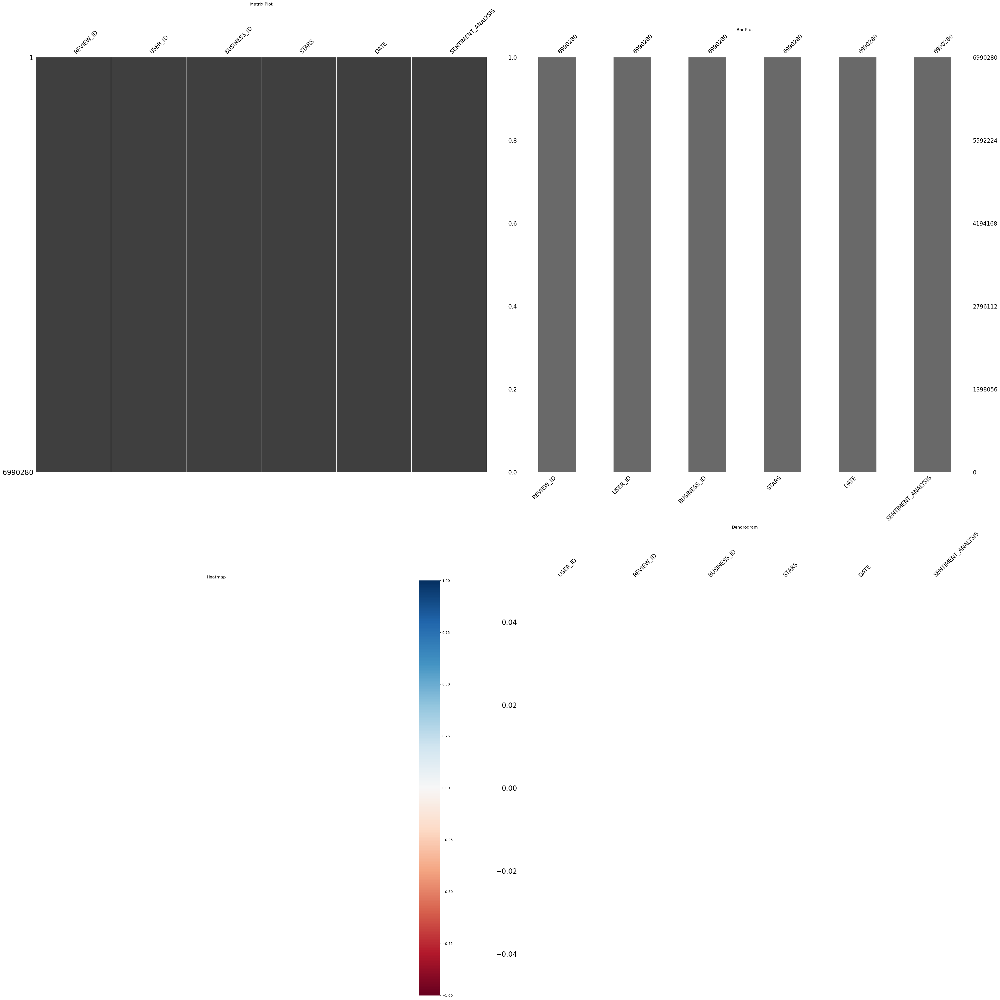

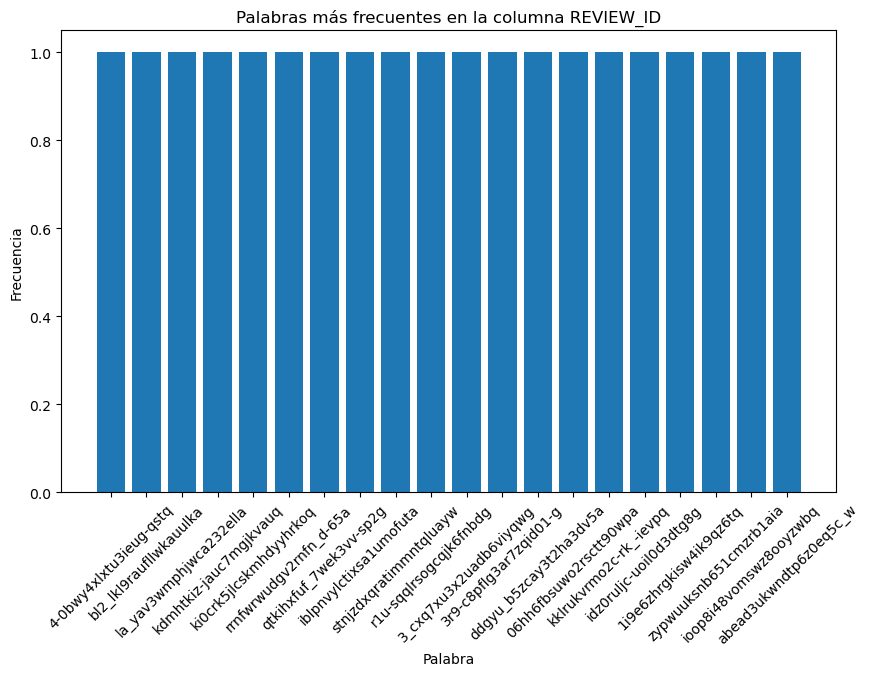

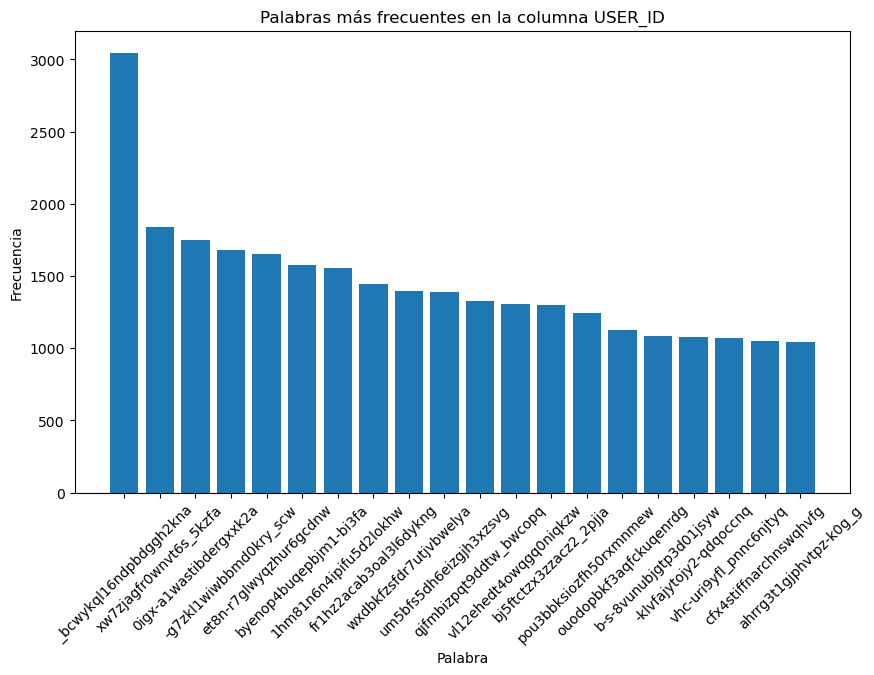

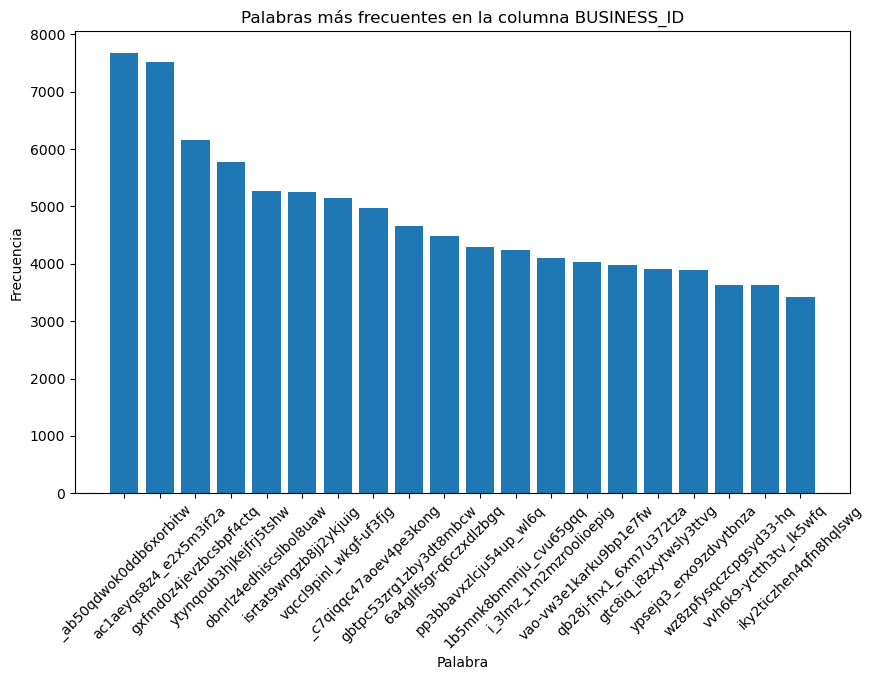

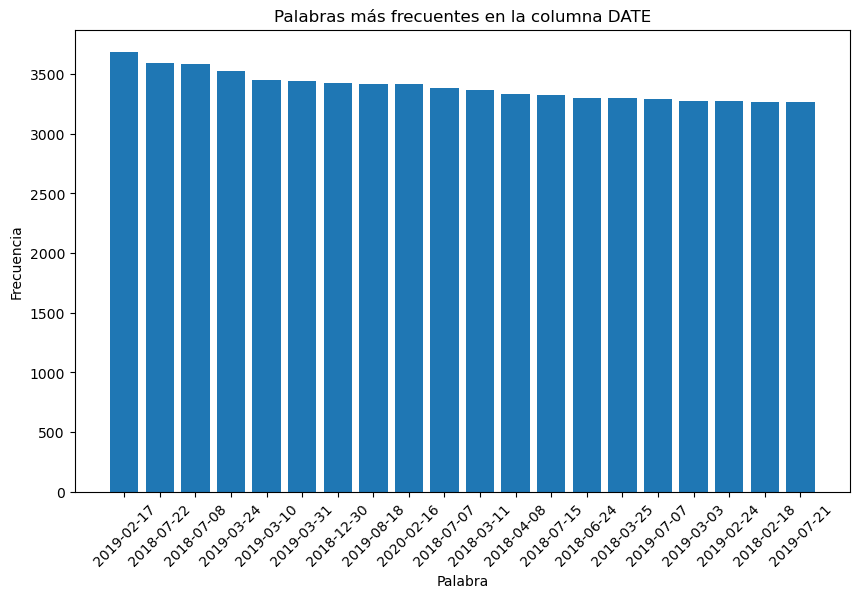

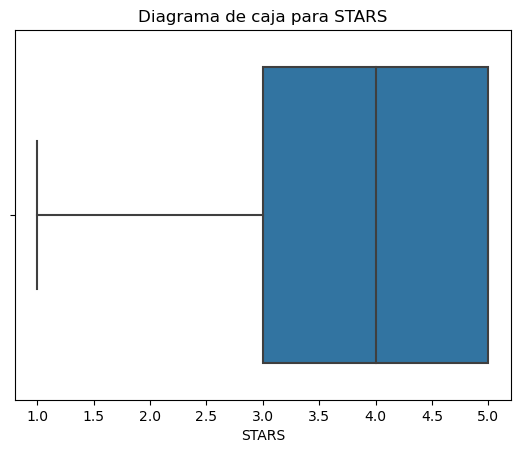

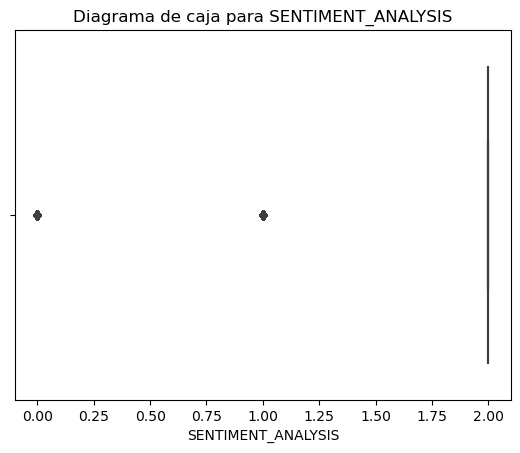

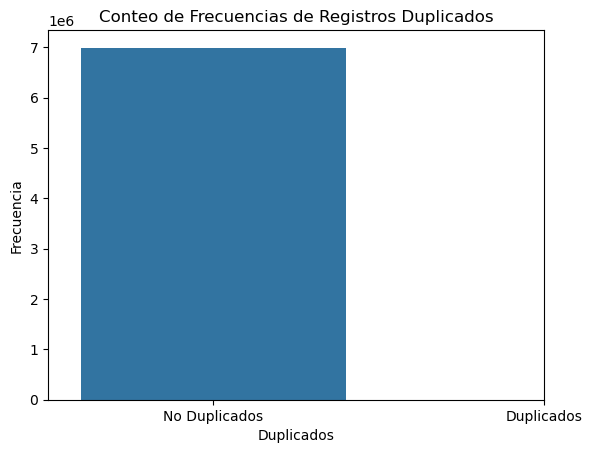

(         nombre_campo       tipo_datos  no_nulos_%  nulos_%  nulos
 0           REVIEW_ID  [<class 'str'>]       100.0      0.0      0
 1             USER_ID  [<class 'str'>]       100.0      0.0      0
 2         BUSINESS_ID  [<class 'str'>]       100.0      0.0      0
 3               STARS  [<class 'int'>]       100.0      0.0      0
 4                DATE  [<class 'str'>]       100.0      0.0      0
 5  SENTIMENT_ANALYSIS  [<class 'int'>]       100.0      0.0      0,
 '~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~oo~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~',
 [None, None, None, None, None, None])

In [39]:
informe_general(df_REVIEW)

### <h2 align= 'center'><u>Análisis descriptivo</u></h2>

StatementMeta(, 76ae3ccc-0ff3-43ab-b08b-381e5e4bde92, 42, Finished, Available)

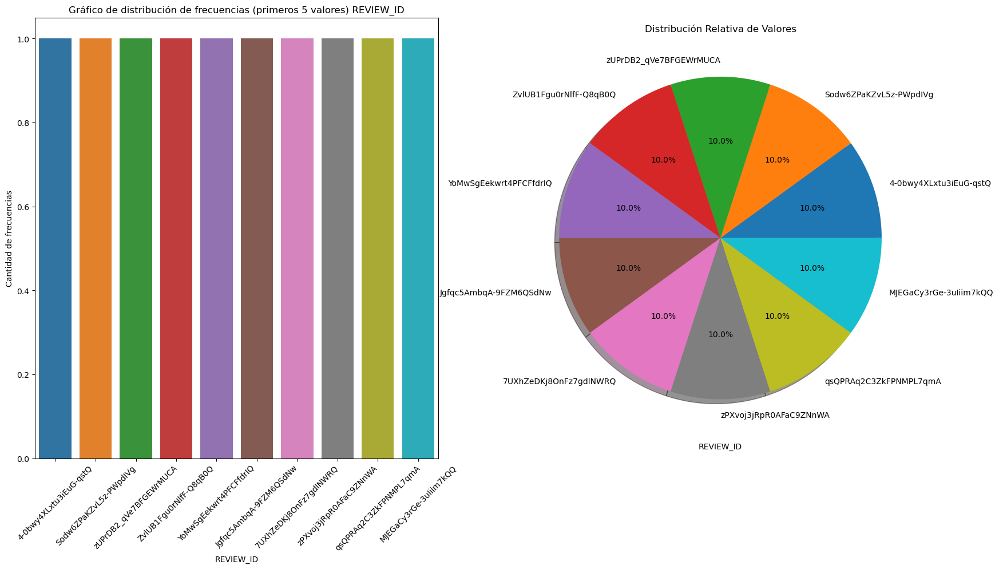



Estadísticas Básicas


count                    6990280
unique                   6990280
top       4-0bwy4XLxtu3iEuG-qstQ
freq                           1
Name: REVIEW_ID, dtype: object
----------------------------------------------------------------------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------------------------------------------------------------------




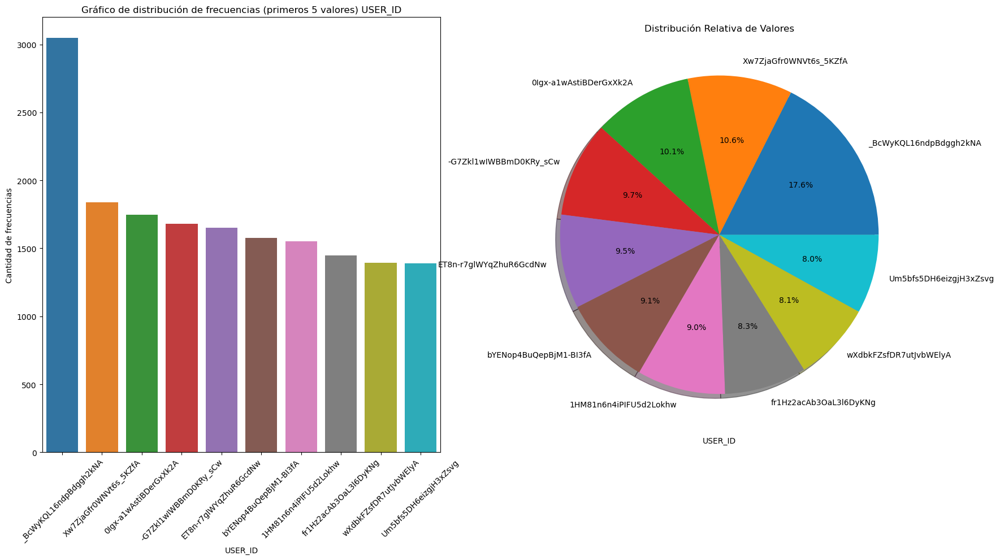



Estadísticas Básicas


count                    6990280
unique                   1987929
top       _BcWyKQL16ndpBdggh2kNA
freq                        3048
Name: USER_ID, dtype: object
----------------------------------------------------------------------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------------------------------------------------------------------




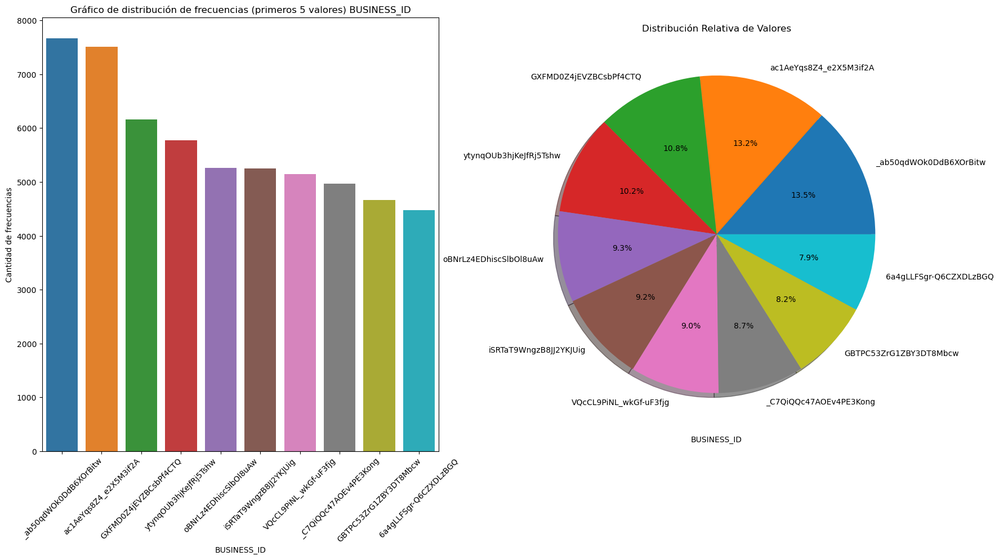



Estadísticas Básicas


count                    6990280
unique                    150346
top       _ab50qdWOk0DdB6XOrBitw
freq                        7673
Name: BUSINESS_ID, dtype: object
----------------------------------------------------------------------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------------------------------------------------------------------




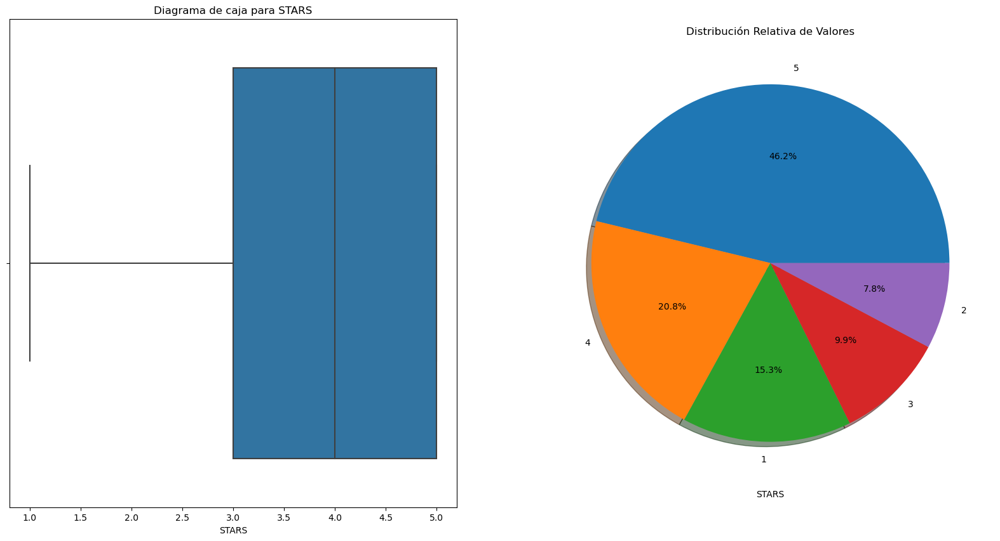



Estadísticas Básicas


count    6.990280e+06
mean     3.748584e+00
std      1.478705e+00
min      1.000000e+00
25%      3.000000e+00
50%      4.000000e+00
75%      5.000000e+00
max      5.000000e+00
Name: STARS, dtype: float64
----------------------------------------------------------------------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------------------------------------------------------------------




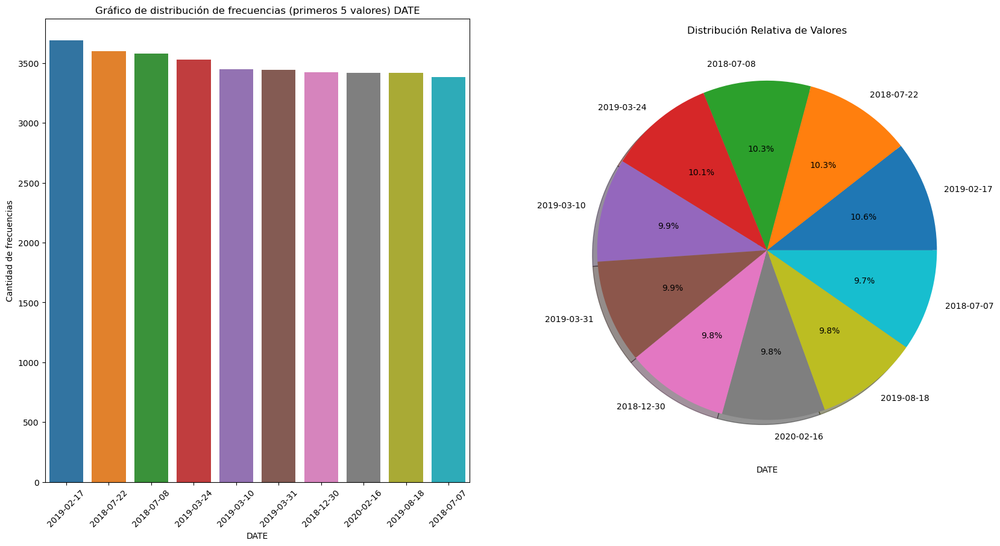



Estadísticas Básicas


count        6990280
unique          6036
top       2019-02-17
freq            3688
Name: DATE, dtype: object
----------------------------------------------------------------------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------------------------------------------------------------------




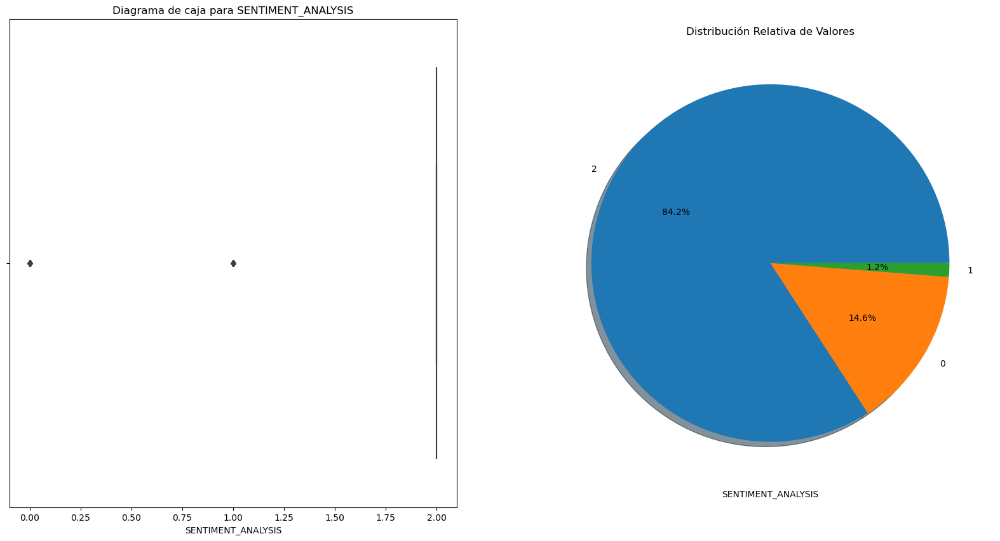



Estadísticas Básicas


count    6.990280e+06
mean     1.695579e+00
std      7.097059e-01
min      0.000000e+00
25%      2.000000e+00
50%      2.000000e+00
75%      2.000000e+00
max      2.000000e+00
Name: SENTIMENT_ANALYSIS, dtype: float64
----------------------------------------------------------------------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------------------------------------------------------------------




In [41]:
descripcion_distribucion(df_REVIEW)

## _User._

### <h2 align= 'center'><u>Análisis general</u></h3>

StatementMeta(, 76ae3ccc-0ff3-43ab-b08b-381e5e4bde92, 43, Finished, Available)

INFORME PRELIMINAR SOBRE CARACTERISTICAS DEL DATASET:

--Dimensiones del DataFrame--
Filas: 1987897
Columnas: 3

--Numero de datos--
5963653

--Filas y Columnas--
Filas: muestra de indices-------> [0, 1, 2, 3, 4]  -----> Desde 0  Hasta 1987896
Columnas: ['USER_ID', 'NAME', 'REVIEW_COUNT']

--Tipo de columnas--
USER_ID         object
NAME            object
REVIEW_COUNT     int64
dtype: object

--Cantidad de registros duplicados--
0

INFORME PRELIMINAR SOBRE LA COLUMNA/FEATURE USER_ID:

--Numero de datos nulos--
0

--Cantidad de valores unicos en la columna--
1987897

--Valores unicos en la columna (Primeros 5 valores)--
['J73HwzBLqcCO78WVfvFFgg' 'HgtQ8BFlMGunOv__6Ua2RQ'
 '8M4_nA8e9VacrirvCwrl8Q' '_DiBPuZ3FmV08WggMuND9w'
 'X9hvz6jIMOLp3T9AdoJVjA']

--Moda de la columna especificada--
Valor modal -----> J73HwzBLqcCO78WVfvFFgg
Frecuencia acumulada ------> 1

--Distribucion de frecuencias (primeros valores con mayor cantidad de frecuencias)--
 USER_ID
J73HwzBLqcCO78WVfvFFgg    1
exlkWPAVOcu

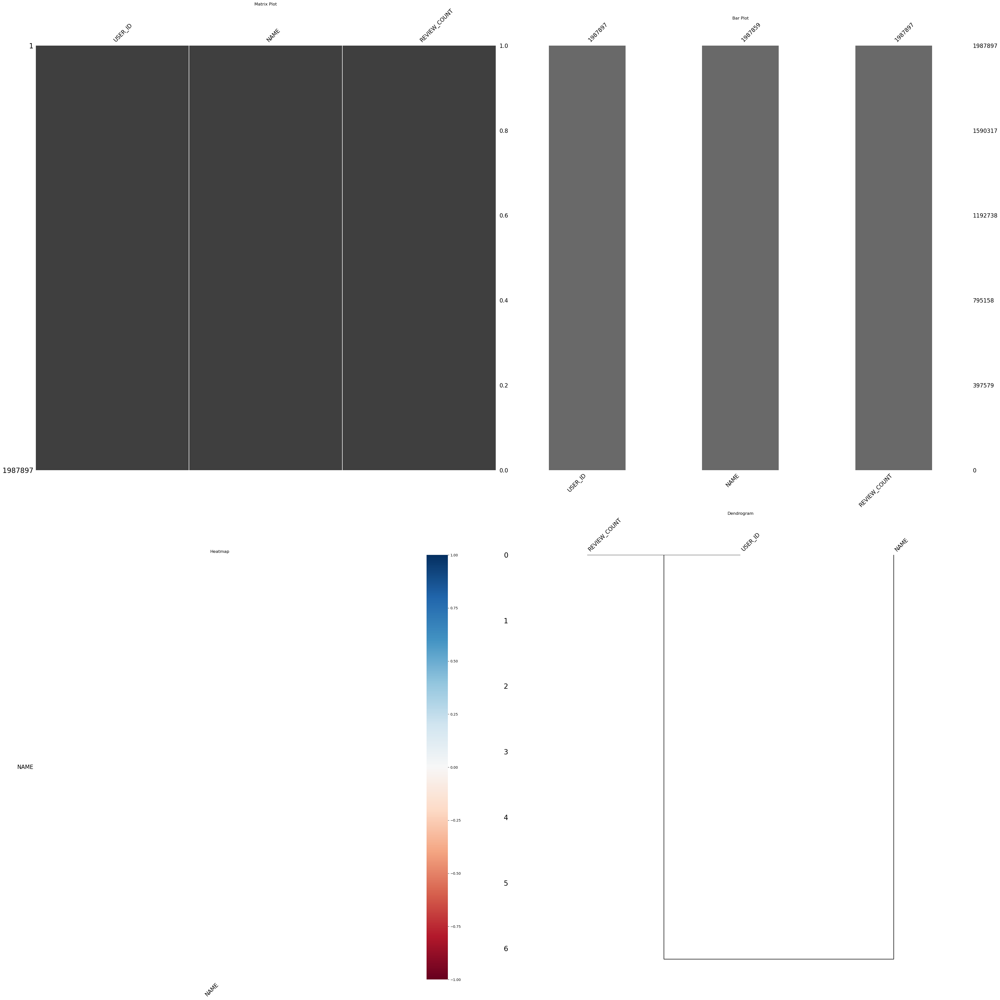

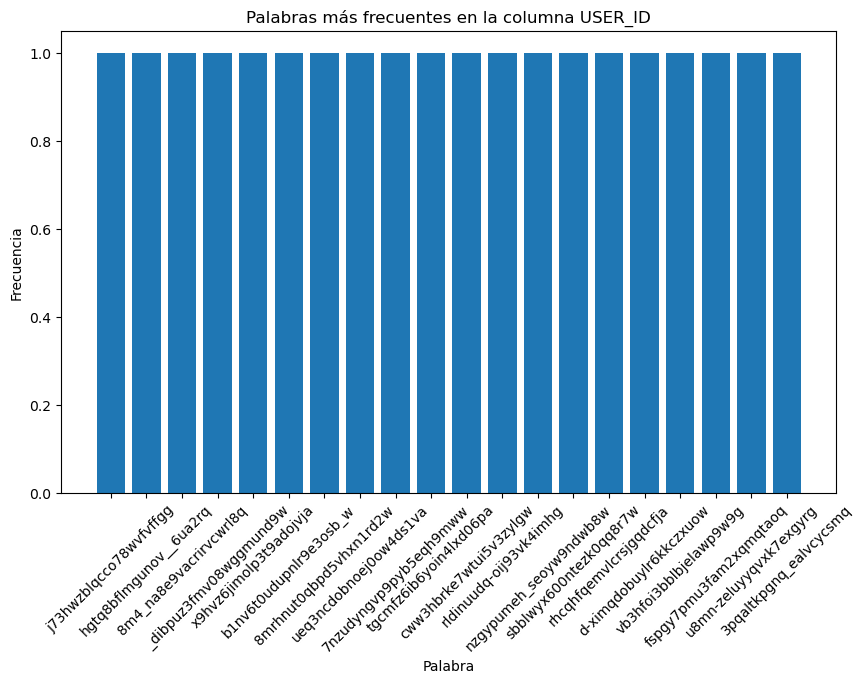

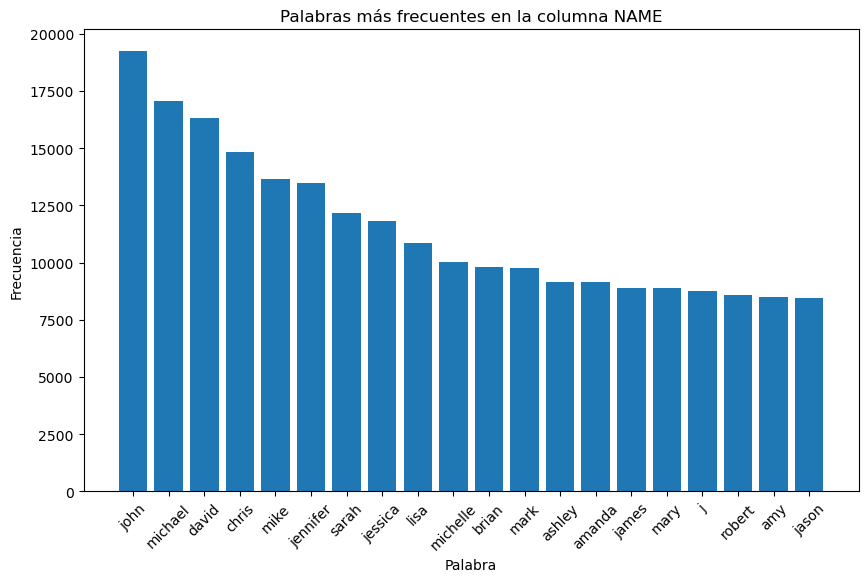

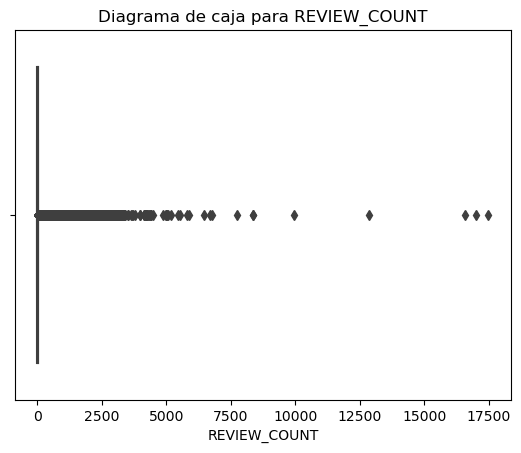

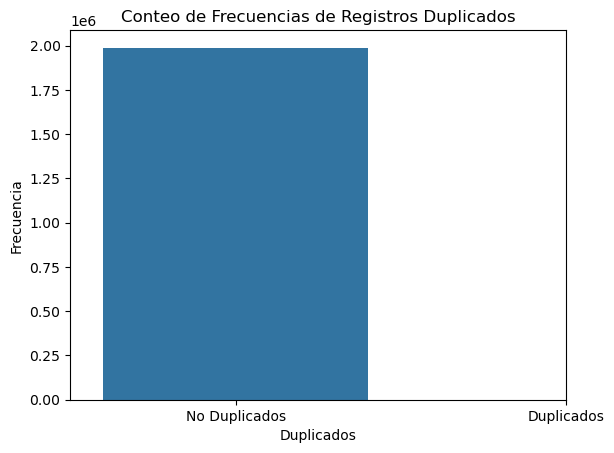

(   nombre_campo                        tipo_datos  no_nulos_%  nulos_%  nulos
 0       USER_ID                   [<class 'str'>]       100.0      0.0      0
 1          NAME  [<class 'str'>, <class 'float'>]       100.0      0.0     38
 2  REVIEW_COUNT                   [<class 'int'>]       100.0      0.0      0,
 '~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~oo~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~',
 [None, None, None])

In [42]:
informe_general(df_USER)

### <h2 align= 'center'><u>Análisis descriptivo</u></h2>

StatementMeta(, 76ae3ccc-0ff3-43ab-b08b-381e5e4bde92, 44, Finished, Available)

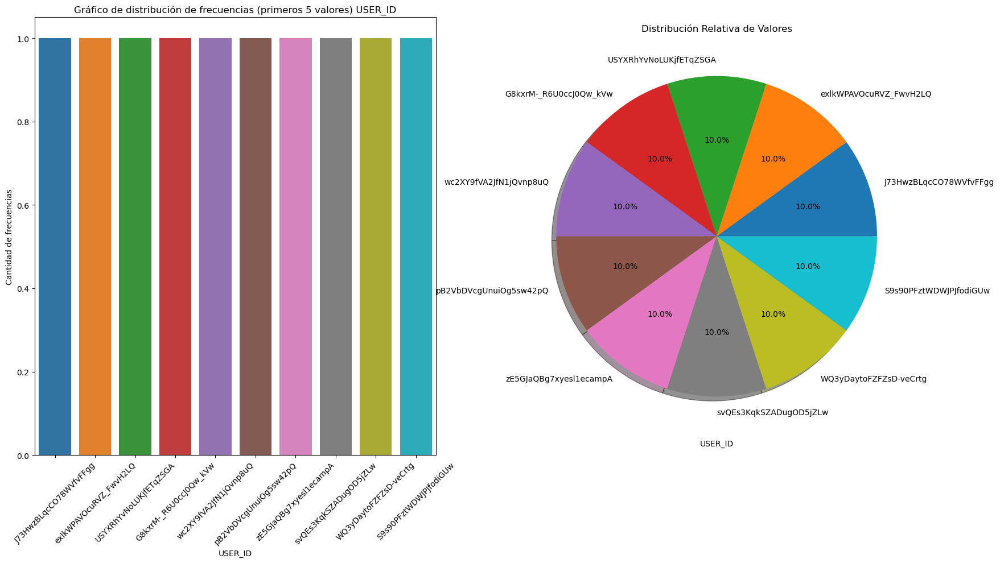



Estadísticas Básicas


count                    1987897
unique                   1987897
top       J73HwzBLqcCO78WVfvFFgg
freq                           1
Name: USER_ID, dtype: object
----------------------------------------------------------------------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------------------------------------------------------------------




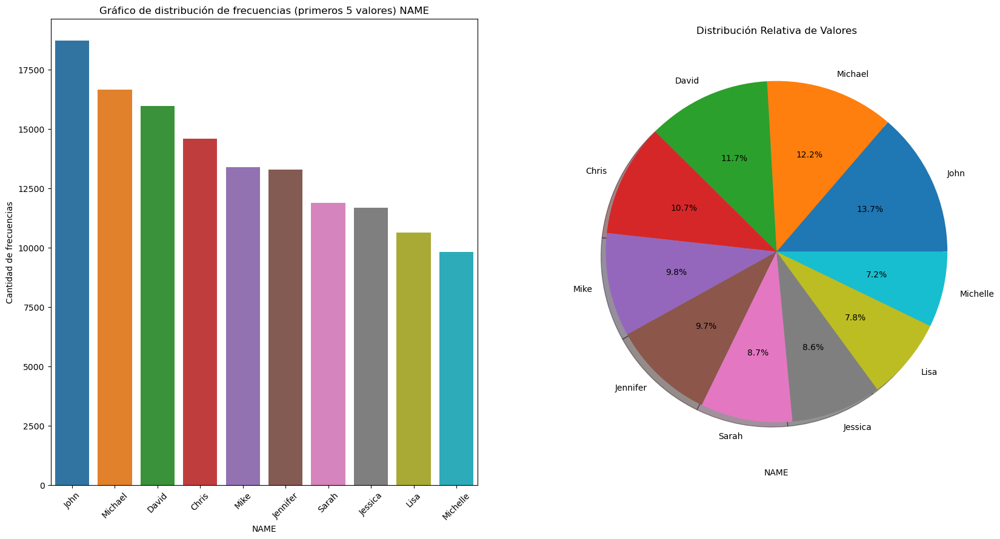



Estadísticas Básicas


count     1987897
unique     132355
top          John
freq        18719
Name: NAME, dtype: object
----------------------------------------------------------------------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------------------------------------------------------------------




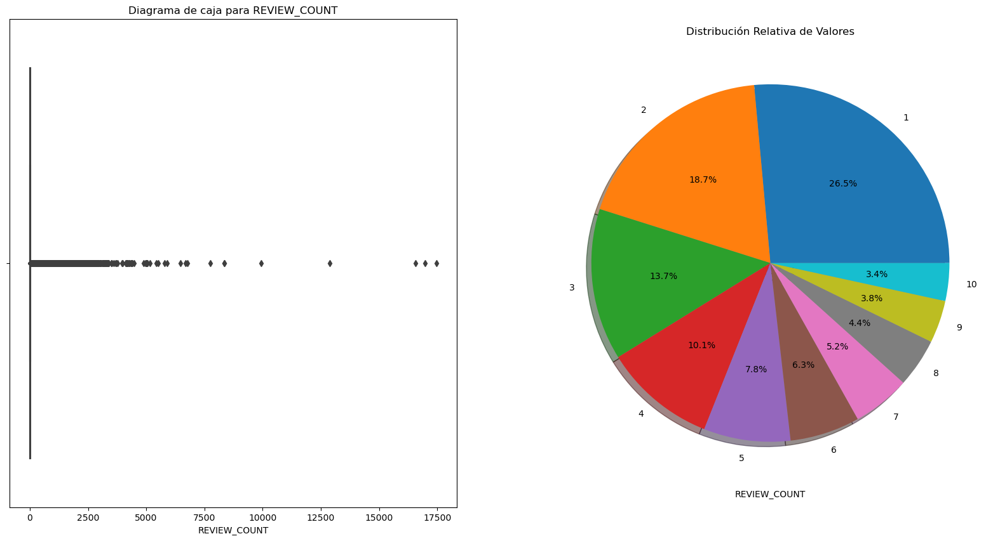



Estadísticas Básicas


count    1.987897e+06
mean     2.339441e+01
std      8.256699e+01
min      0.000000e+00
25%      2.000000e+00
50%      5.000000e+00
75%      1.700000e+01
max      1.747300e+04
Name: REVIEW_COUNT, dtype: float64
----------------------------------------------------------------------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------------------------------------------------------------------




In [43]:
descripcion_distribucion(df_USER)

## _Tip._

### <h2 align= 'center'><u>Análisis general</u></h3>

StatementMeta(, 76ae3ccc-0ff3-43ab-b08b-381e5e4bde92, 45, Finished, Available)

INFORME PRELIMINAR SOBRE CARACTERISTICAS DEL DATASET:

--Dimensiones del DataFrame--
Filas: 908195
Columnas: 4

--Numero de datos--
3632780

--Filas y Columnas--
Filas: muestra de indices-------> [0, 1, 2, 3, 4]  -----> Desde 0  Hasta 908194
Columnas: ['USER_ID', 'BUSINESS_ID', 'DATE', 'SENTIMENT_ANALYSIS']

--Tipo de columnas--
USER_ID               object
BUSINESS_ID           object
DATE                  object
SENTIMENT_ANALYSIS     int64
dtype: object

--Cantidad de registros duplicados--
10175

INFORME PRELIMINAR SOBRE LA COLUMNA/FEATURE USER_ID:

--Numero de datos nulos--
0

--Cantidad de valores unicos en la columna--
301758

--Valores unicos en la columna (Primeros 5 valores)--
['vhBetZ-AMZpANkgvwh2W2A' 'bF2xmRxR_eyJ-HRs-ClOmw'
 'aZXnHefHQJuAOMpe27R6oQ' 'TE199OBEeJ4gmtRo-2kOfw'
 'KLZSLdjdia0O2vV5RgB8Dg']

--Moda de la columna especificada--
Valor modal -----> fCvMnJU1Z-XhAjKg99wK3Q
Frecuencia acumulada ------> 4055

--Distribucion de frecuencias (primeros valores con mayor can

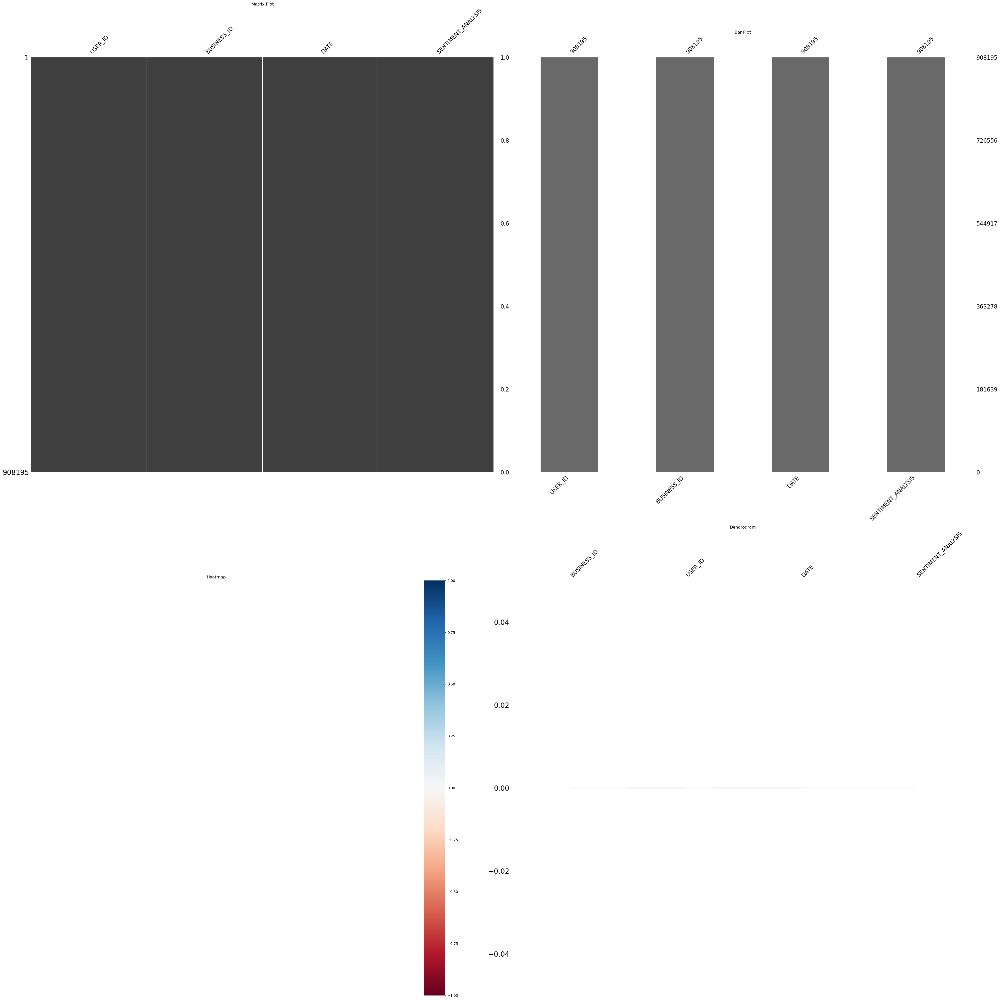

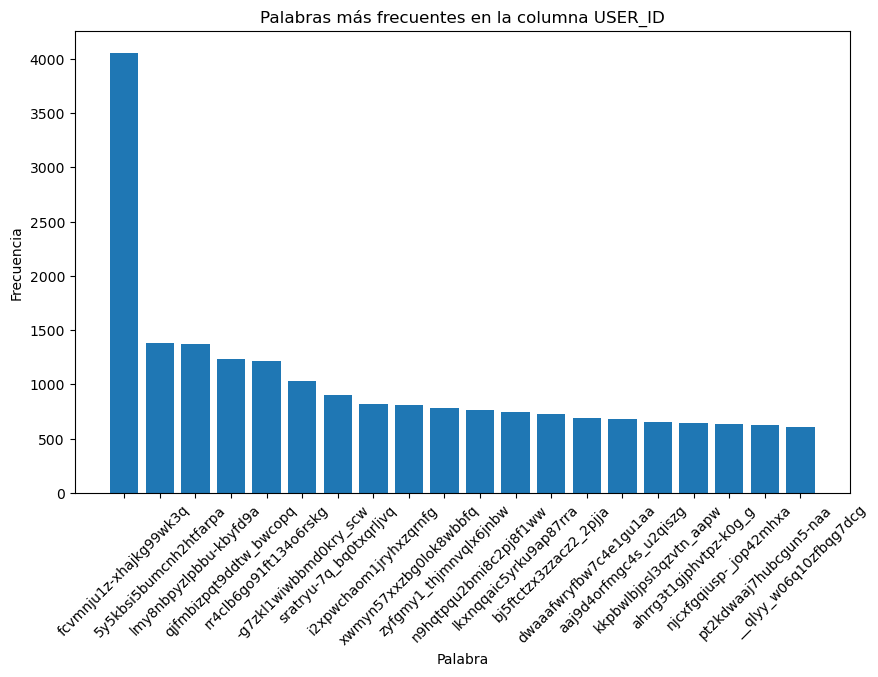

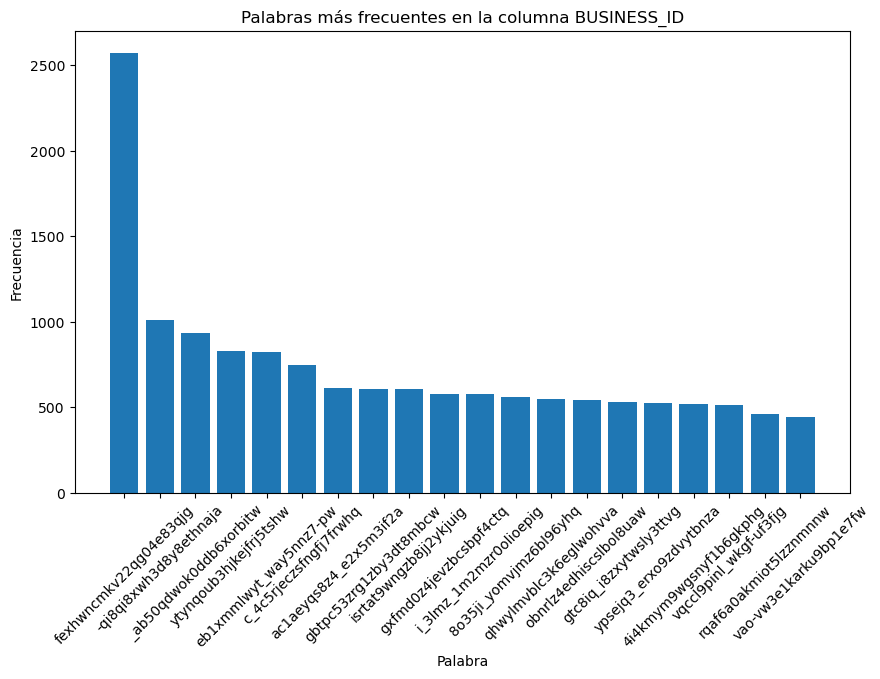

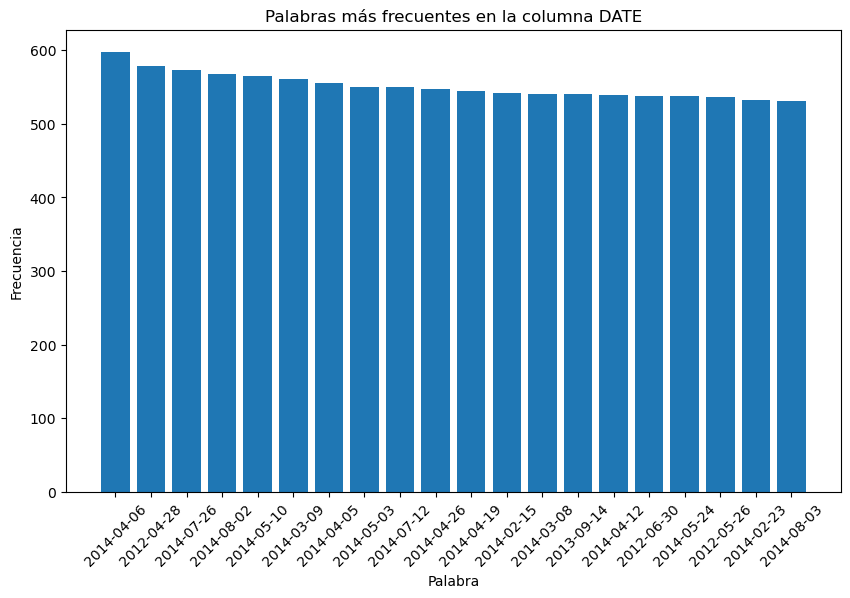

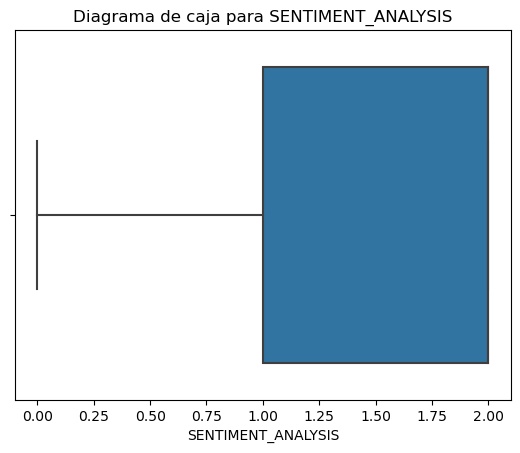

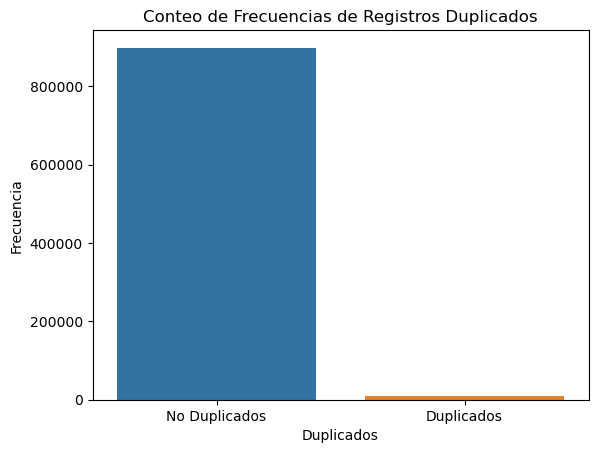

(         nombre_campo       tipo_datos  no_nulos_%  nulos_%  nulos
 0             USER_ID  [<class 'str'>]       100.0      0.0      0
 1         BUSINESS_ID  [<class 'str'>]       100.0      0.0      0
 2                DATE  [<class 'str'>]       100.0      0.0      0
 3  SENTIMENT_ANALYSIS  [<class 'int'>]       100.0      0.0      0,
 '~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~oo~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~',
 [None, None, None, None])

In [44]:
informe_general(df_TIP)

### <h2 align= 'center'><u>Análisis descriptivo</u></h2>

StatementMeta(, 76ae3ccc-0ff3-43ab-b08b-381e5e4bde92, 46, Finished, Available)

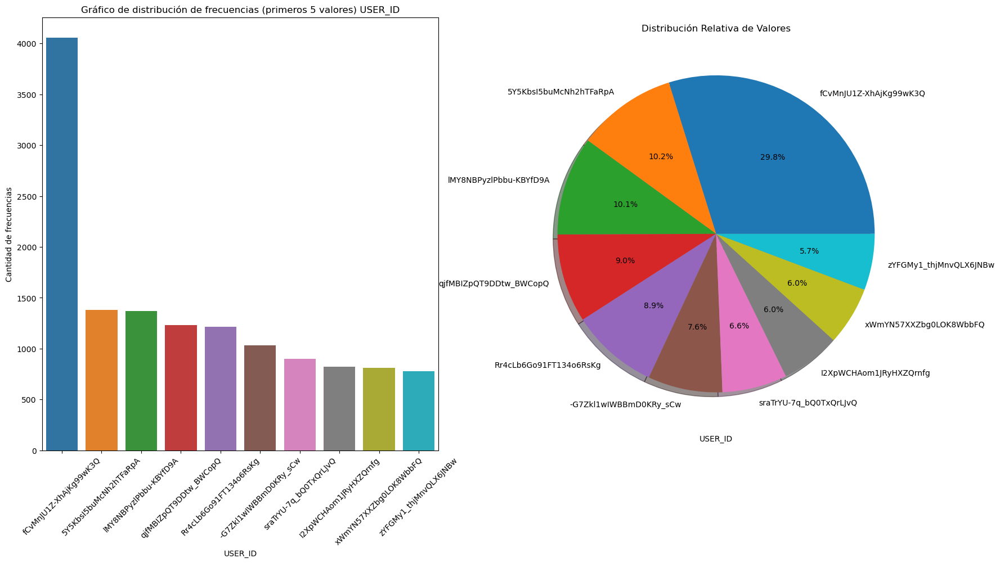



Estadísticas Básicas


count                     908195
unique                    301758
top       fCvMnJU1Z-XhAjKg99wK3Q
freq                        4055
Name: USER_ID, dtype: object
----------------------------------------------------------------------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------------------------------------------------------------------




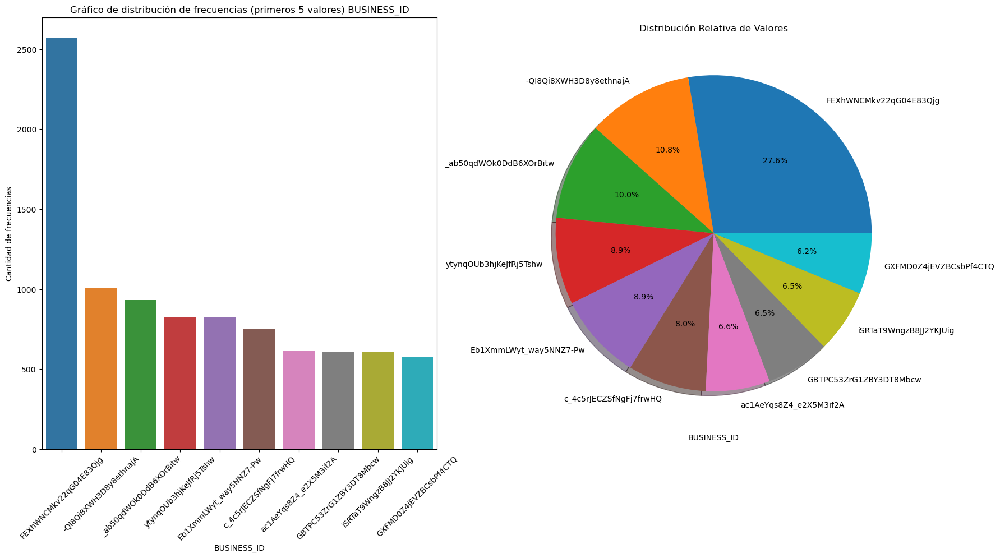



Estadísticas Básicas


count                     908195
unique                    106193
top       FEXhWNCMkv22qG04E83Qjg
freq                        2571
Name: BUSINESS_ID, dtype: object
----------------------------------------------------------------------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------------------------------------------------------------------




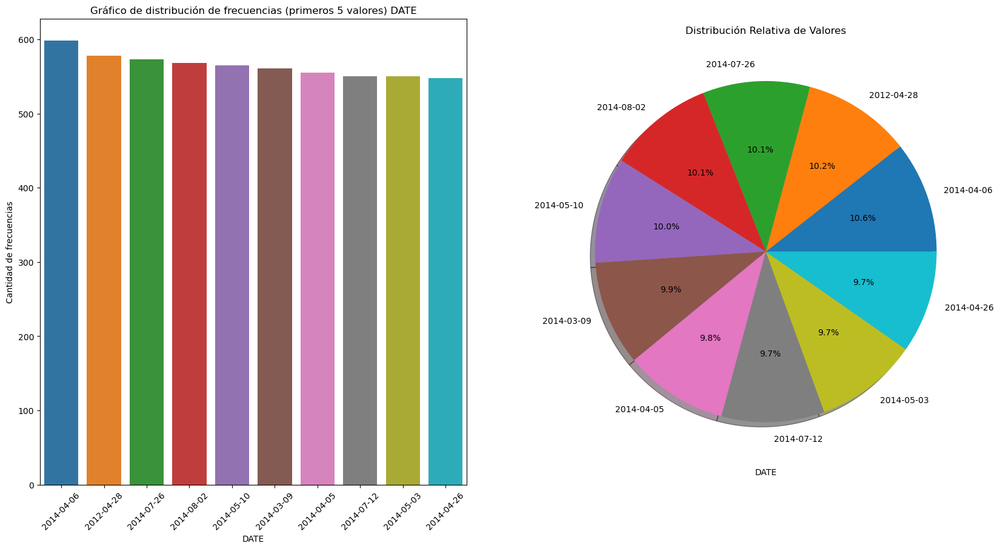



Estadísticas Básicas


count         908195
unique          4626
top       2014-04-06
freq             598
Name: DATE, dtype: object
----------------------------------------------------------------------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------------------------------------------------------------------




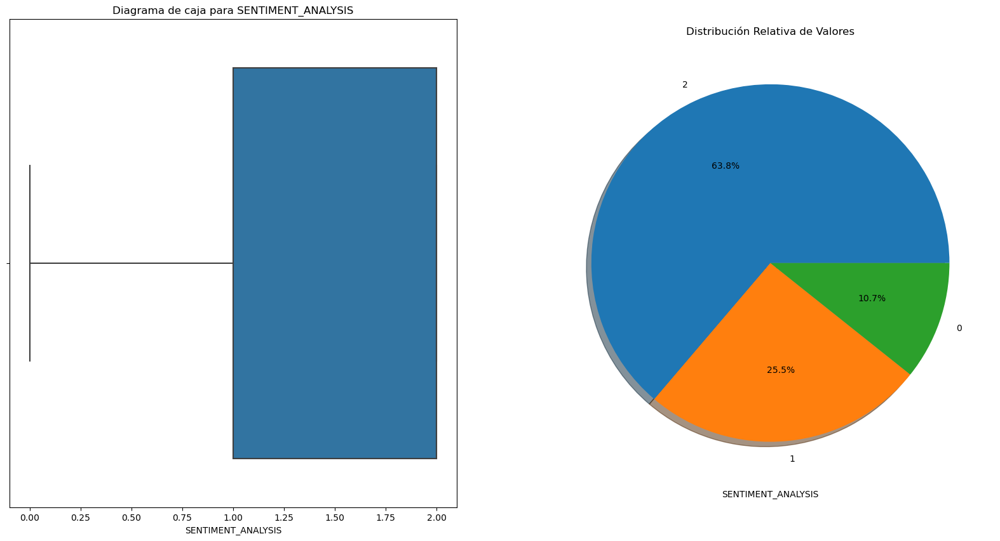



Estadísticas Básicas


count    908195.000000
mean          1.530523
std           0.680832
min           0.000000
25%           1.000000
50%           2.000000
75%           2.000000
max           2.000000
Name: SENTIMENT_ANALYSIS, dtype: float64
----------------------------------------------------------------------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------------------------------------------------------------------




In [45]:
descripcion_distribucion(df_tip)

## _Bussines._

### <h2 align= 'center'><u>Análisis general</u></h3>

StatementMeta(, 76ae3ccc-0ff3-43ab-b08b-381e5e4bde92, 47, Finished, Available)

INFORME PRELIMINAR SOBRE CARACTERISTICAS DEL DATASET:

--Dimensiones del DataFrame--
Filas: 150167
Columnas: 10

--Numero de datos--
1501670

--Filas y Columnas--
Filas: muestra de indices-------> [0, 1, 2, 3, 4]  -----> Desde 0  Hasta 150166
Columnas: ['BUSINESS_ID', 'NAME', 'CITY', 'STATE', 'LATITUDE', 'LONGITUDE', 'STARS', 'REVIEW_COUNT', 'CATEGORIES', 'CATEGORIEPERS']

--Tipo de columnas--
BUSINESS_ID       object
NAME              object
CITY              object
STATE             object
LATITUDE         float64
LONGITUDE        float64
STARS            float64
REVIEW_COUNT       int64
CATEGORIES        object
CATEGORIEPERS     object
dtype: object

--Cantidad de registros duplicados--
0

INFORME PRELIMINAR SOBRE LA COLUMNA/FEATURE BUSINESS_ID:

--Numero de datos nulos--
0

--Cantidad de valores unicos en la columna--
150162

--Valores unicos en la columna (Primeros 5 valores)--
['HddE1bPVuTas6hACmHVcUQ' 'XPOdKREKlB8uvsMMKNY_7w'
 'gsG7nNnePxIed34lU7tgLw' 'Xr08bwIBEsaQr83aJKQbNg'
 '

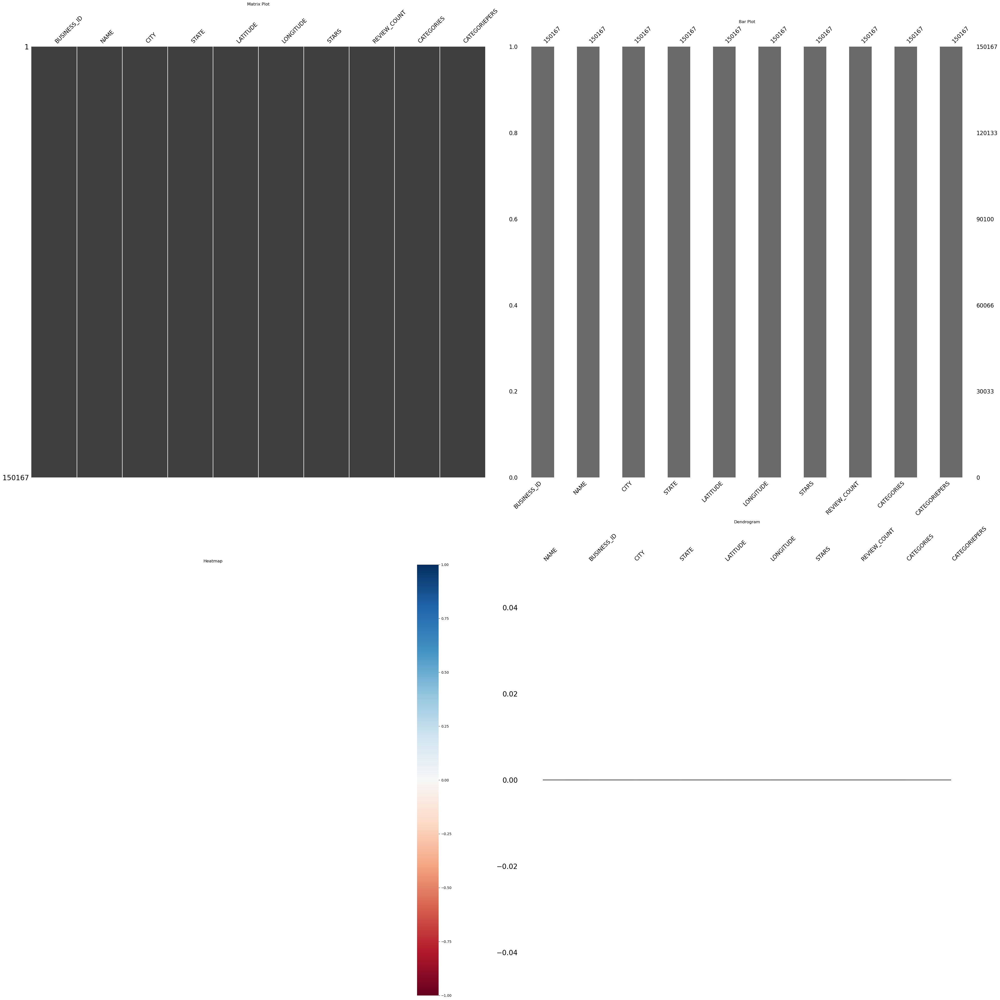

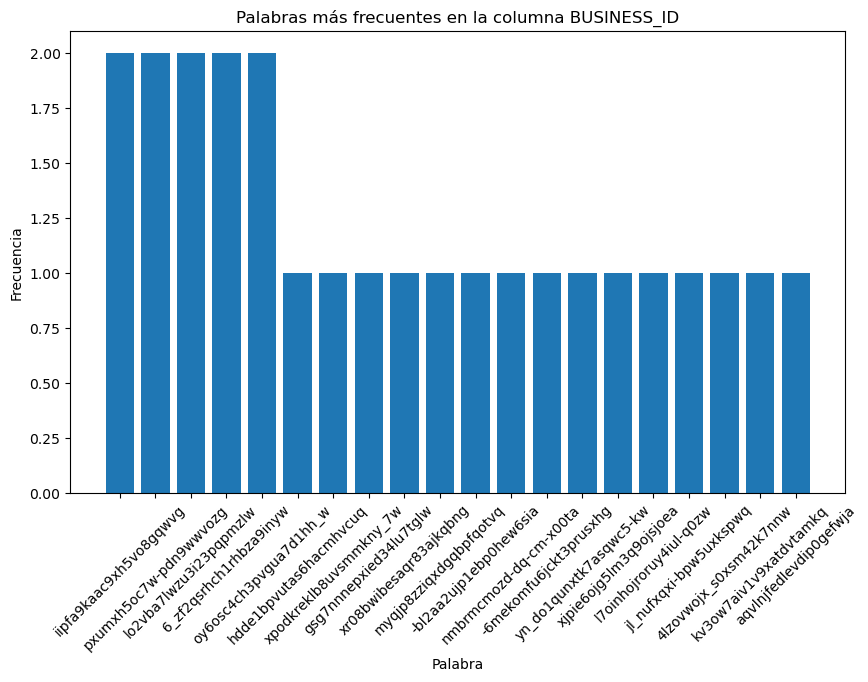

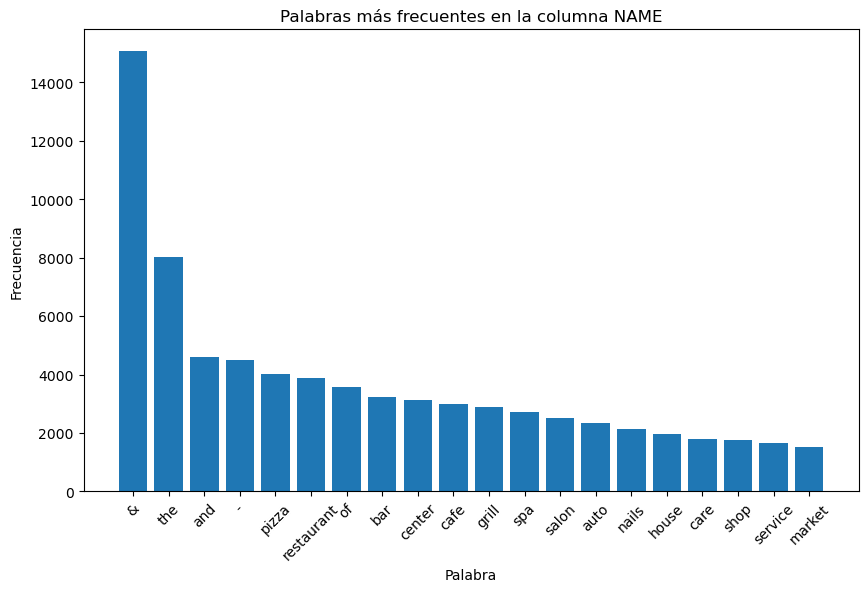

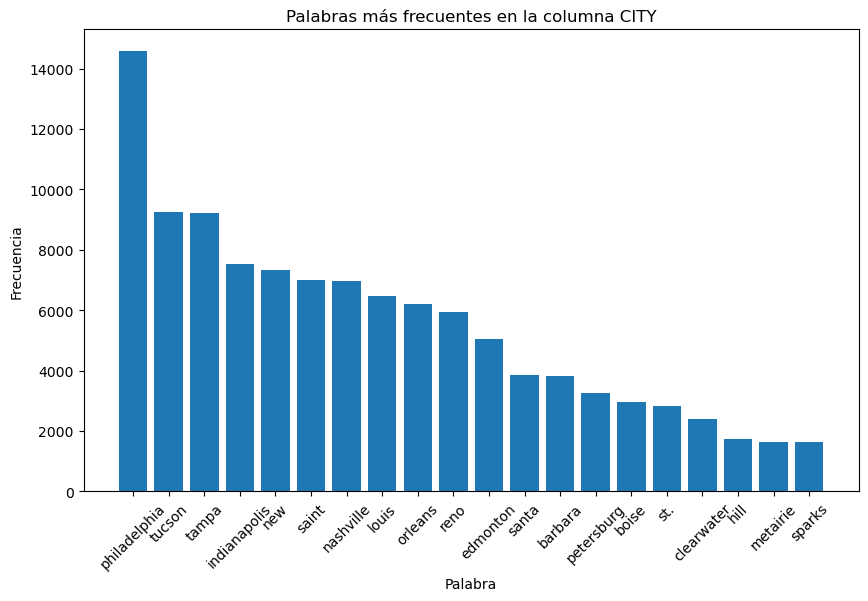

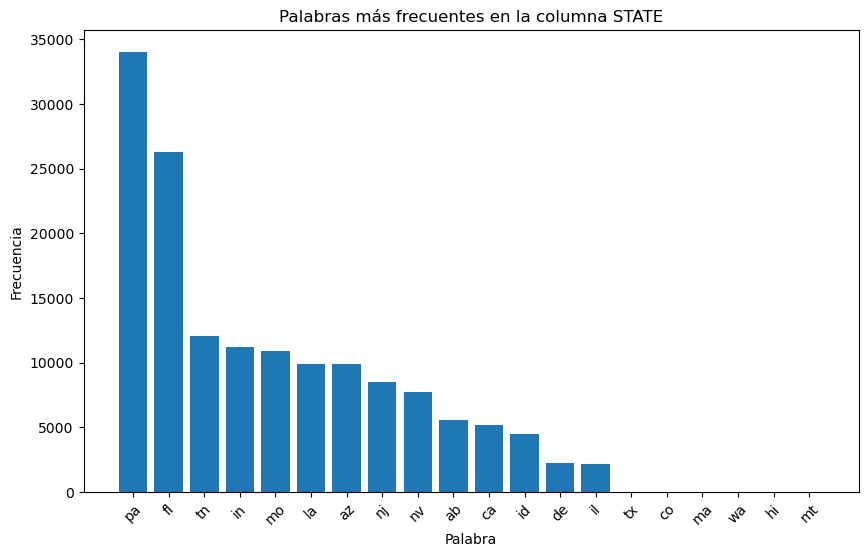

...

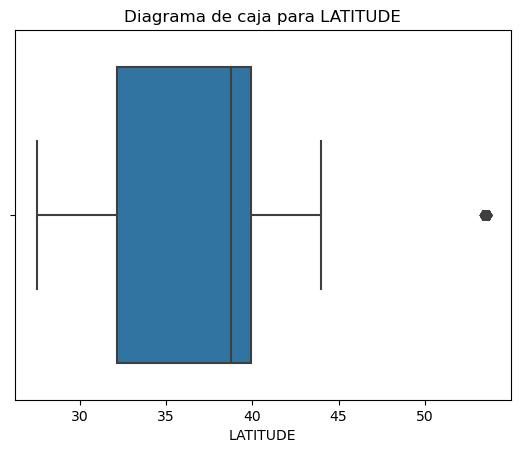

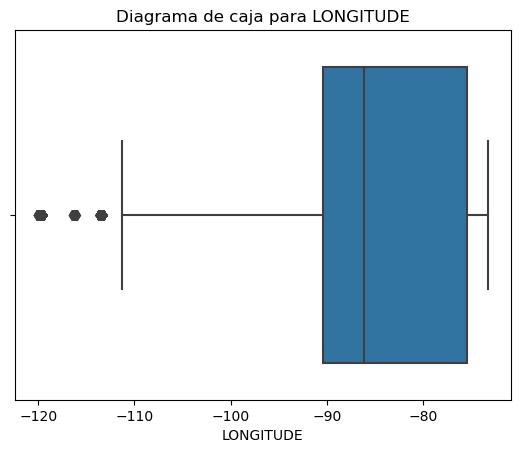

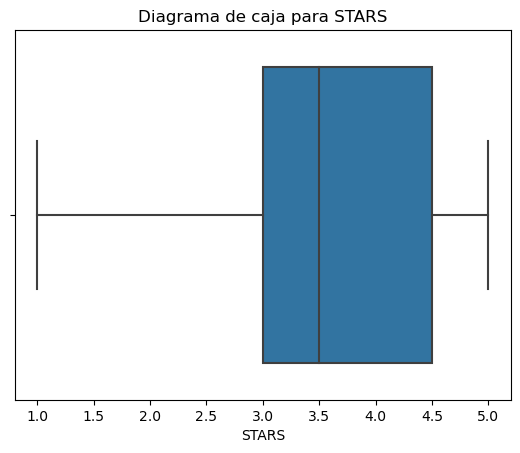

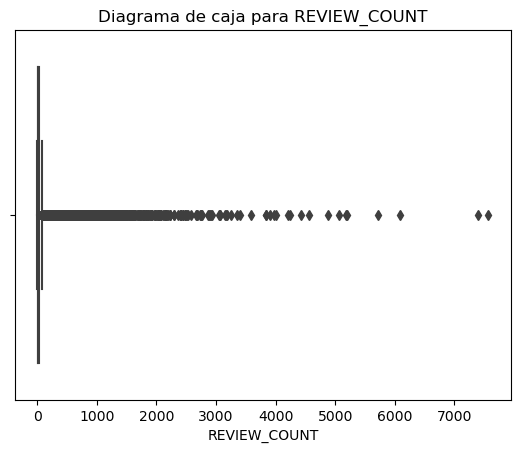

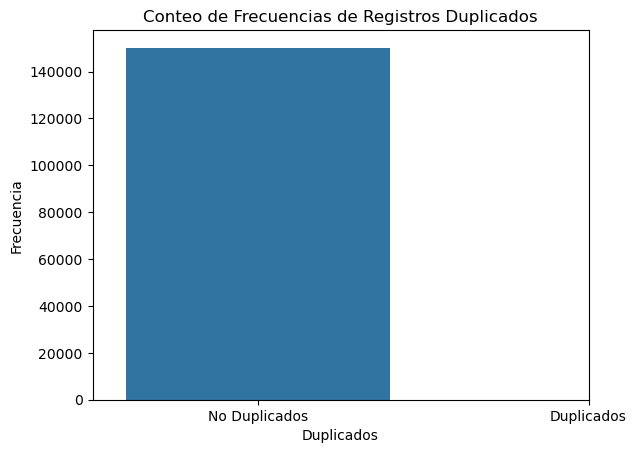

(    nombre_campo         tipo_datos  no_nulos_%  nulos_%  nulos
 0    BUSINESS_ID    [<class 'str'>]       100.0      0.0      0
 1           NAME    [<class 'str'>]       100.0      0.0      0
 2           CITY    [<class 'str'>]       100.0      0.0      0
 3          STATE    [<class 'str'>]       100.0      0.0      0
 4       LATITUDE  [<class 'float'>]       100.0      0.0      0
 5      LONGITUDE  [<class 'float'>]       100.0      0.0      0
 6          STARS  [<class 'float'>]       100.0      0.0      0
 7   REVIEW_COUNT    [<class 'int'>]       100.0      0.0      0
 8     CATEGORIES    [<class 'str'>]       100.0      0.0      0
 9  CATEGORIEPERS    [<class 'str'>]       100.0      0.0      0,
 '~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~oo~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~',
 [None, None, None, None, None, None, None, None, None, None])

In [46]:
informe_general(df_BUSINESS)

### <h2 align= 'center'><u>Análisis descriptivo</u></h2>

StatementMeta(, 76ae3ccc-0ff3-43ab-b08b-381e5e4bde92, 48, Finished, Available)

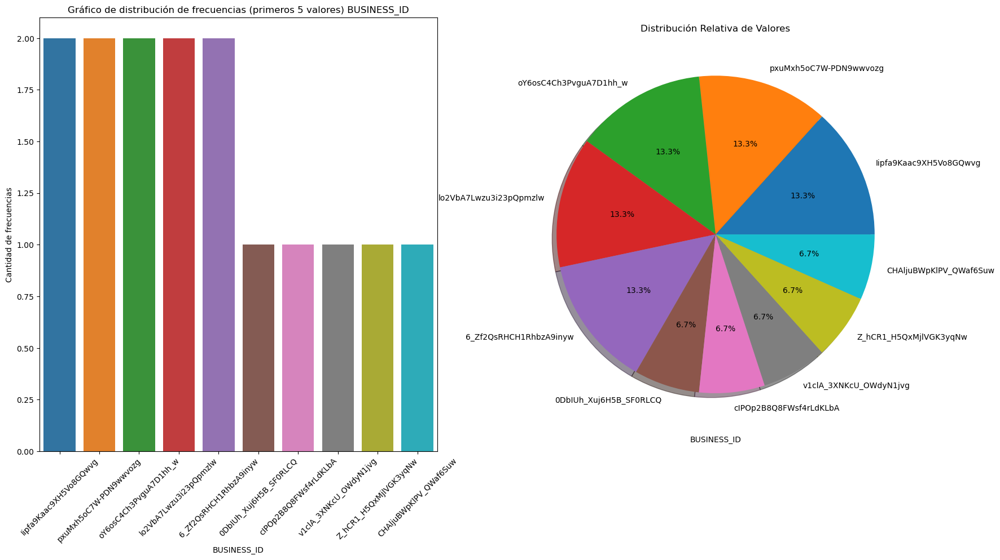



Estadísticas Básicas


count                     150167
unique                    150162
top       Iipfa9Kaac9XH5Vo8GQwvg
freq                           2
Name: BUSINESS_ID, dtype: object
----------------------------------------------------------------------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------------------------------------------------------------------




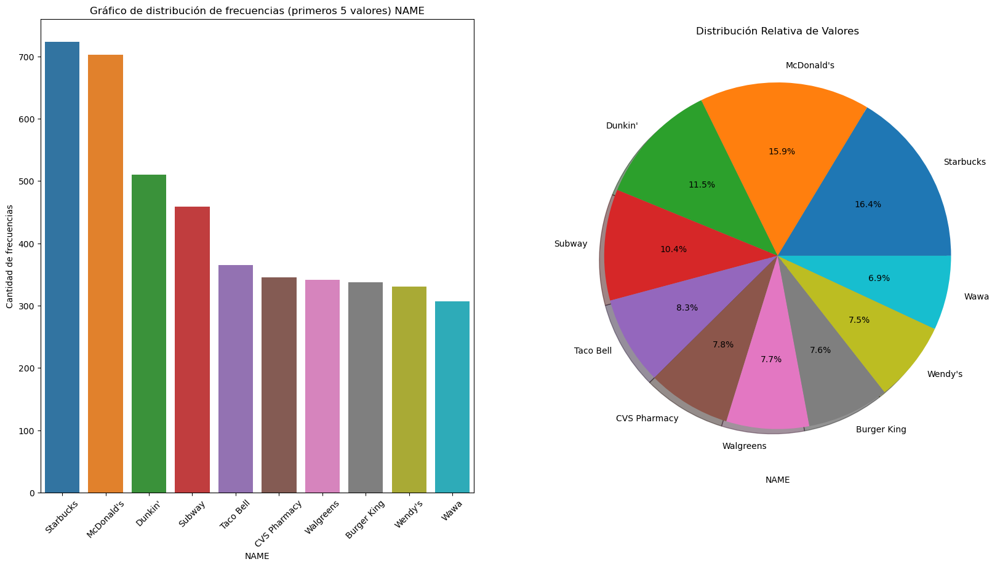



Estadísticas Básicas


count        150167
unique       113949
top       Starbucks
freq            724
Name: NAME, dtype: object
----------------------------------------------------------------------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------------------------------------------------------------------




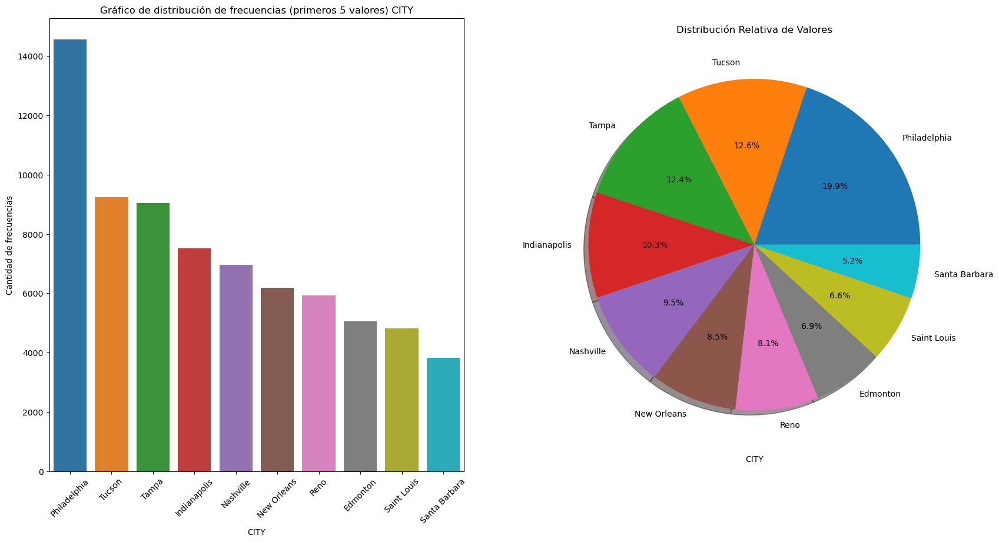



Estadísticas Básicas


count           150167
unique            1413
top       Philadelphia
freq             14551
Name: CITY, dtype: object
----------------------------------------------------------------------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------------------------------------------------------------------




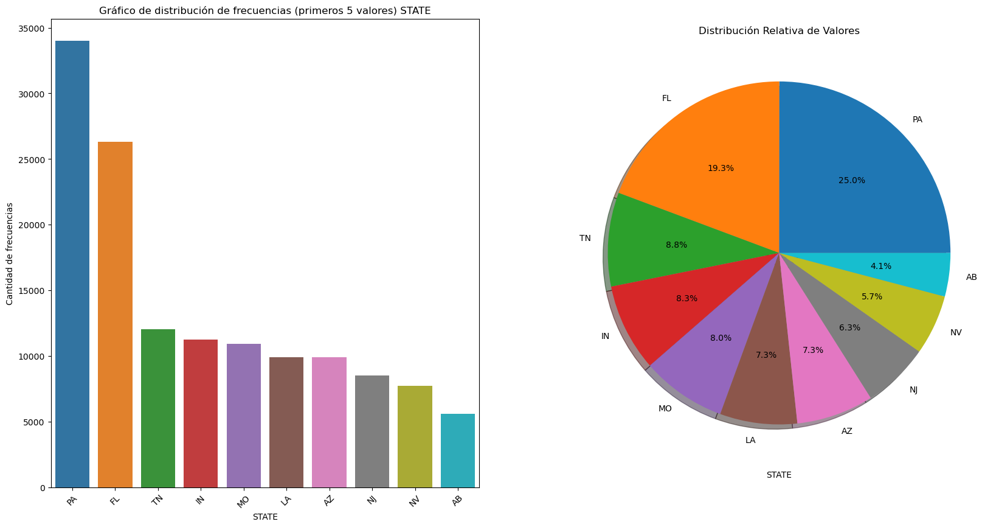



Estadísticas Básicas


count     150167
unique        27
top           PA
freq       33995
Name: STATE, dtype: object
----------------------------------------------------------------------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------------------------------------------------------------------




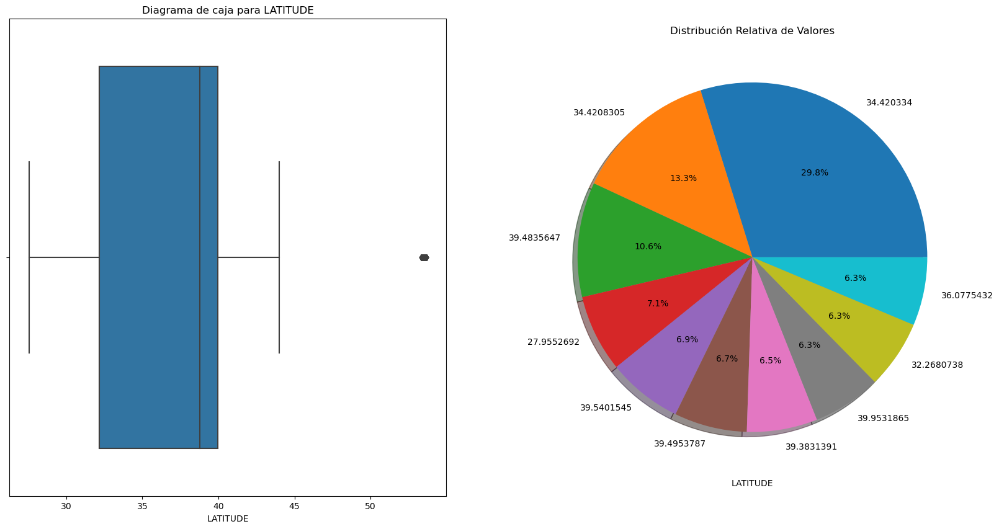



Estadísticas Básicas


count    150167.000000
mean         36.671572
std           5.873349
min          27.555127
25%          32.187790
50%          38.777303
75%          39.954062
max          53.679197
Name: LATITUDE, dtype: float64
----------------------------------------------------------------------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------------------------------------------------------------------




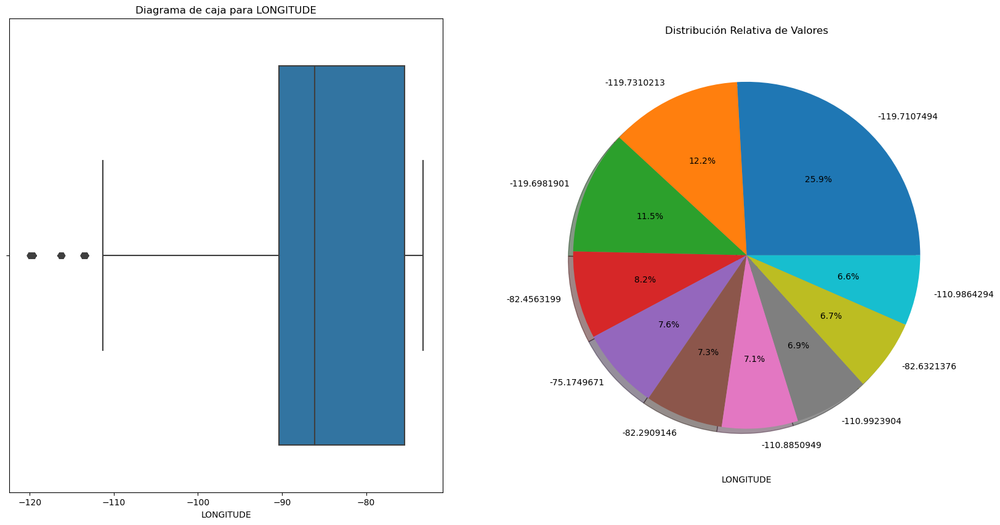



Estadísticas Básicas


count    150167.000000
mean        -89.356851
std          14.918850
min        -120.095137
25%         -90.357826
50%         -86.121065
75%         -75.421271
max         -73.200457
Name: LONGITUDE, dtype: float64
----------------------------------------------------------------------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------------------------------------------------------------------




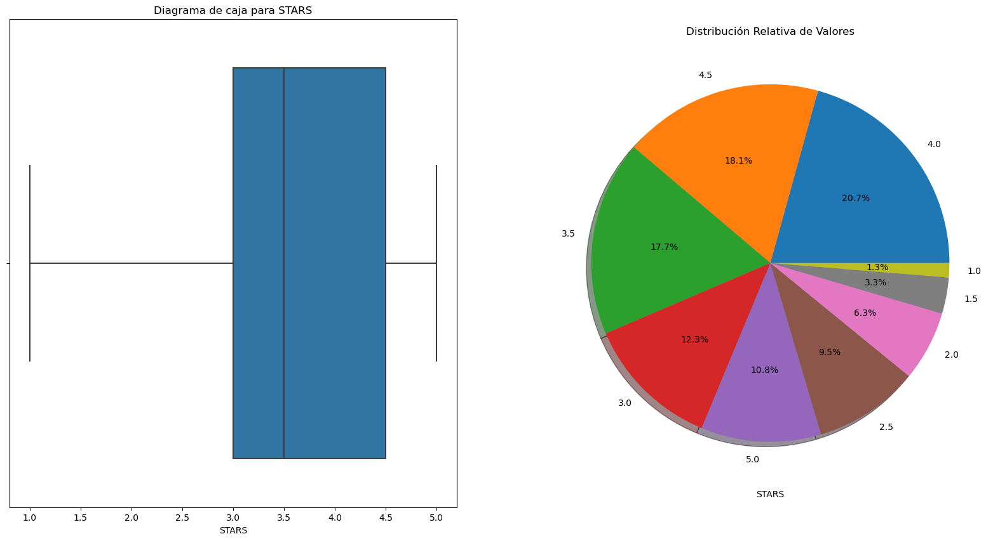



Estadísticas Básicas


count    150167.000000
mean          3.597288
std           0.973412
min           1.000000
25%           3.000000
50%           3.500000
75%           4.500000
max           5.000000
Name: STARS, dtype: float64
----------------------------------------------------------------------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------------------------------------------------------------------




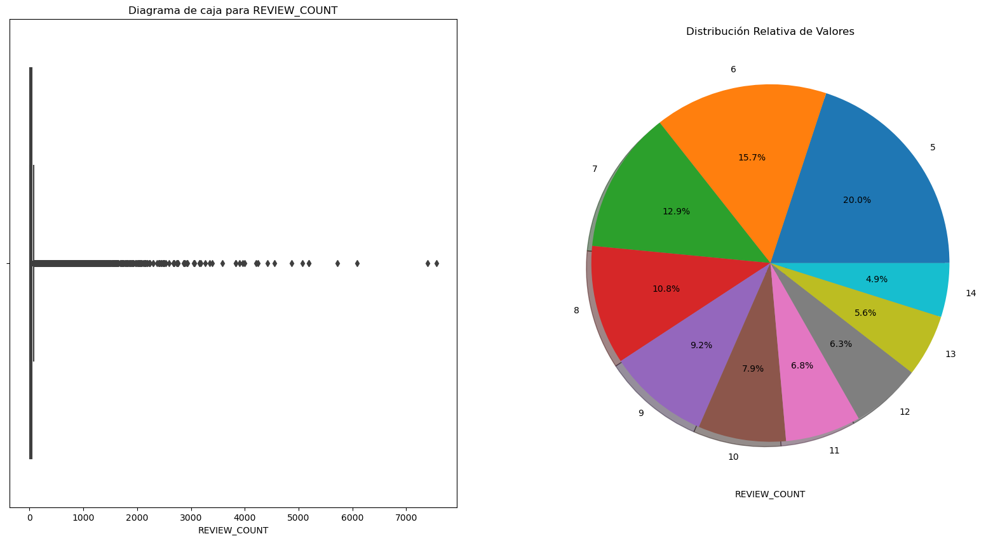



Estadísticas Básicas


count    150167.000000
mean         44.902695
std         121.182132
min           5.000000
25%           8.000000
50%          15.000000
75%          37.000000
max        7568.000000
Name: REVIEW_COUNT, dtype: float64
----------------------------------------------------------------------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------------------------------------------------------------------




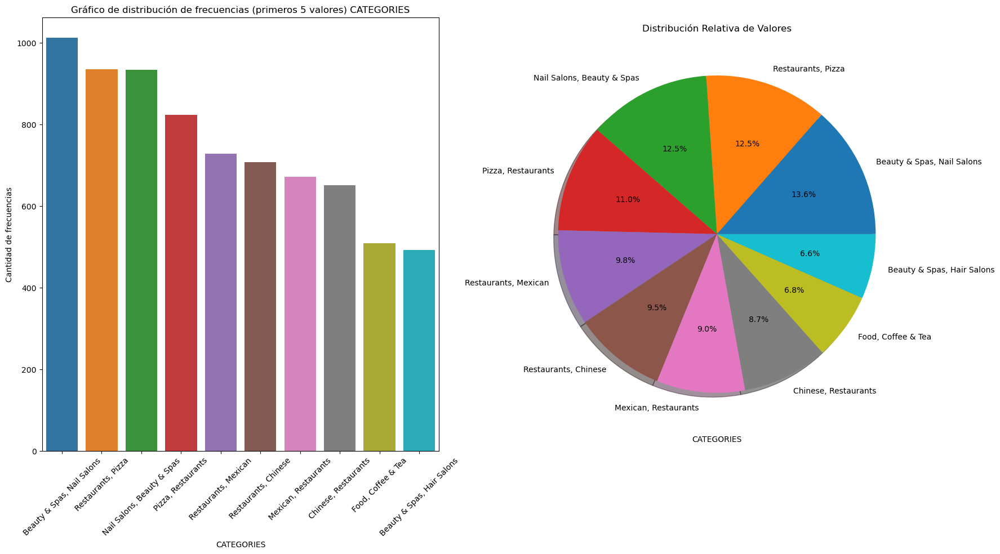



Estadísticas Básicas


count                         150167
unique                         83155
top       Beauty & Spas, Nail Salons
freq                            1012
Name: CATEGORIES, dtype: object
----------------------------------------------------------------------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------------------------------------------------------------------




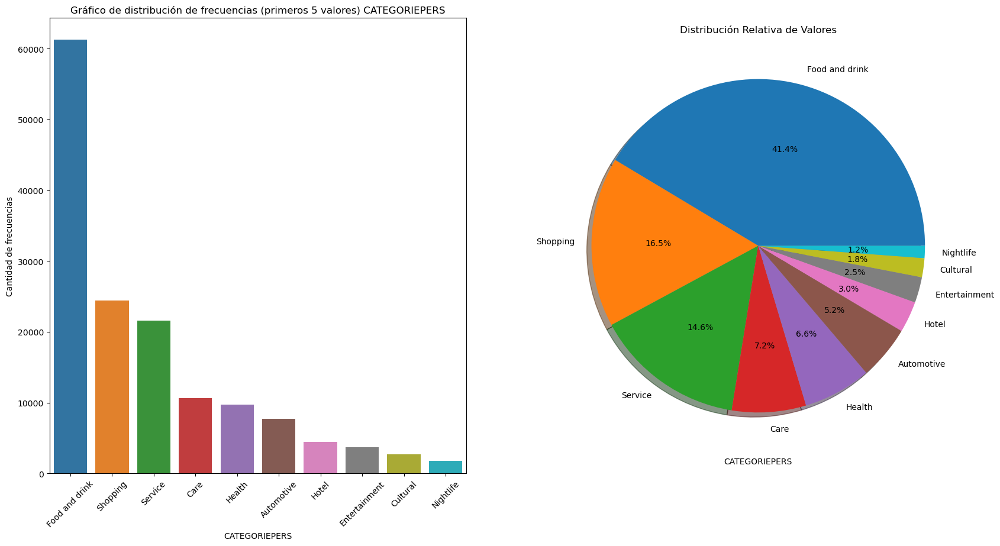



Estadísticas Básicas


count             150167
unique                15
top       Food and drink
freq               61267
Name: CATEGORIEPERS, dtype: object
----------------------------------------------------------------------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------------------------------------------------------------------




In [47]:
descripcion_distribucion(df_BUSINESS)

## _Checkin._

### <h2 align= 'center'><u>Análisis general</u></h3>

StatementMeta(, 76ae3ccc-0ff3-43ab-b08b-381e5e4bde92, 49, Finished, Available)

INFORME PRELIMINAR SOBRE CARACTERISTICAS DEL DATASET:

--Dimensiones del DataFrame--
Filas: 131930
Columnas: 3

--Numero de datos--
395790

--Filas y Columnas--
Filas: muestra de indices-------> [0, 1, 2, 3, 4]  -----> Desde 0  Hasta 131929
Columnas: ['BUSINESS_ID', 'DATE', 'COUNT_CHECKIN']

--Tipo de columnas--
BUSINESS_ID      object
DATE             object
COUNT_CHECKIN     int64
dtype: object

--Cantidad de registros duplicados--
0

INFORME PRELIMINAR SOBRE LA COLUMNA/FEATURE BUSINESS_ID:

--Numero de datos nulos--
0

--Cantidad de valores unicos en la columna--
131930

--Valores unicos en la columna (Primeros 5 valores)--
['--sXnWH9Xm6_NvIjyuA99w' '-09Oc2D14vRnmirPh0vlXw'
 '-0G_6-KFGpCpxTUlVXCMYQ' '-0TffRSXXIlBYVbb5AwfTg'
 '-0iIxySkp97WNlwK66OGWg']

--Moda de la columna especificada--
Valor modal -----> --sXnWH9Xm6_NvIjyuA99w
Frecuencia acumulada ------> 1

--Distribucion de frecuencias (primeros valores con mayor cantidad de frecuencias)--
 BUSINESS_ID
--sXnWH9Xm6_NvIjyuA99w    1

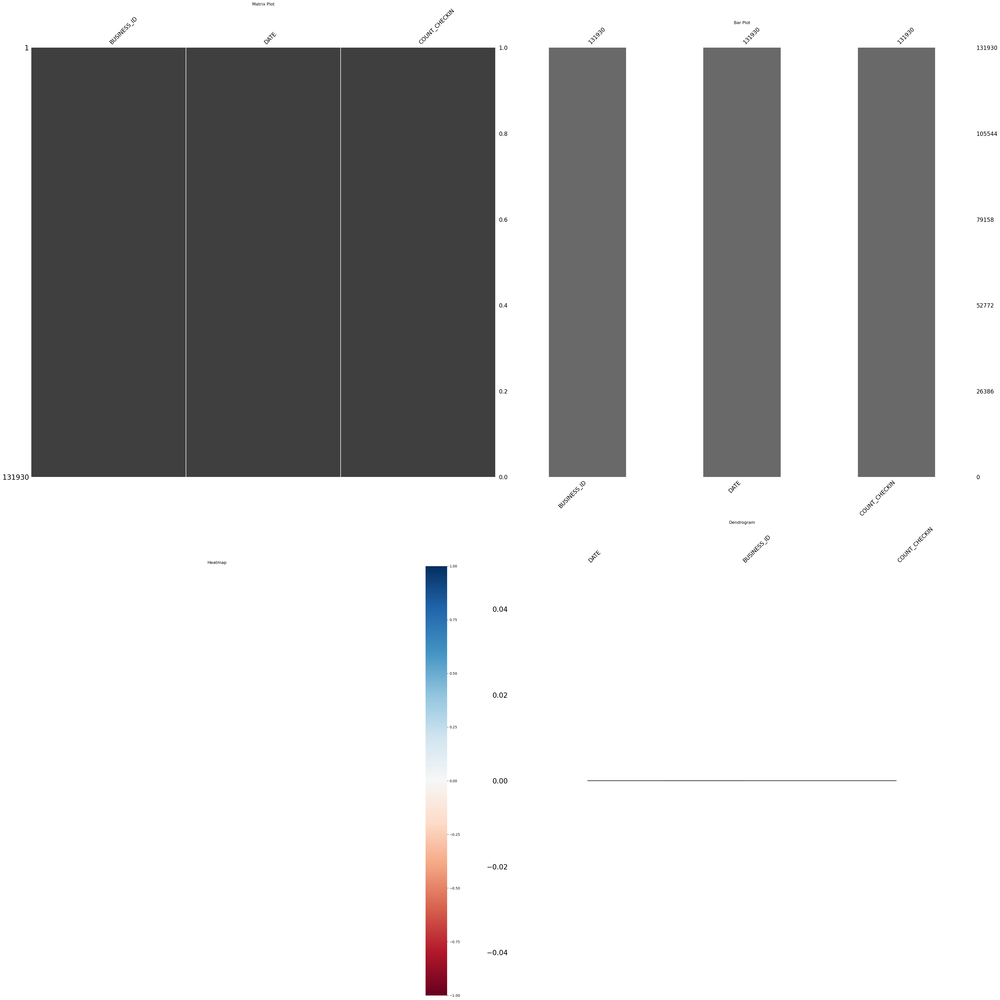

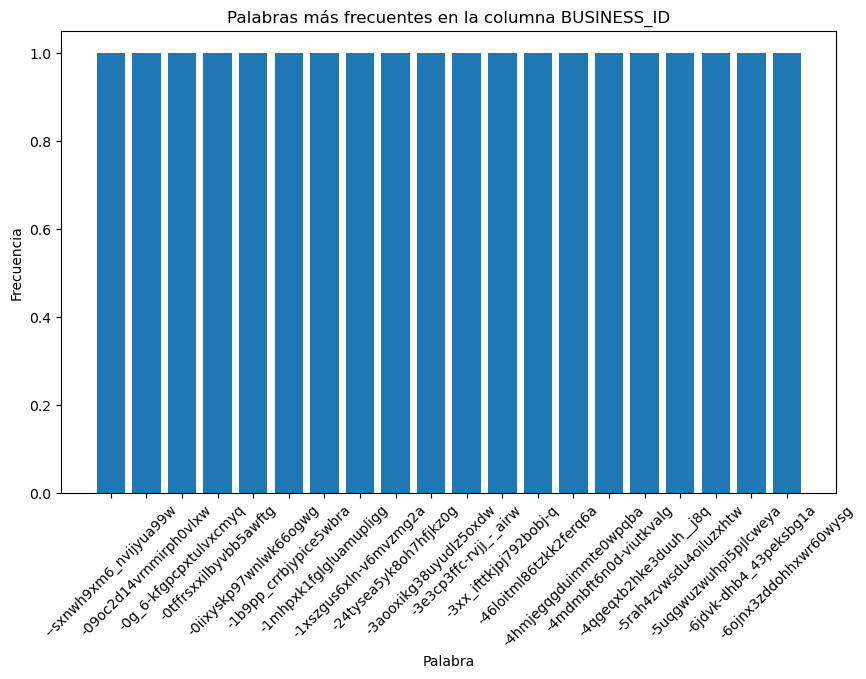

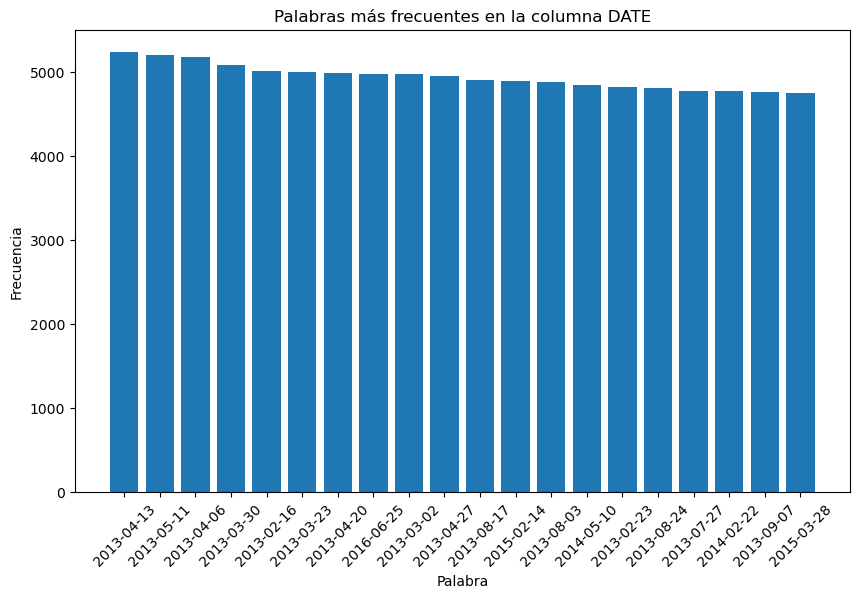

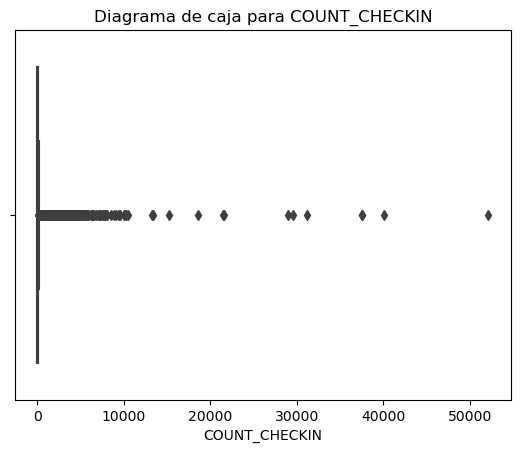

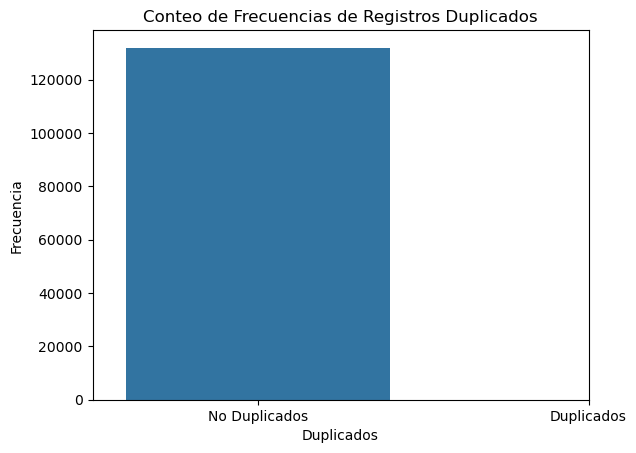

(    nombre_campo       tipo_datos  no_nulos_%  nulos_%  nulos
 0    BUSINESS_ID  [<class 'str'>]       100.0      0.0      0
 1           DATE  [<class 'str'>]       100.0      0.0      0
 2  COUNT_CHECKIN  [<class 'int'>]       100.0      0.0      0,
 '~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~oo~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~',
 [None, None, None])

In [48]:
informe_general(df_CHECKIN)

### <h2 align= 'center'><u>Análisis descriptivo</u></h2>

StatementMeta(, 76ae3ccc-0ff3-43ab-b08b-381e5e4bde92, 50, Finished, Available)

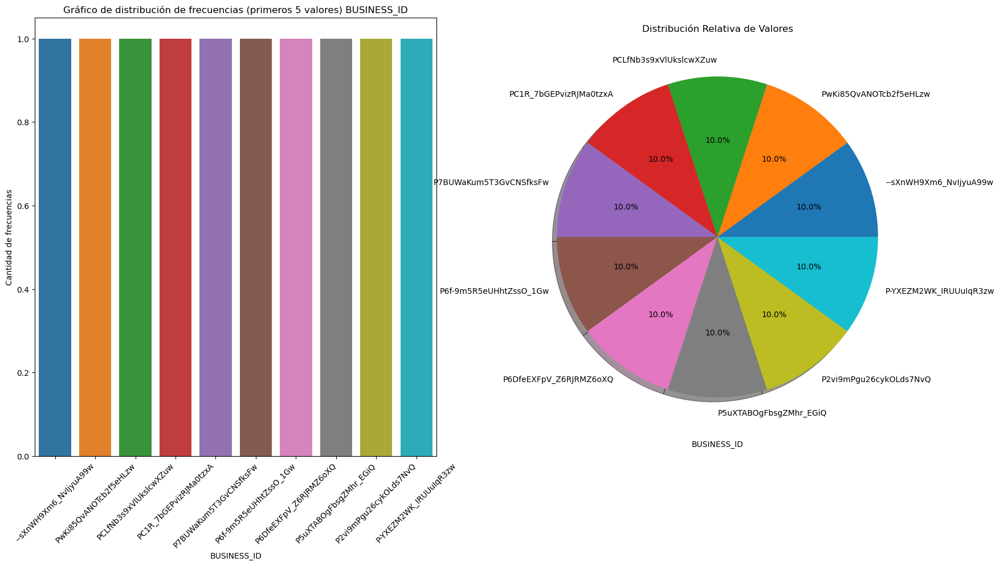



Estadísticas Básicas


count                     131930
unique                    131930
top       --sXnWH9Xm6_NvIjyuA99w
freq                           1
Name: BUSINESS_ID, dtype: object
----------------------------------------------------------------------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------------------------------------------------------------------




ValueError: Image size of 82119x42976 pixels is too large. It must be less than 2^16 in each direction.

In [49]:
descripcion_distribucion(df_CHECKIN)

# **GOOGLE**

## _Metadata._

### <h2 align= 'center'><u>Análisis general</u></h3>

StatementMeta(, 76ae3ccc-0ff3-43ab-b08b-381e5e4bde92, 51, Finished, Available)

INFORME PRELIMINAR SOBRE CARACTERISTICAS DEL DATASET:

--Dimensiones del DataFrame--
Filas: 3025011
Columnas: 10

--Numero de datos--
30152113

--Filas y Columnas--
Filas: muestra de indices-------> [0, 1, 2, 3, 4]  -----> Desde 0  Hasta 3025010
Columnas: ['NAME', 'ADDRESS', 'GMAP_ID', 'AVG_RATING', 'NUM_OF_REVIEWS', 'URL', 'CATEGORY', 'CATEGORY SUMMARY', 'LATITUDE', 'LONGITUDE']

--Tipo de columnas--
NAME                 object
ADDRESS              object
GMAP_ID              object
AVG_RATING            int64
NUM_OF_REVIEWS        int64
URL                  object
CATEGORY             object
CATEGORY SUMMARY     object
LATITUDE            float64
LONGITUDE           float64
dtype: object

--Cantidad de registros duplicados--
26583

INFORME PRELIMINAR SOBRE LA COLUMNA/FEATURE NAME:

--Numero de datos nulos--
67

--Cantidad de valores unicos en la columna--
2308001

--Valores unicos en la columna (Primeros 5 valores)--
['Los Angeles Public Social Services'
 'Orange County Social Servic

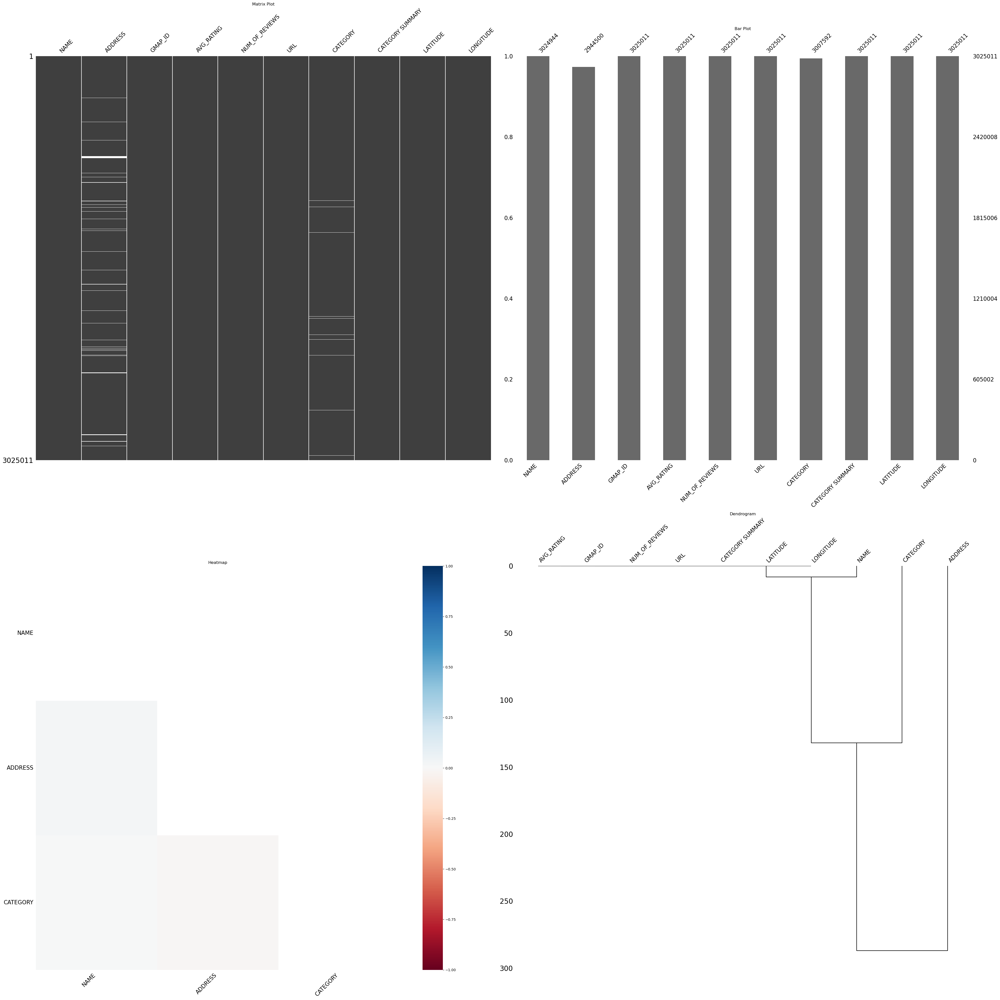

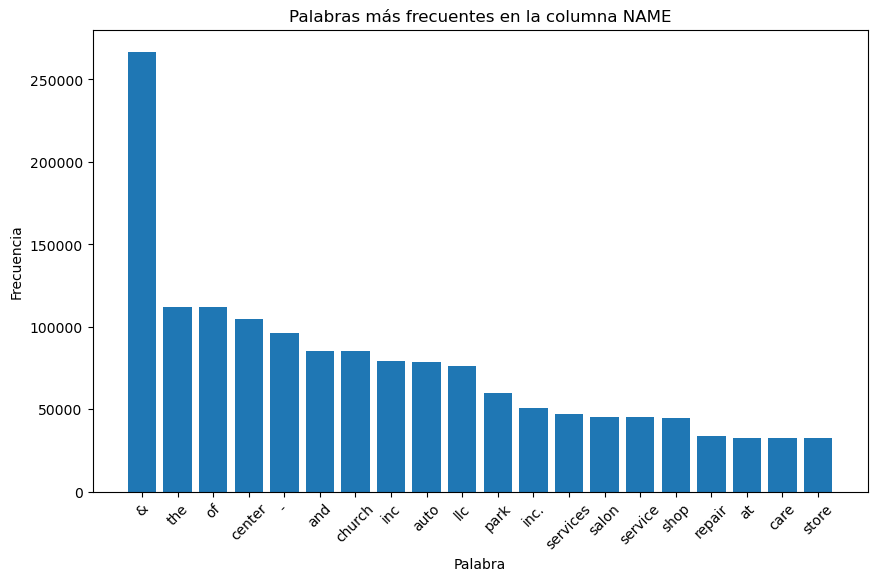

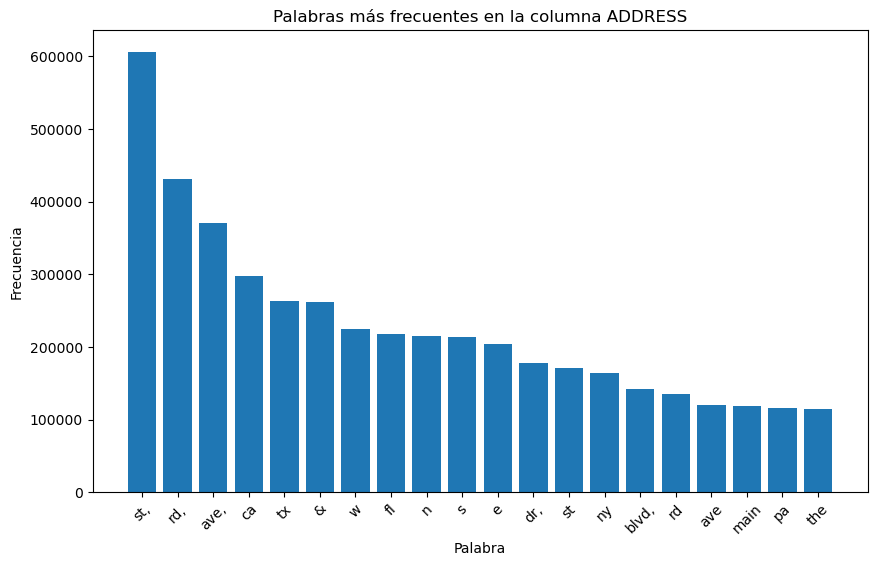

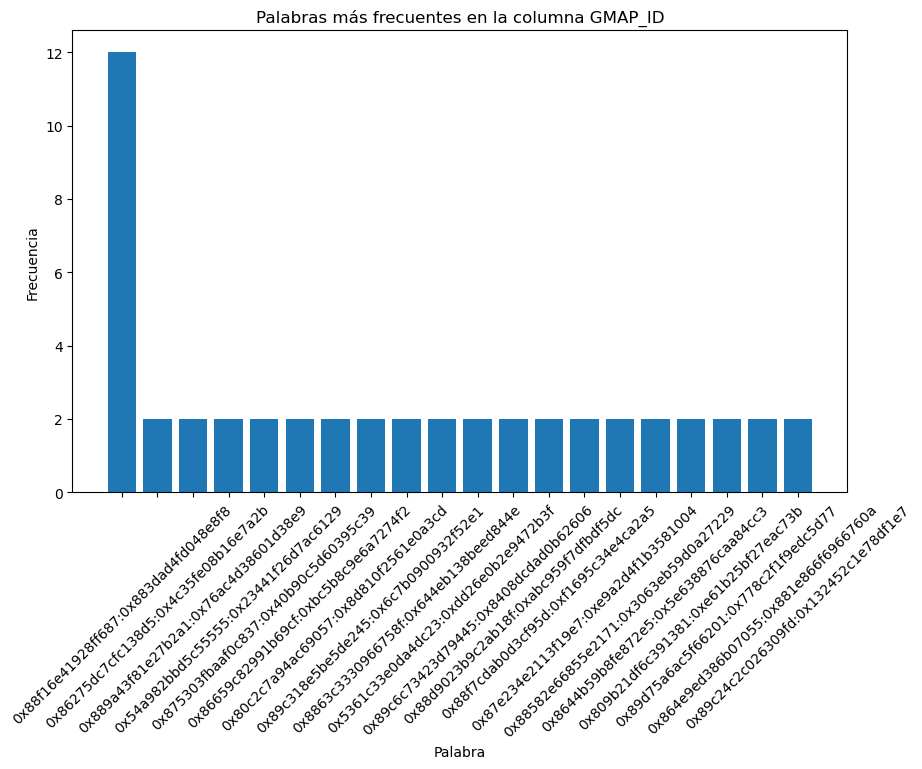

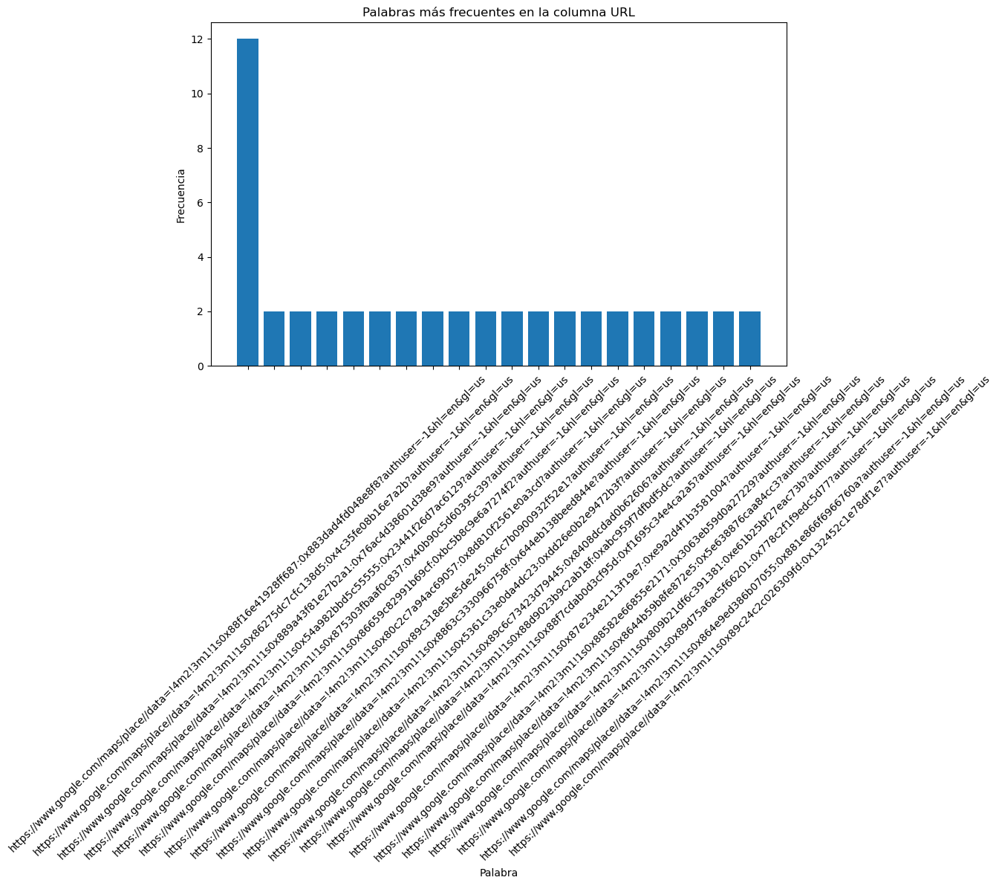

...

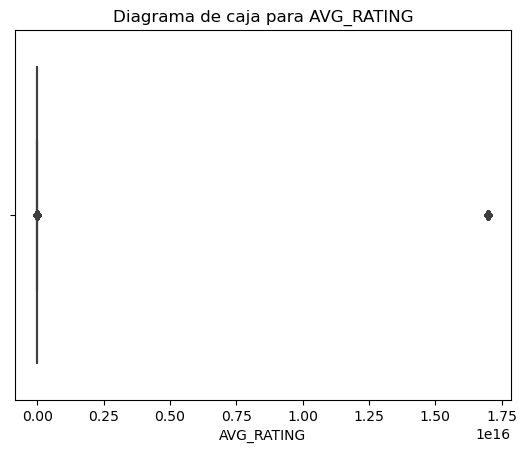

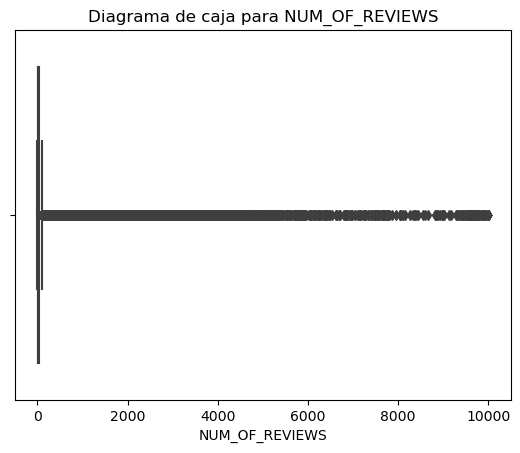

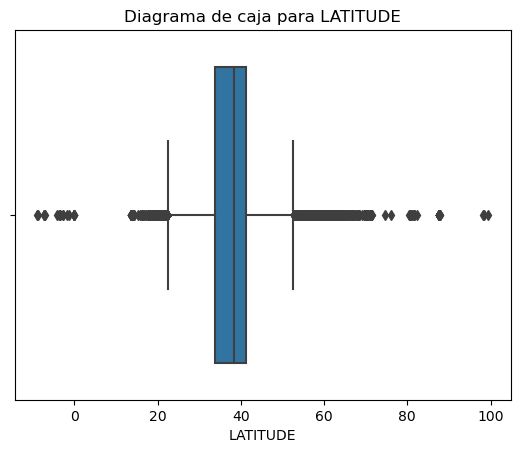

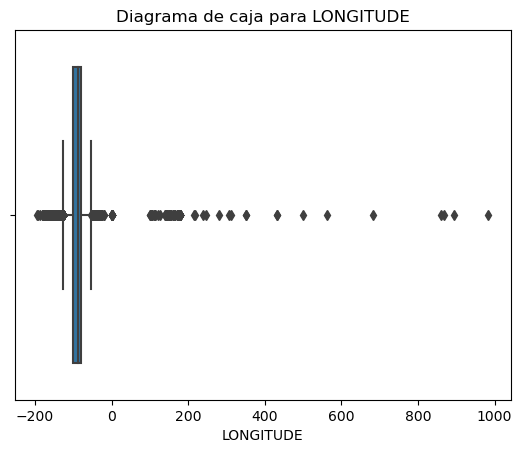

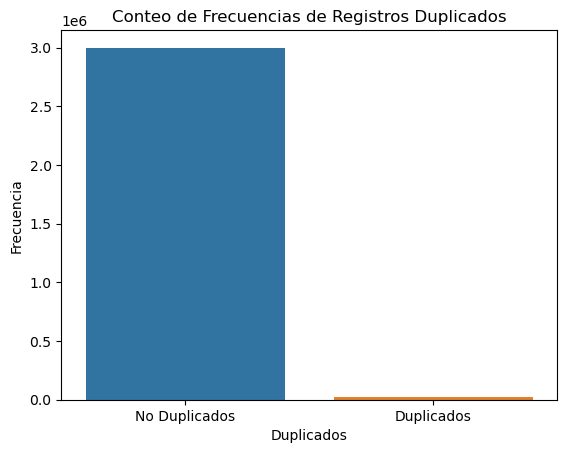

(       nombre_campo                        tipo_datos  no_nulos_%  nulos_%  \
 0              NAME  [<class 'str'>, <class 'float'>]      100.00     0.00   
 1           ADDRESS  [<class 'str'>, <class 'float'>]       97.34     2.66   
 2           GMAP_ID                   [<class 'str'>]      100.00     0.00   
 3        AVG_RATING                   [<class 'int'>]      100.00     0.00   
 4    NUM_OF_REVIEWS                   [<class 'int'>]      100.00     0.00   
 5               URL                   [<class 'str'>]      100.00     0.00   
 6          CATEGORY  [<class 'str'>, <class 'float'>]       99.42     0.58   
 7  CATEGORY SUMMARY                   [<class 'str'>]      100.00     0.00   
 8          LATITUDE                 [<class 'float'>]      100.00     0.00   
 9         LONGITUDE                 [<class 'float'>]      100.00     0.00   
 
    nulos  
 0     67  
 1  80511  
 2      0  
 3      0  
 4      0  
 5      0  
 6  17419  
 7      0  
 8      0  
 9      0

In [50]:
informe_general(df_METADATA)

### <h2 align= 'center'><u>Análisis descriptivo</u></h2>

StatementMeta(, 76ae3ccc-0ff3-43ab-b08b-381e5e4bde92, 52, Finished, Available)

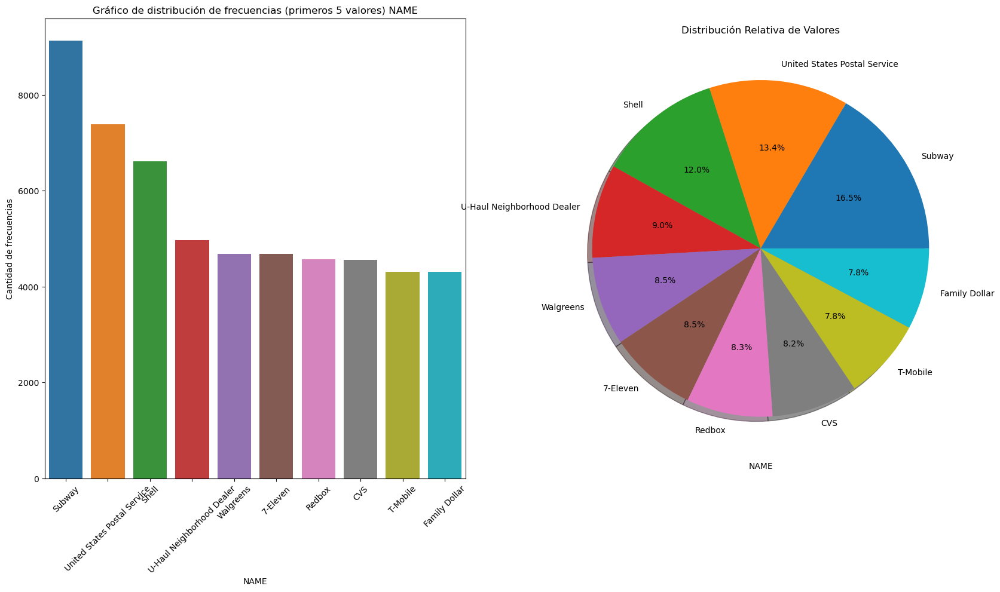



Estadísticas Básicas


count     3025011
unique    2308002
top        Subway
freq         9140
Name: NAME, dtype: object
----------------------------------------------------------------------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------------------------------------------------------------------




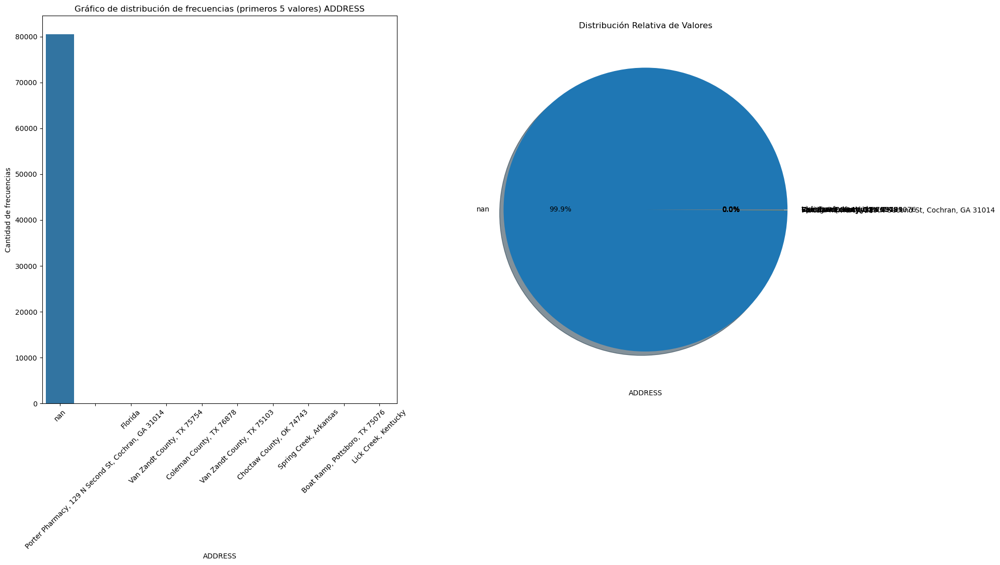



Estadísticas Básicas


count     3025011
unique    2915756
top           nan
freq        80511
Name: ADDRESS, dtype: object
----------------------------------------------------------------------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------------------------------------------------------------------




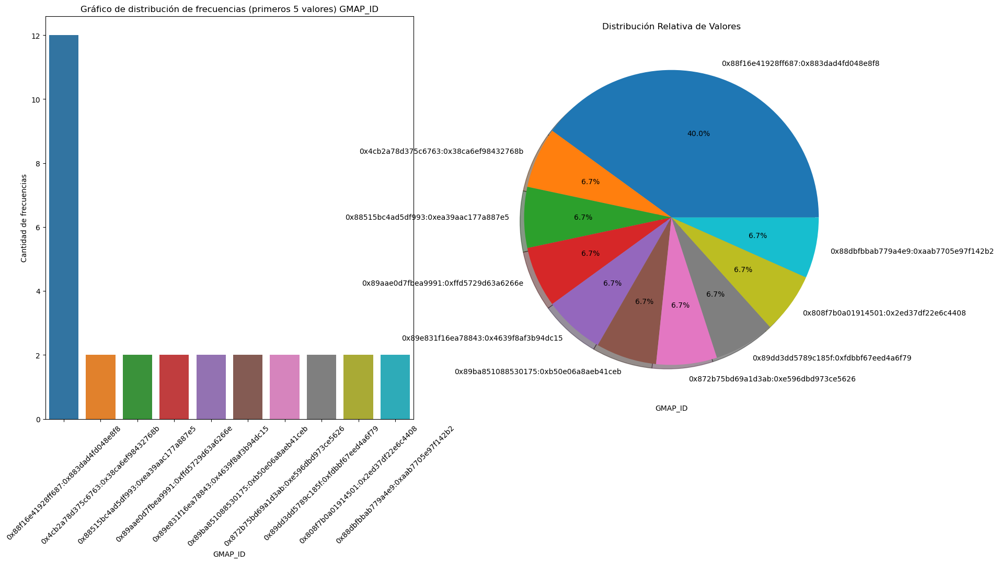



Estadísticas Básicas


count                                   3025011
unique                                  2998428
top       0x88f16e41928ff687:0x883dad4fd048e8f8
freq                                         12
Name: GMAP_ID, dtype: object
----------------------------------------------------------------------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------------------------------------------------------------------




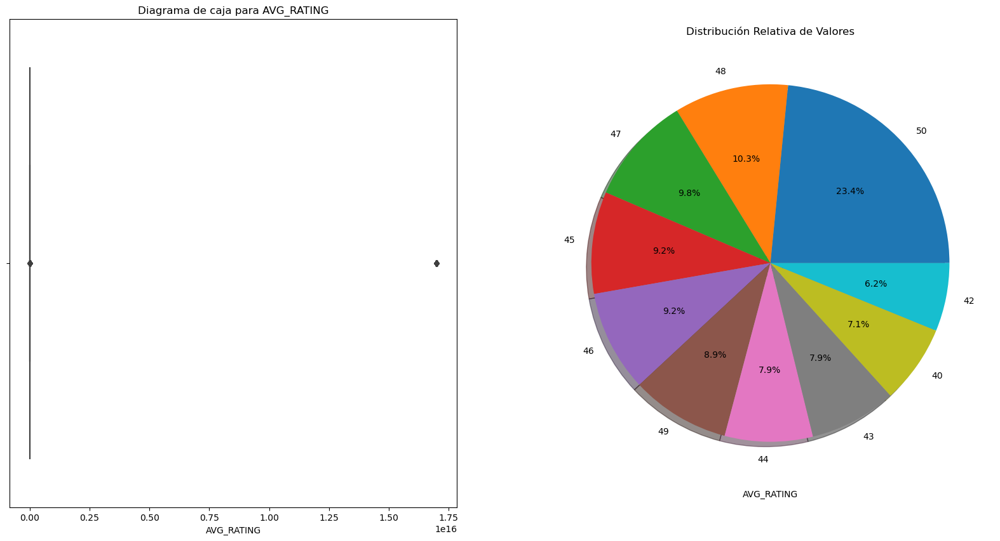



Estadísticas Básicas


count    3.025011e+06
mean     1.521284e+13
std      5.083177e+14
min      1.000000e+01
25%      4.000000e+01
50%      4.500000e+01
75%      4.800000e+01
max      1.700000e+16
Name: AVG_RATING, dtype: float64
----------------------------------------------------------------------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------------------------------------------------------------------




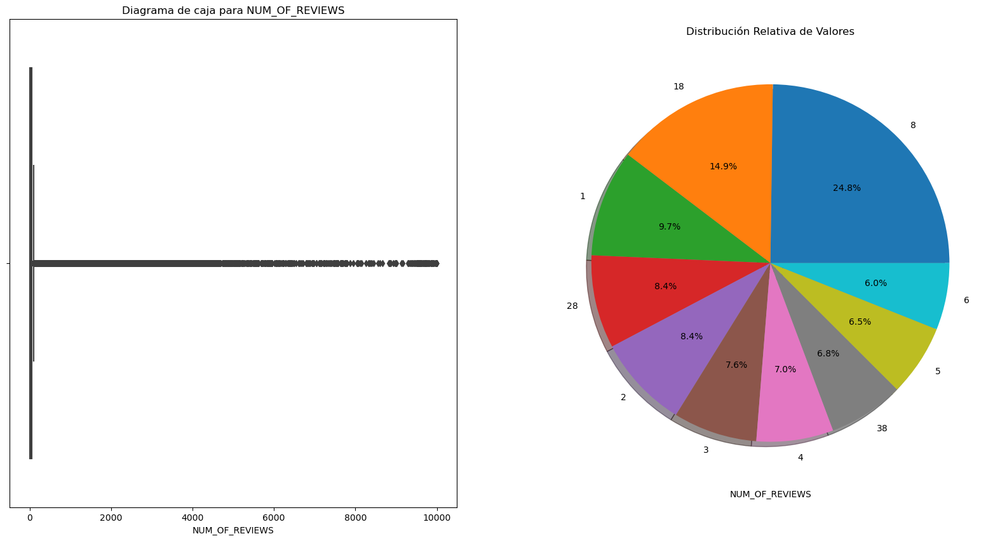



Estadísticas Básicas


count    3.025011e+06
mean     4.362911e+01
std      1.429952e+02
min      1.000000e+00
25%      7.000000e+00
50%      1.700000e+01
75%      4.300000e+01
max      9.998000e+03
Name: NUM_OF_REVIEWS, dtype: float64
----------------------------------------------------------------------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------------------------------------------------------------------




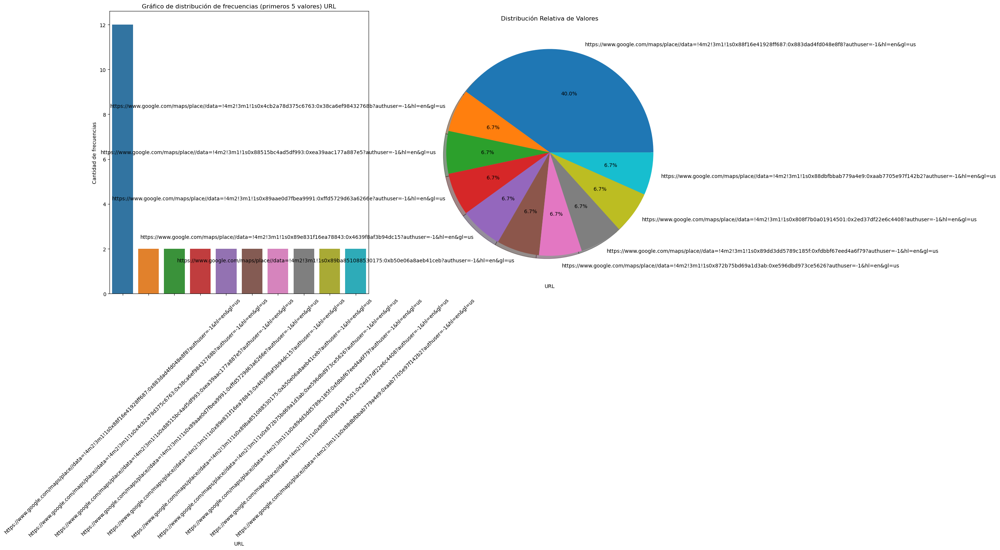



Estadísticas Básicas


count                                               3025011
unique                                              2998428
top       https://www.google.com/maps/place//data=!4m2!3...
freq                                                     12
Name: URL, dtype: object
----------------------------------------------------------------------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------------------------------------------------------------------




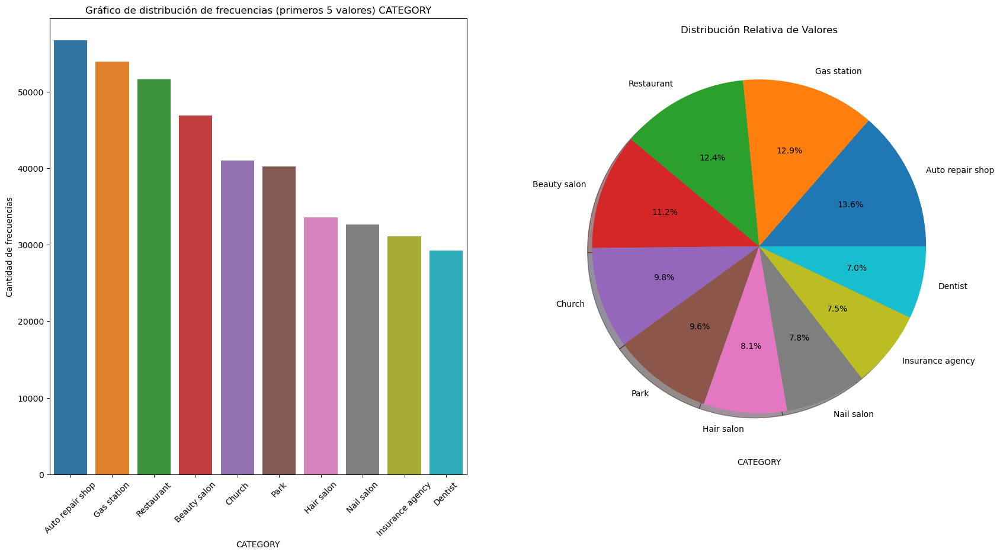



Estadísticas Básicas


count              3025011
unique                4233
top       Auto repair shop
freq                 56743
Name: CATEGORY, dtype: object
----------------------------------------------------------------------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------------------------------------------------------------------




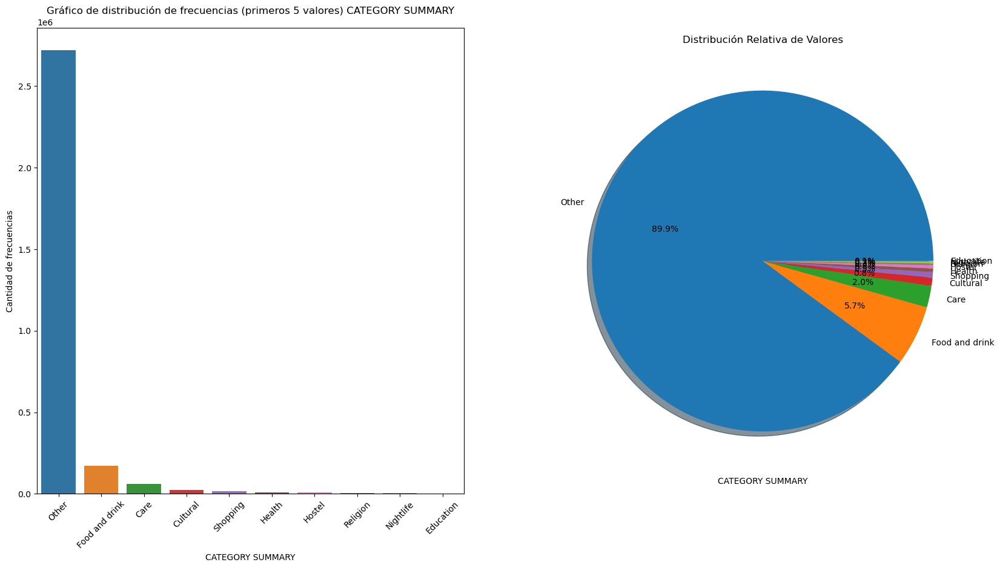



Estadísticas Básicas


count     3025011
unique         13
top         Other
freq      2719536
Name: CATEGORY SUMMARY, dtype: object
----------------------------------------------------------------------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------------------------------------------------------------------




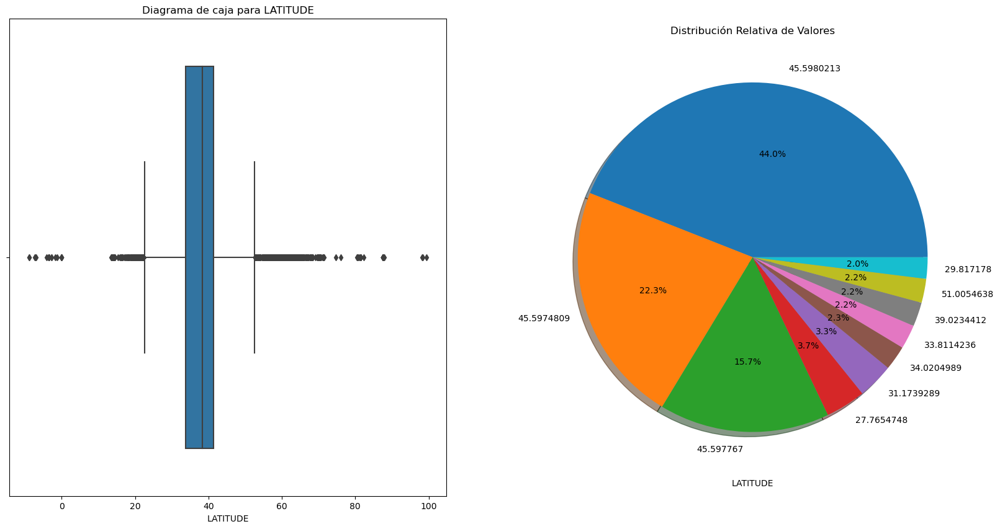



Estadísticas Básicas


count    3.025011e+06
mean     3.743139e+01
std      5.426070e+00
min     -8.880203e+00
25%      3.371061e+01
50%      3.828012e+01
75%      4.129186e+01
max      9.945684e+01
Name: LATITUDE, dtype: float64
----------------------------------------------------------------------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------------------------------------------------------------------




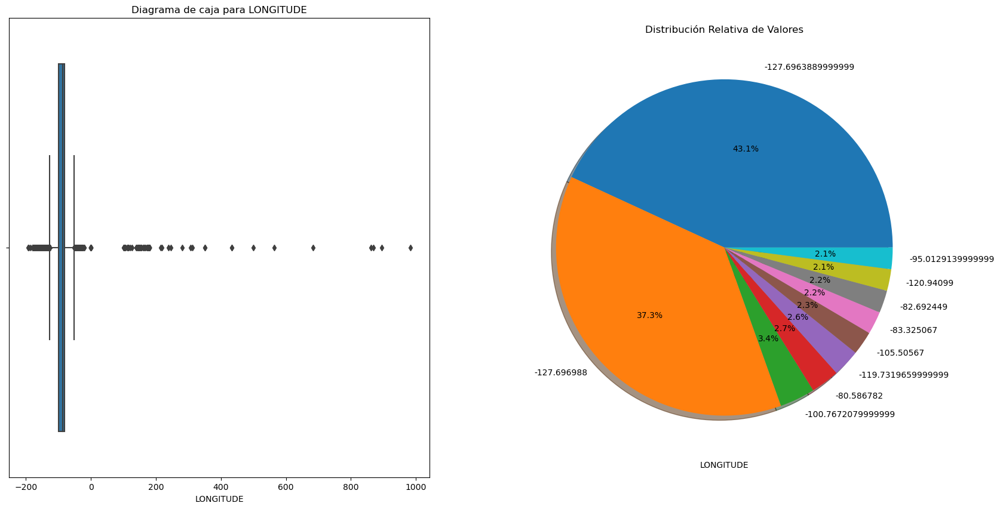



Estadísticas Básicas


count    3.025011e+06
mean    -9.235017e+01
std      1.644119e+01
min     -1.934733e+02
25%     -9.924546e+01
50%     -8.733945e+01
75%     -8.048573e+01
max      9.836994e+02
Name: LONGITUDE, dtype: float64
----------------------------------------------------------------------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------------------------------------------------------------------




In [51]:
descripcion_distribucion(df_METADATA)

## _Estados._

### <h2 align= 'center'><u>Análisis general</u></h3>

StatementMeta(, 76ae3ccc-0ff3-43ab-b08b-381e5e4bde92, 53, Finished, Available)

INFORME PRELIMINAR SOBRE CARACTERISTICAS DEL DATASET:

--Dimensiones del DataFrame--
Filas: 27619402
Columnas: 7

--Numero de datos--
193335814

--Filas y Columnas--
Filas: muestra de indices-------> [0, 1, 2, 3, 4]  -----> Desde 0  Hasta 27619401
Columnas: ['USER_ID', 'NAME', 'RATING', 'GMAP_ID', 'STATE', 'DATE', 'SENTIMENT_ANALYSIS']

--Tipo de columnas--
USER_ID               float64
NAME                   object
RATING                  int64
GMAP_ID                object
STATE                  object
DATE                   object
SENTIMENT_ANALYSIS      int64
dtype: object

--Cantidad de registros duplicados--
3

INFORME PRELIMINAR SOBRE LA COLUMNA/FEATURE USER_ID:

--Numero de datos nulos--
0

--Valores unicos en la columna--
Ej: [1.05296697e+36 1.03570276e+34 1.04160711e+36 1.02052795e+36
 1.00535521e+36]  -----> Desde 1.0529669723365984e+36  Hasta 1.0567301187516968e+36

--Estadisticos Principales de la columna--
Media: 8.618516489205118e+35
Desviacion Estandar: 4.23168890841925

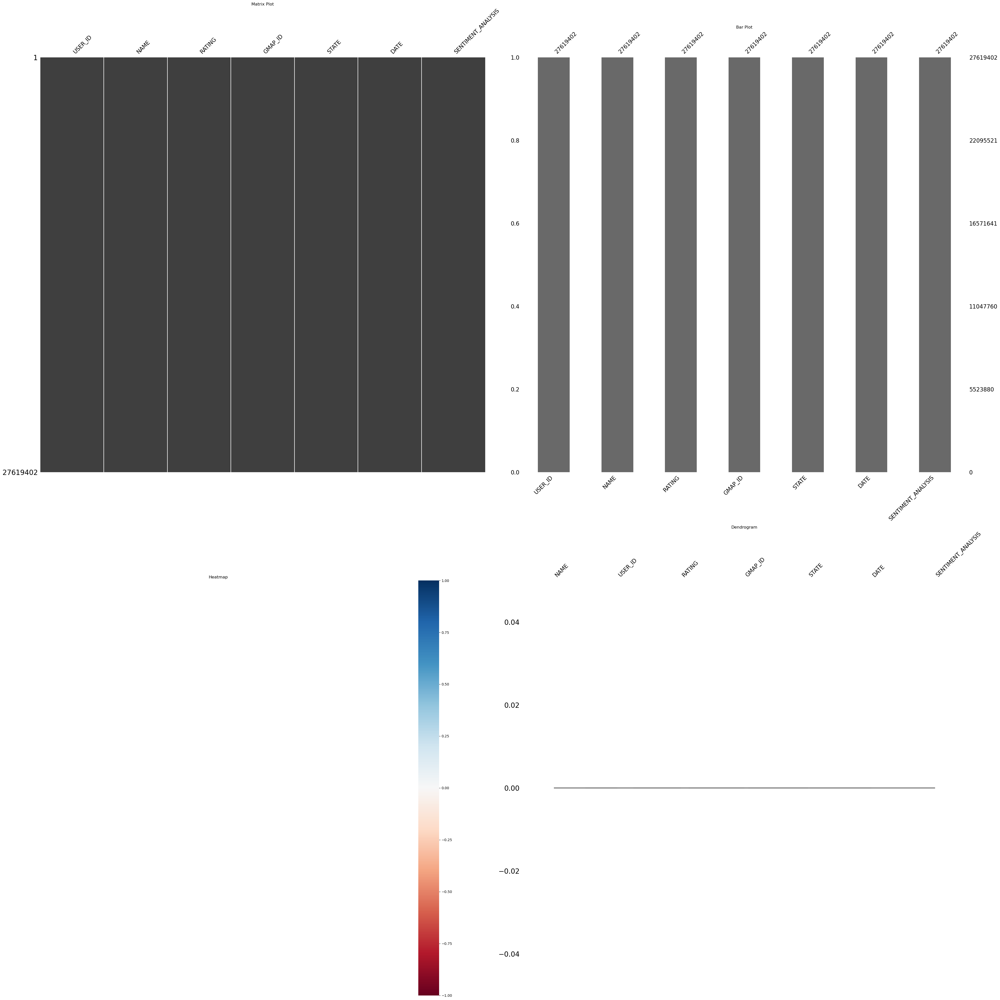

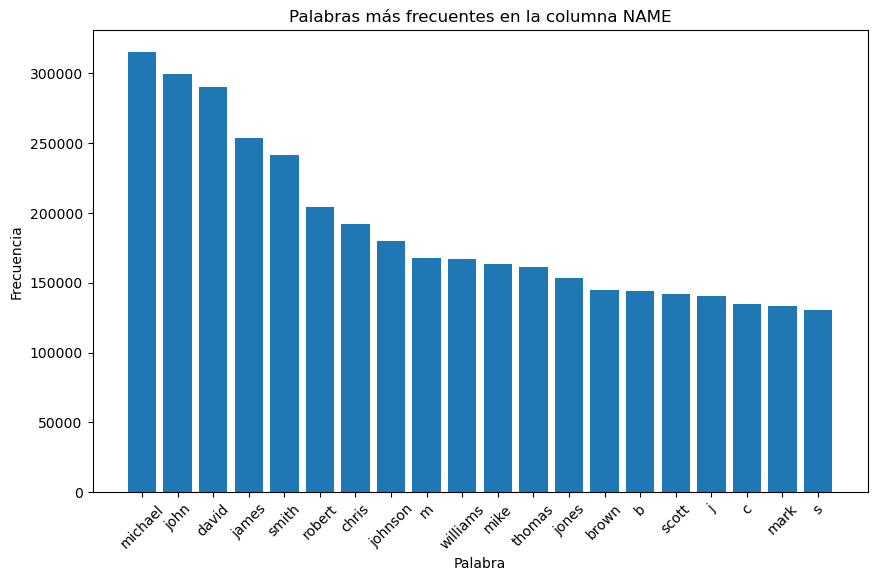

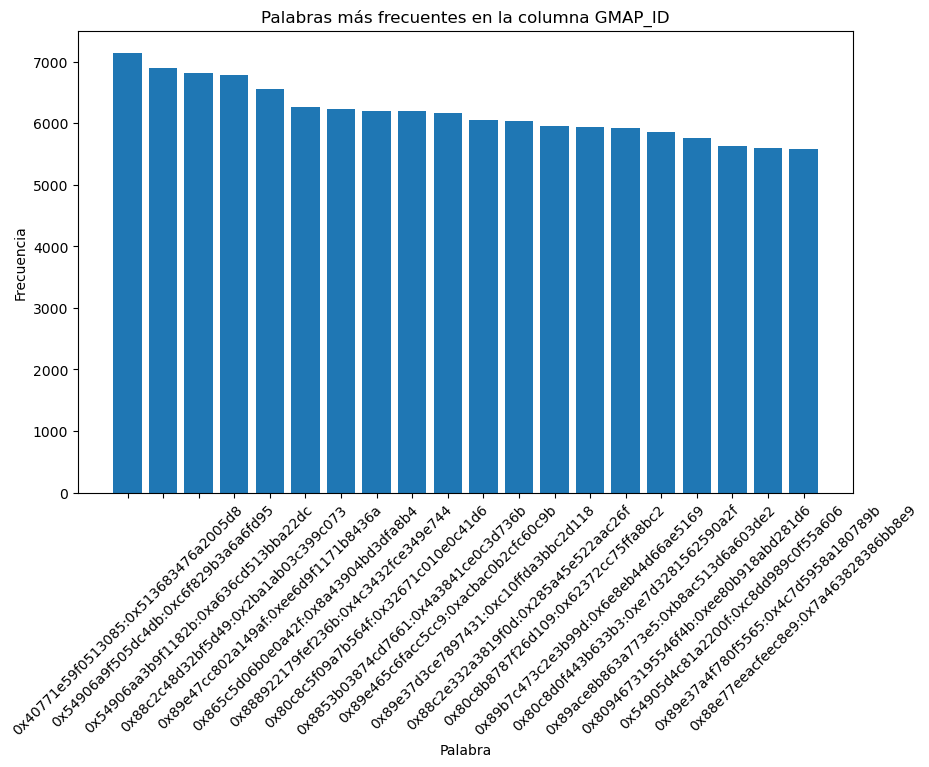

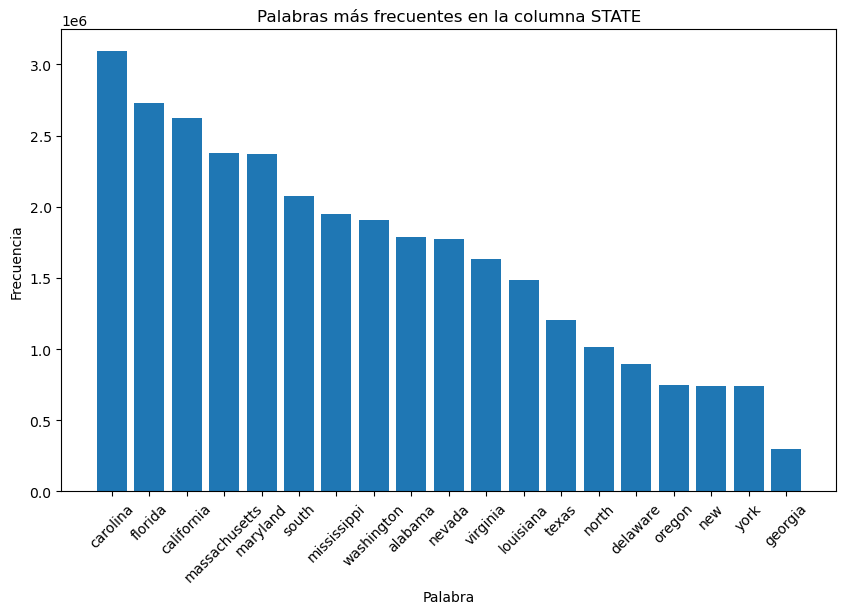

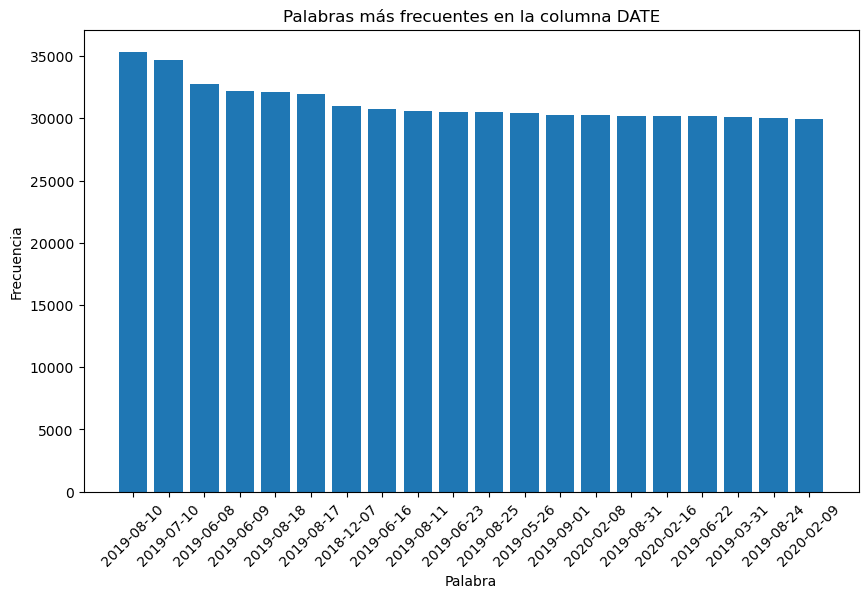

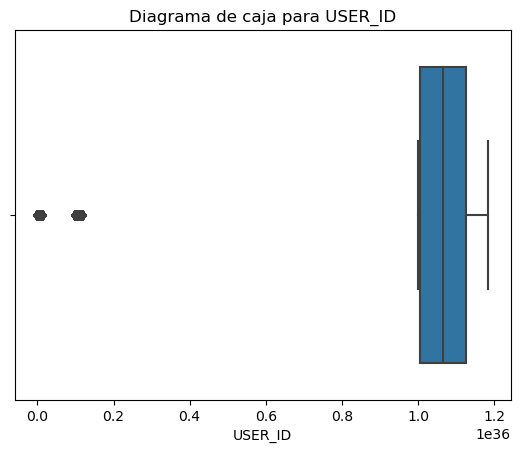

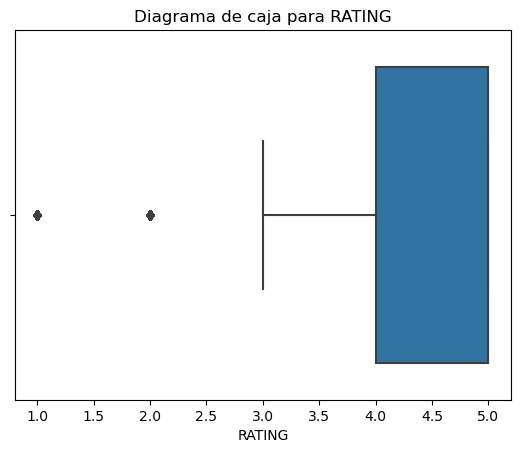

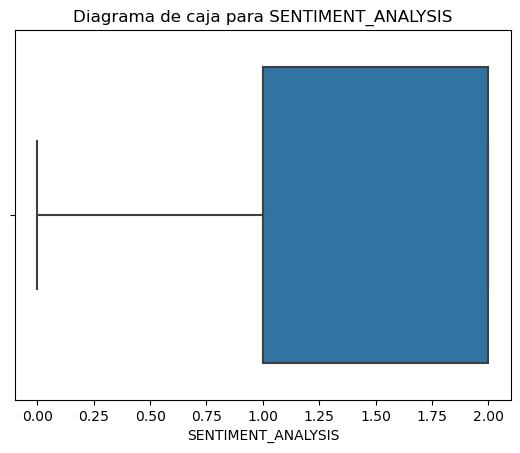

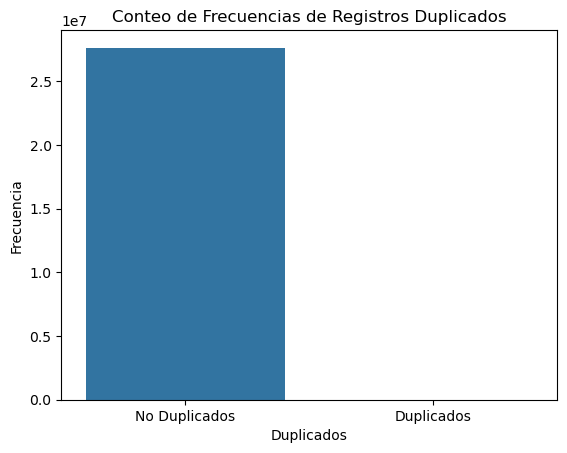

(         nombre_campo         tipo_datos  no_nulos_%  nulos_%  nulos
 0             USER_ID  [<class 'float'>]       100.0      0.0      0
 1                NAME    [<class 'str'>]       100.0      0.0      0
 2              RATING    [<class 'int'>]       100.0      0.0      0
 3             GMAP_ID    [<class 'str'>]       100.0      0.0      0
 4               STATE    [<class 'str'>]       100.0      0.0      0
 5                DATE    [<class 'str'>]       100.0      0.0      0
 6  SENTIMENT_ANALYSIS    [<class 'int'>]       100.0      0.0      0,
 '~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~oo~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~',
 [None, None, None, None, None, None, None])

In [52]:
informe_general(df_ESTADOS)

### <h2 align= 'center'><u>Análisis descriptivo</u></h3>

StatementMeta(, 76ae3ccc-0ff3-43ab-b08b-381e5e4bde92, 54, Finished, Available)

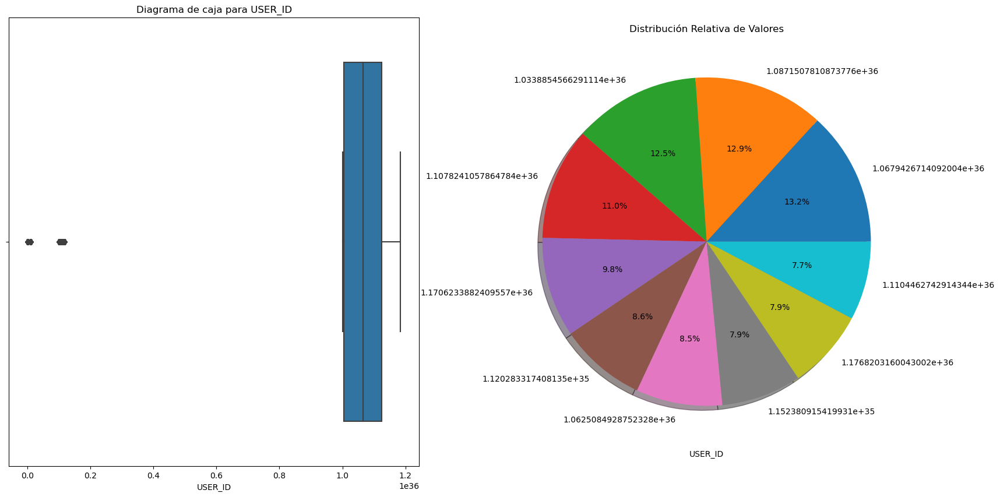



Estadísticas Básicas


count    2.761940e+07
mean     8.618516e+35
std      4.231689e+35
min      1.015159e+29
25%      1.004908e+36
50%      1.064901e+36
75%      1.124638e+36
max      1.184467e+36
Name: USER_ID, dtype: float64
----------------------------------------------------------------------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------------------------------------------------------------------




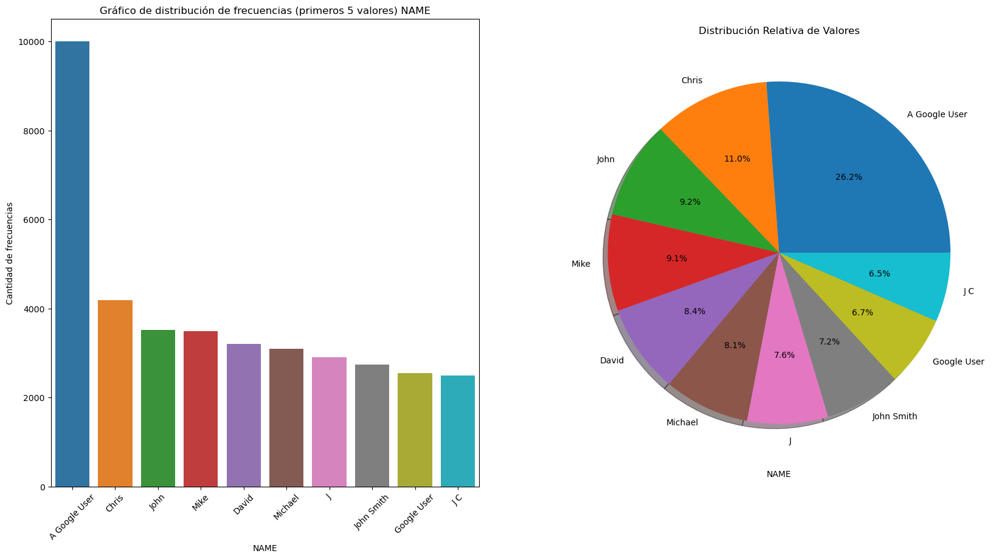



Estadísticas Básicas


count          27619402
unique          3747465
top       A Google User
freq              10011
Name: NAME, dtype: object
----------------------------------------------------------------------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------------------------------------------------------------------




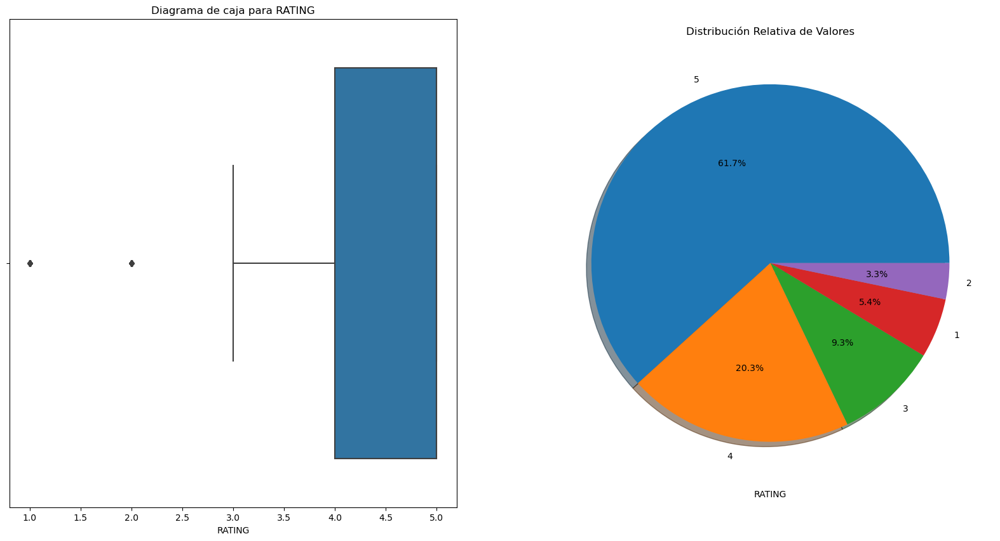



Estadísticas Básicas


count    2.761940e+07
mean     4.297707e+00
std      1.112433e+00
min      1.000000e+00
25%      4.000000e+00
50%      5.000000e+00
75%      5.000000e+00
max      5.000000e+00
Name: RATING, dtype: float64
----------------------------------------------------------------------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------------------------------------------------------------------




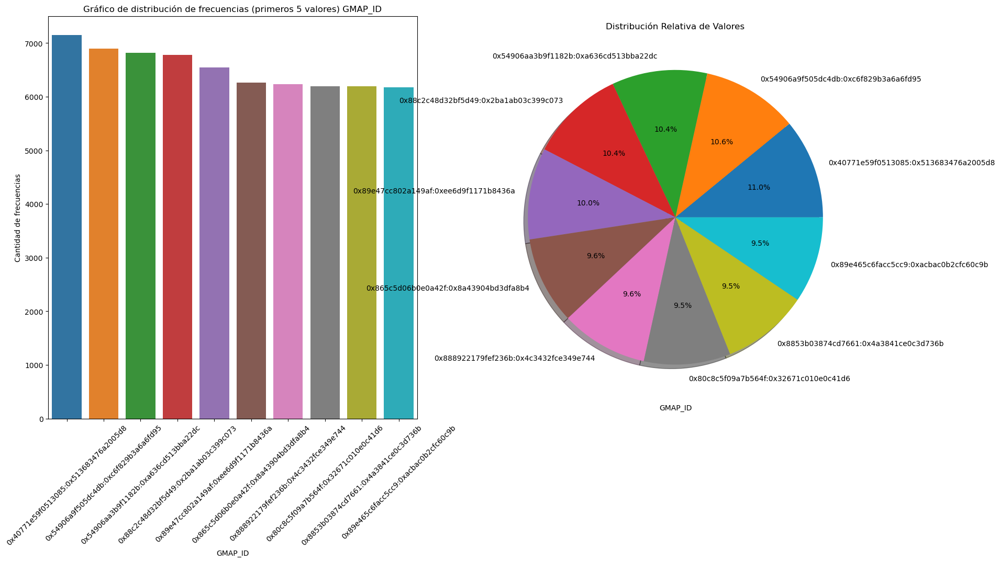



Estadísticas Básicas


count                                  27619402
unique                                   492973
top       0x40771e59f0513085:0x513683476a2005d8
freq                                       7148
Name: GMAP_ID, dtype: object
----------------------------------------------------------------------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------------------------------------------------------------------




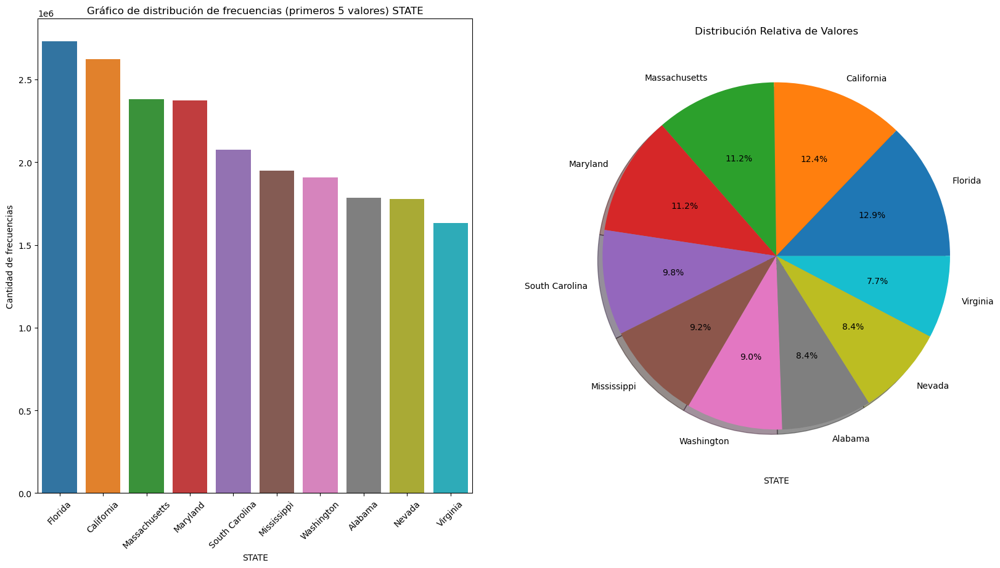



Estadísticas Básicas


count     27619402
unique          17
top        Florida
freq       2730604
Name: STATE, dtype: object
----------------------------------------------------------------------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------------------------------------------------------------------




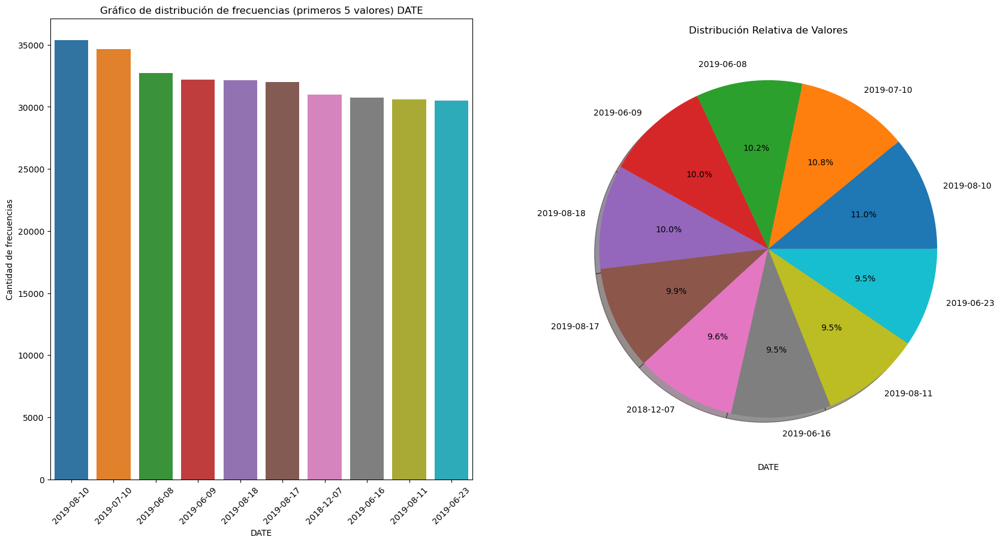



Estadísticas Básicas


count       27619402
unique          5160
top       2019-08-10
freq           35355
Name: DATE, dtype: object
----------------------------------------------------------------------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------------------------------------------------------------------




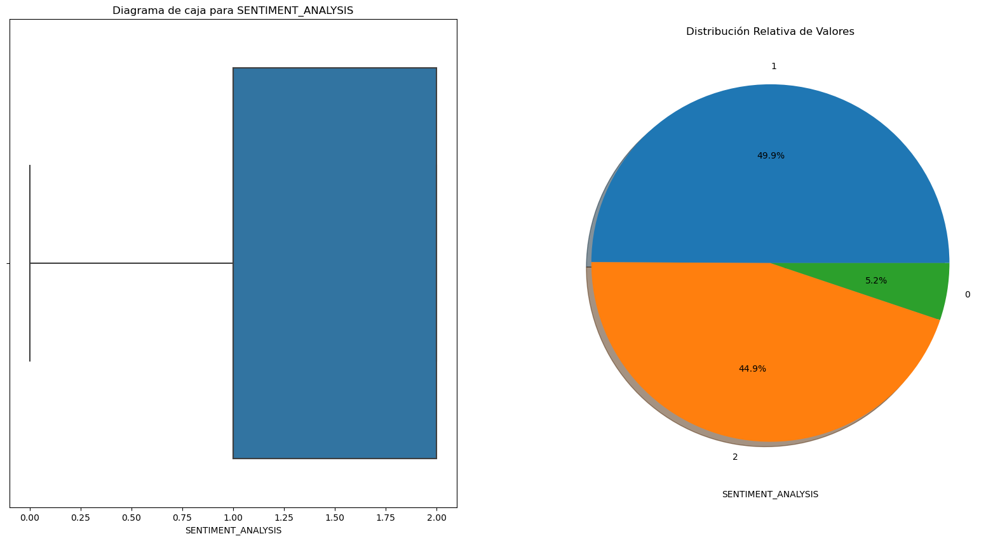



Estadísticas Básicas


count    2.761940e+07
mean     1.397586e+00
std      5.854472e-01
min      0.000000e+00
25%      1.000000e+00
50%      1.000000e+00
75%      2.000000e+00
max      2.000000e+00
Name: SENTIMENT_ANALYSIS, dtype: float64
----------------------------------------------------------------------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------------------------------------------------------------------




In [53]:
descripcion_distribucion(df_ESTADOS)

# **TRIP ADVISOR**

## _Trip._

### <h2 align= 'center'><u>Análisis general</u></h2>

StatementMeta(, 76ae3ccc-0ff3-43ab-b08b-381e5e4bde92, 55, Finished, Available)

INFORME PRELIMINAR SOBRE CARACTERISTICAS DEL DATASET:

--Dimensiones del DataFrame--
Filas: 177
Columnas: 11

--Numero de datos--
1947

--Filas y Columnas--
Filas: muestra de indices-------> [0, 1, 2, 3, 4]  -----> Desde 0  Hasta 176
Columnas: ['ID', 'LOCATION_ID', 'PUBLISHED_DATE', 'RATING', 'TITLE', 'USERNAME', 'STATE', 'NAME', 'LATITUDE', 'LONGITUDE', 'SENTIMENT_ANALYSIS']

--Tipo de columnas--
ID                      int64
LOCATION_ID             int64
PUBLISHED_DATE         object
RATING                  int64
TITLE                  object
USERNAME               object
STATE                  object
NAME                   object
LATITUDE              float64
LONGITUDE             float64
SENTIMENT_ANALYSIS      int64
dtype: object

--Cantidad de registros duplicados--
0

INFORME PRELIMINAR SOBRE LA COLUMNA/FEATURE ID:

--Numero de datos nulos--
0

--Valores unicos en la columna--
Ej: [947109079 944581119 943655648 943292122 944737064]  -----> Desde 947109079  Hasta 947337814

--Est

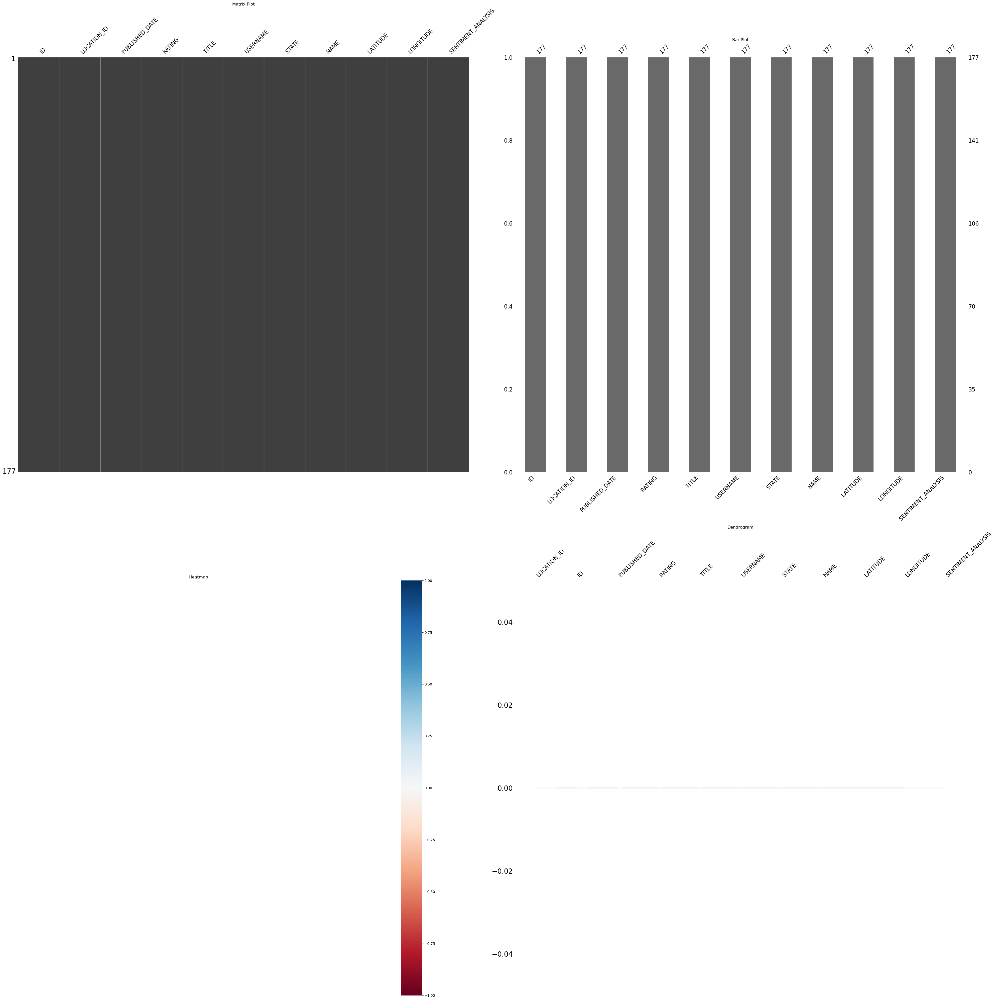

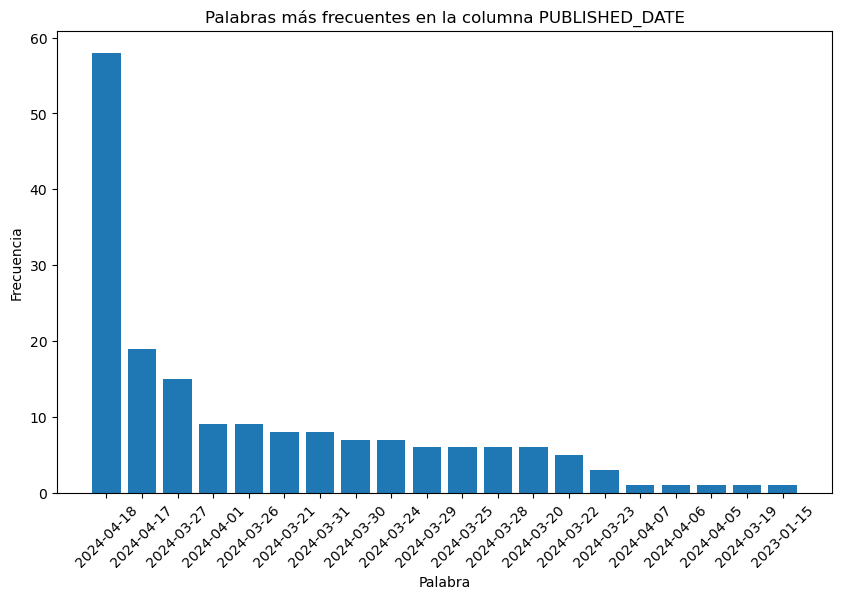

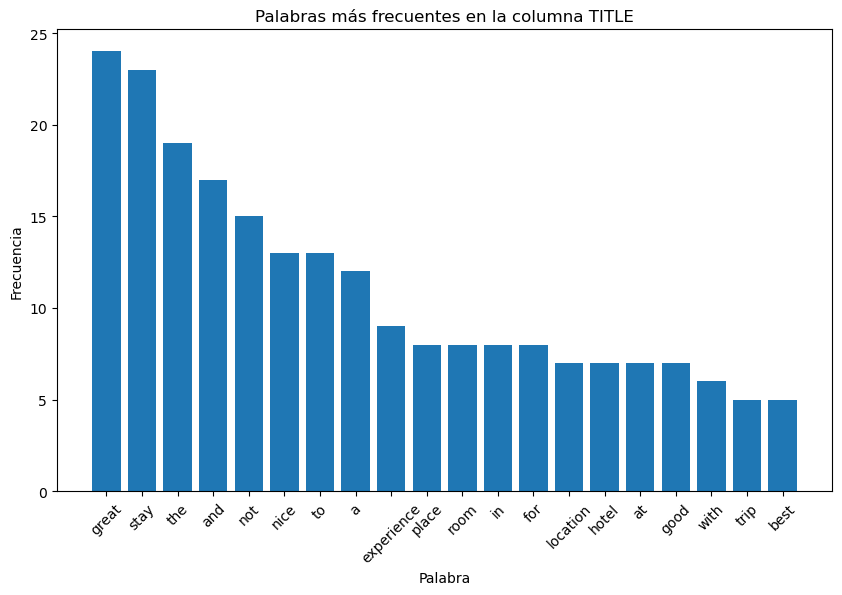

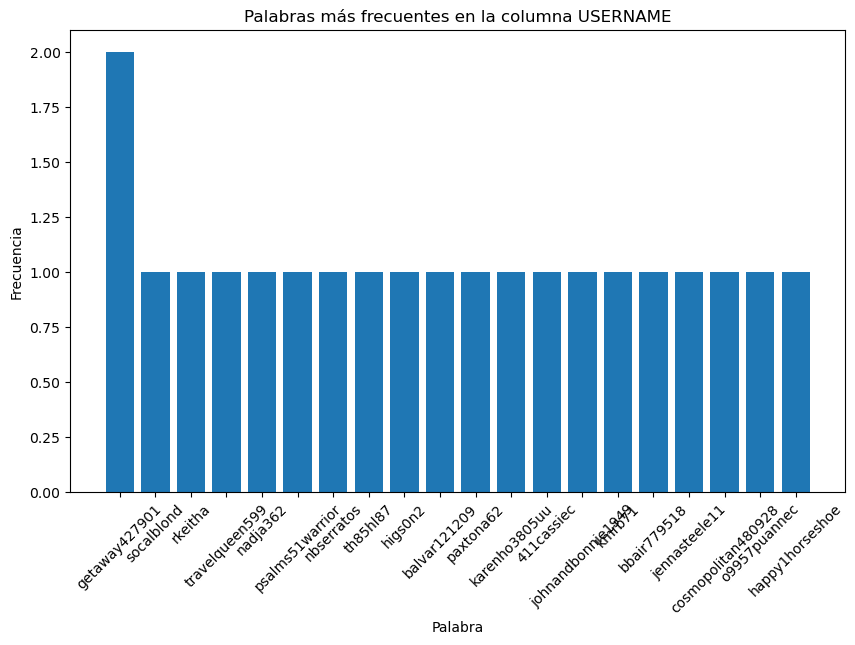

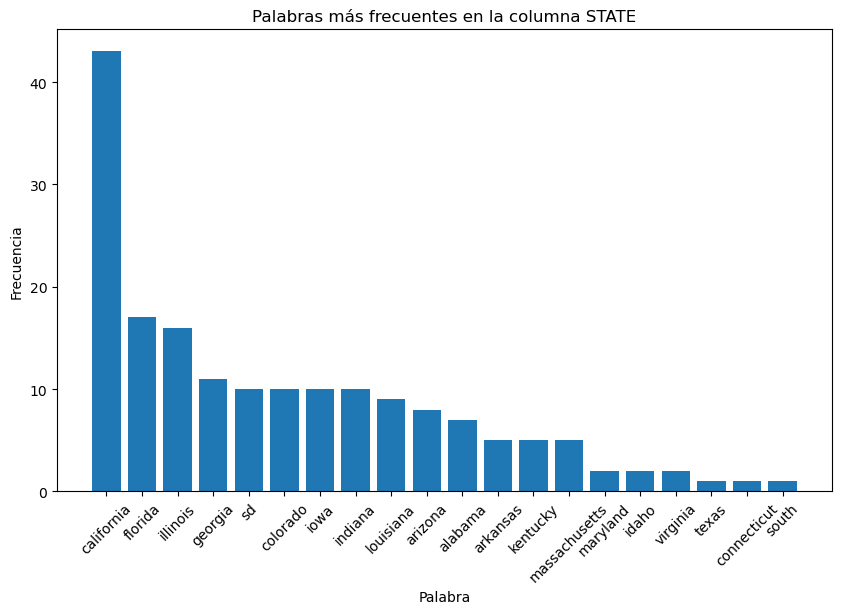

...

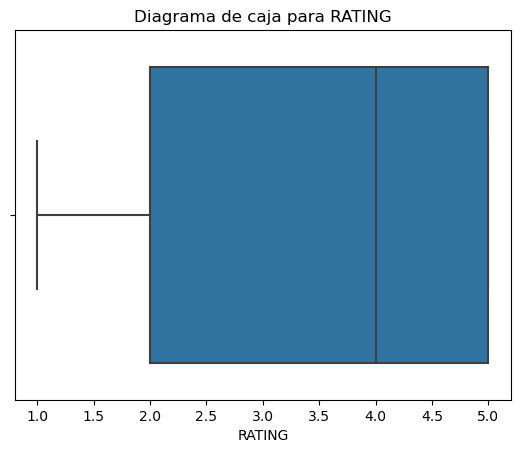

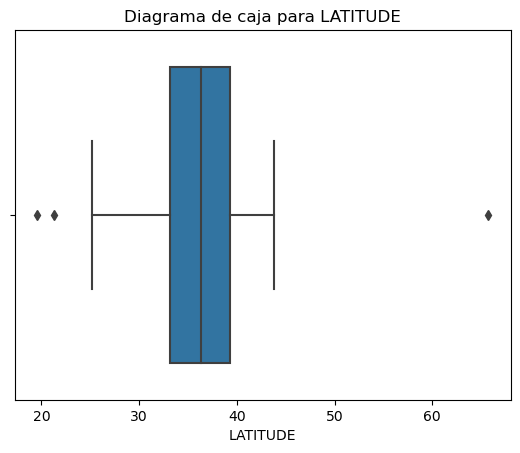

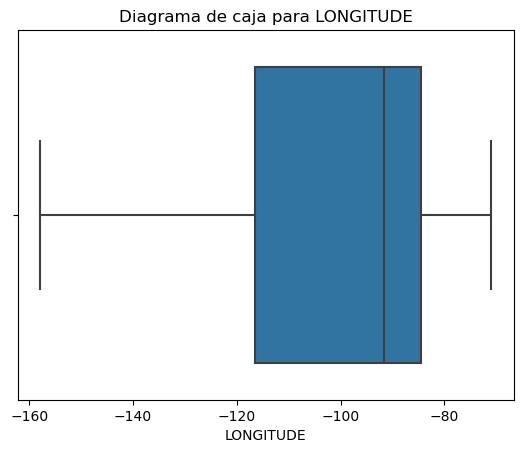

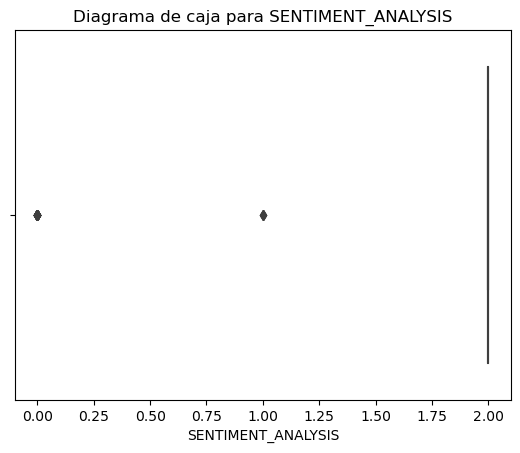

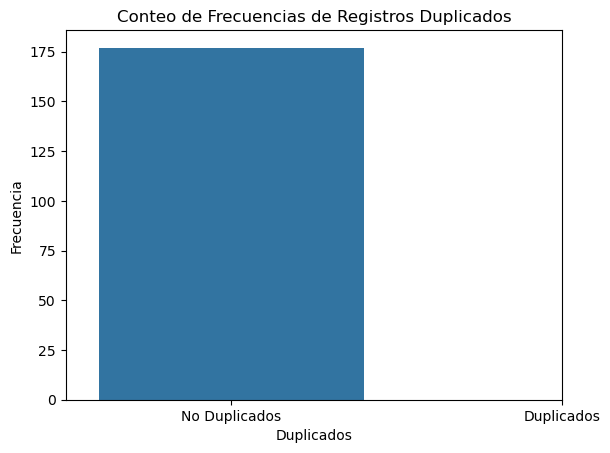

(          nombre_campo         tipo_datos  no_nulos_%  nulos_%  nulos
 0                   ID    [<class 'int'>]       100.0      0.0      0
 1          LOCATION_ID    [<class 'int'>]       100.0      0.0      0
 2       PUBLISHED_DATE    [<class 'str'>]       100.0      0.0      0
 3               RATING    [<class 'int'>]       100.0      0.0      0
 4                TITLE    [<class 'str'>]       100.0      0.0      0
 5             USERNAME    [<class 'str'>]       100.0      0.0      0
 6                STATE    [<class 'str'>]       100.0      0.0      0
 7                 NAME    [<class 'str'>]       100.0      0.0      0
 8             LATITUDE  [<class 'float'>]       100.0      0.0      0
 9            LONGITUDE  [<class 'float'>]       100.0      0.0      0
 10  SENTIMENT_ANALYSIS    [<class 'int'>]       100.0      0.0      0,
 '~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~oo~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~',
 [None, None, None, None, None, None, No

In [54]:
informe_general(df_TRIP)

### <h2 align= 'center'><u>Análisis Descriptivo</u></h2>

StatementMeta(, 76ae3ccc-0ff3-43ab-b08b-381e5e4bde92, 56, Finished, Available)

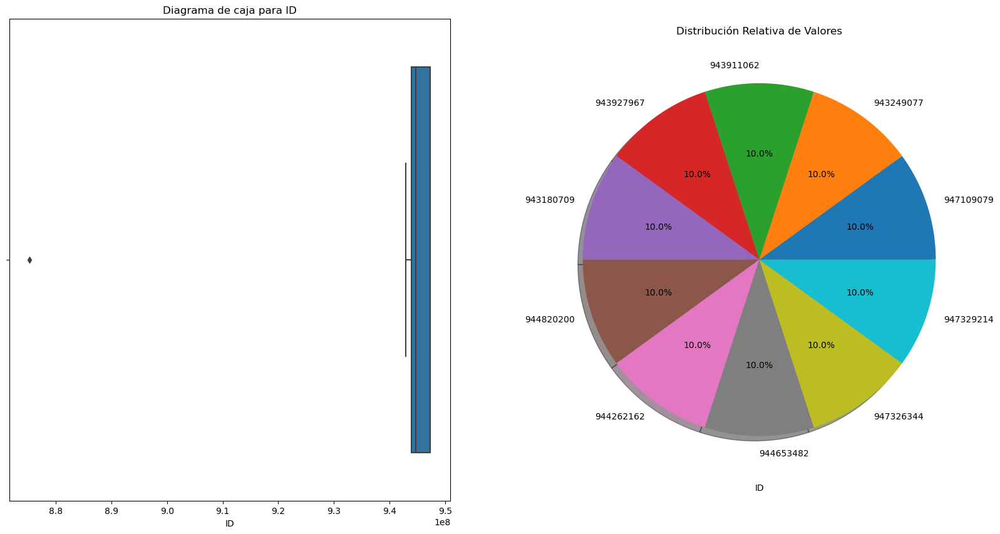



Estadísticas Básicas


count    1.770000e+02
mean     9.450747e+08
std      5.529095e+06
min      8.752459e+08
25%      9.439489e+08
50%      9.447371e+08
75%      9.473186e+08
max      9.473418e+08
Name: ID, dtype: float64
----------------------------------------------------------------------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------------------------------------------------------------------




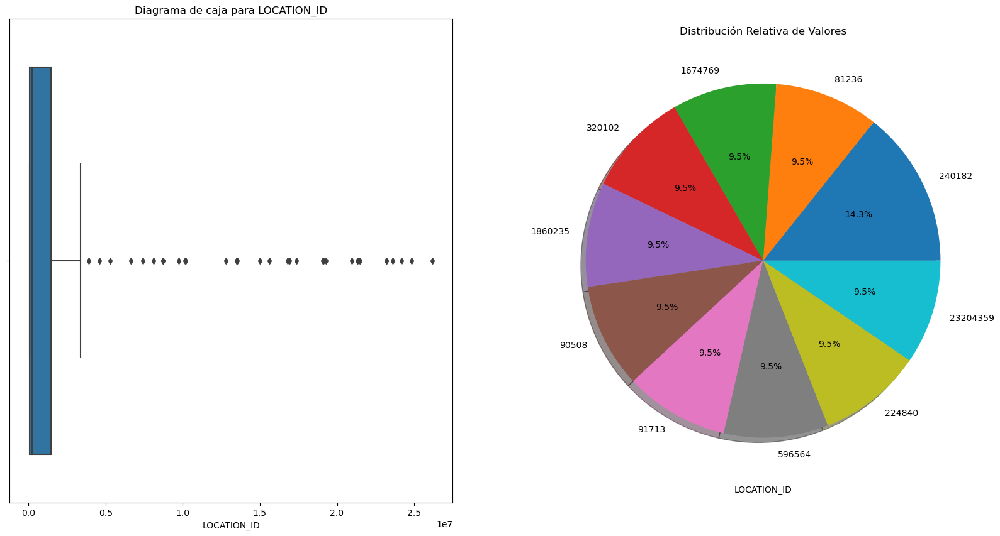



Estadísticas Básicas


count    1.770000e+02
mean     3.179470e+06
std      6.507419e+06
min      7.244800e+04
25%      9.033900e+04
50%      2.401820e+05
75%      1.477365e+06
max      2.619320e+07
Name: LOCATION_ID, dtype: float64
----------------------------------------------------------------------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------------------------------------------------------------------




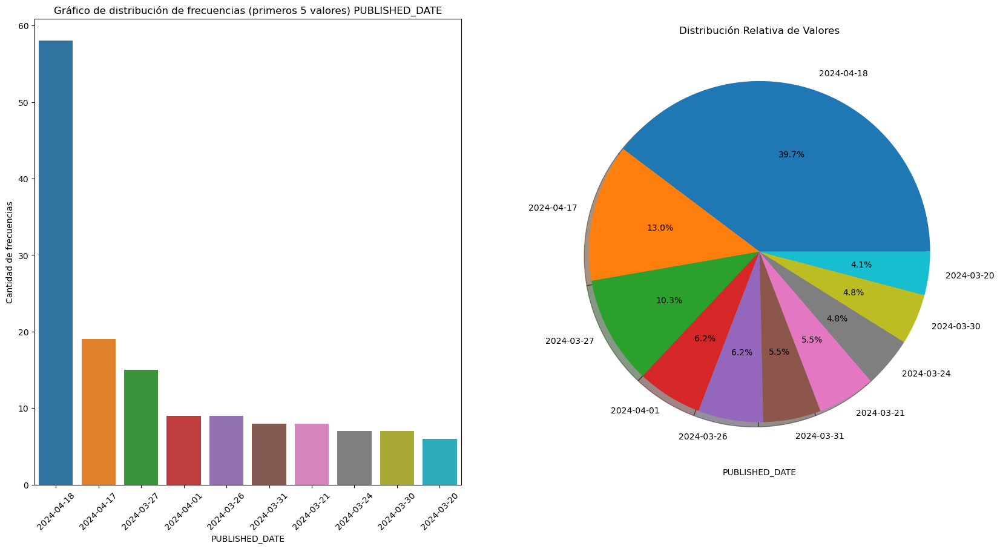



Estadísticas Básicas


count            177
unique            20
top       2024-04-18
freq              58
Name: PUBLISHED_DATE, dtype: object
----------------------------------------------------------------------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------------------------------------------------------------------




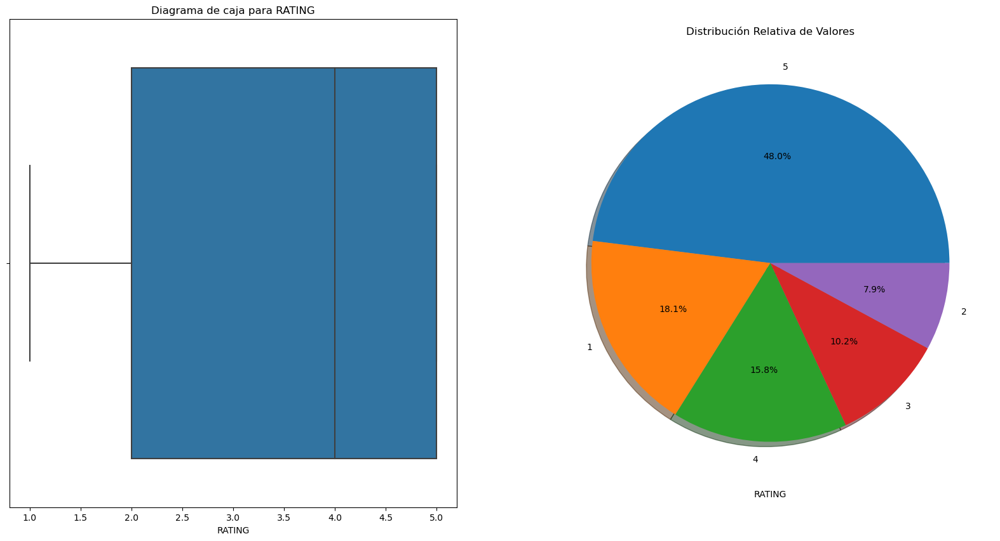



Estadísticas Básicas


count    177.000000
mean       3.677966
std        1.560602
min        1.000000
25%        2.000000
50%        4.000000
75%        5.000000
max        5.000000
Name: RATING, dtype: float64
----------------------------------------------------------------------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------------------------------------------------------------------




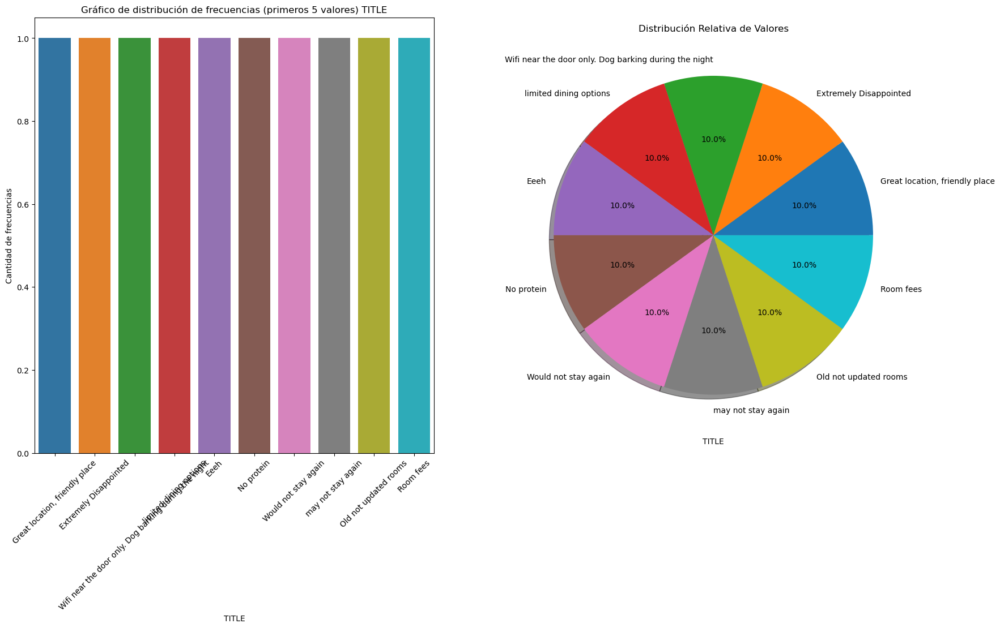



Estadísticas Básicas


count                                177
unique                               177
top       Great location, friendly place
freq                                   1
Name: TITLE, dtype: object
----------------------------------------------------------------------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------------------------------------------------------------------




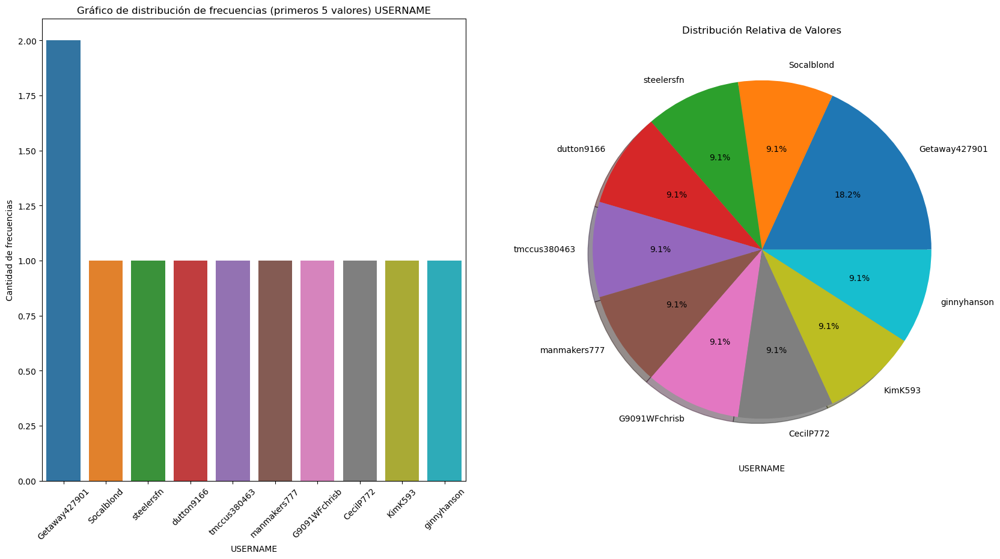



Estadísticas Básicas


count               177
unique              176
top       Getaway427901
freq                  2
Name: USERNAME, dtype: object
----------------------------------------------------------------------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------------------------------------------------------------------




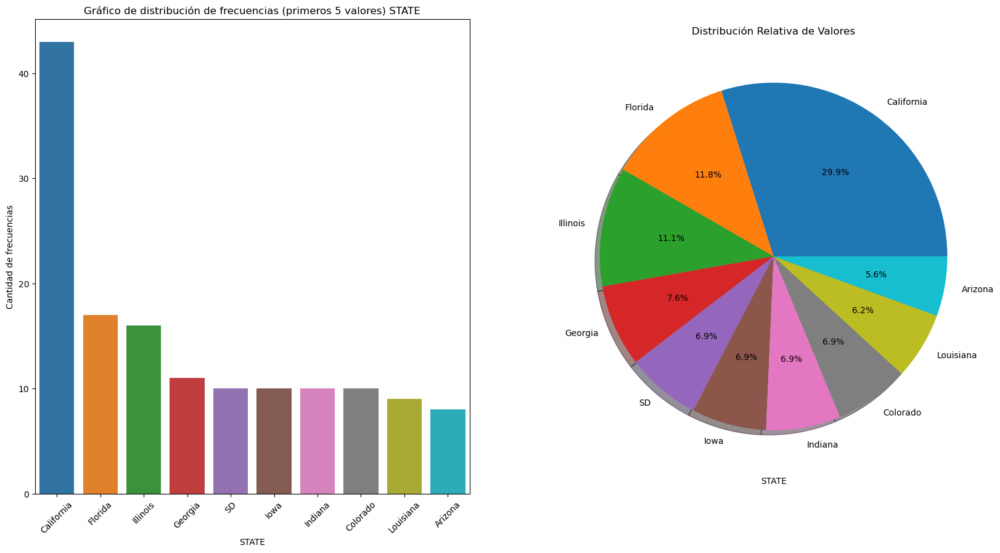



Estadísticas Básicas


count            177
unique            22
top       California
freq              43
Name: STATE, dtype: object
----------------------------------------------------------------------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------------------------------------------------------------------




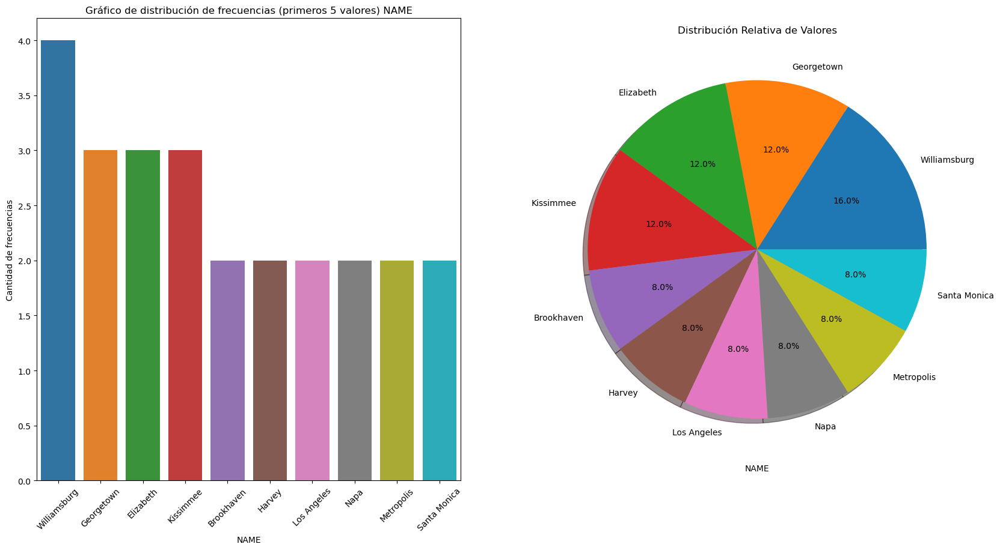



Estadísticas Básicas


count              177
unique             151
top       Williamsburg
freq                 4
Name: NAME, dtype: object
----------------------------------------------------------------------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------------------------------------------------------------------




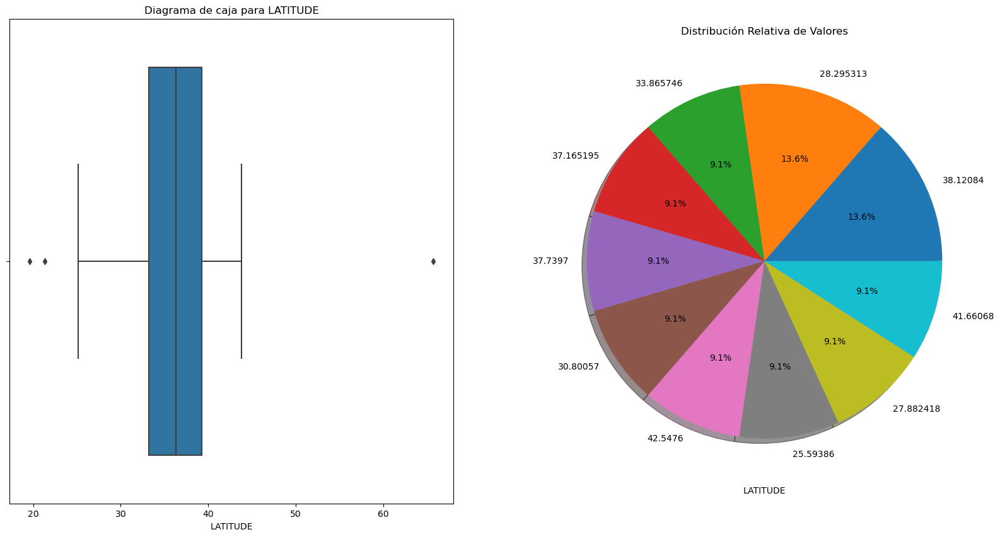



Estadísticas Básicas


count    177.000000
mean      35.972309
std        5.298492
min       19.585493
25%       33.197150
50%       36.283300
75%       39.263430
max       65.741050
Name: LATITUDE, dtype: float64
----------------------------------------------------------------------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------------------------------------------------------------------




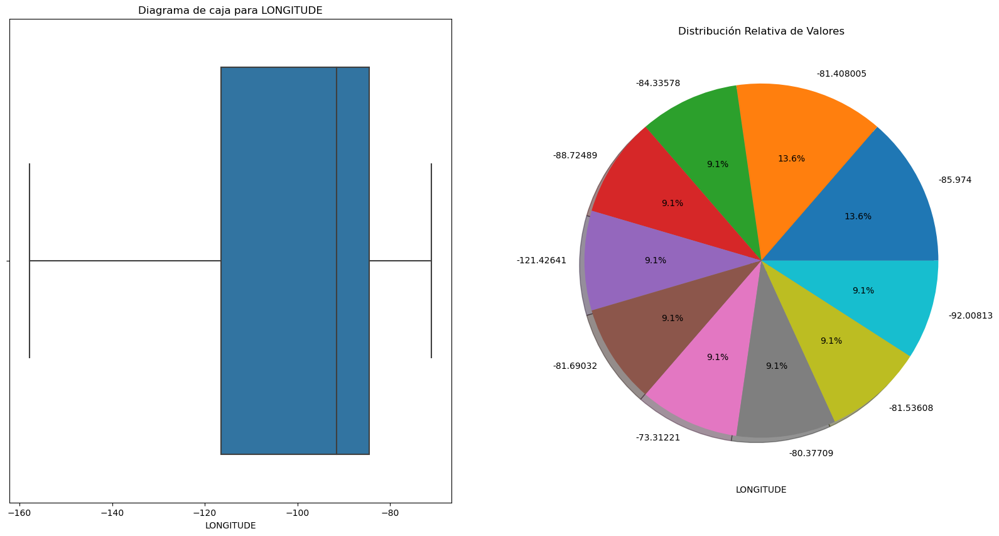



Estadísticas Básicas


count    177.000000
mean     -97.648517
std       17.513356
min     -157.861860
25%     -116.512110
50%      -91.556930
75%      -84.513855
max      -71.004160
Name: LONGITUDE, dtype: float64
----------------------------------------------------------------------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------------------------------------------------------------------




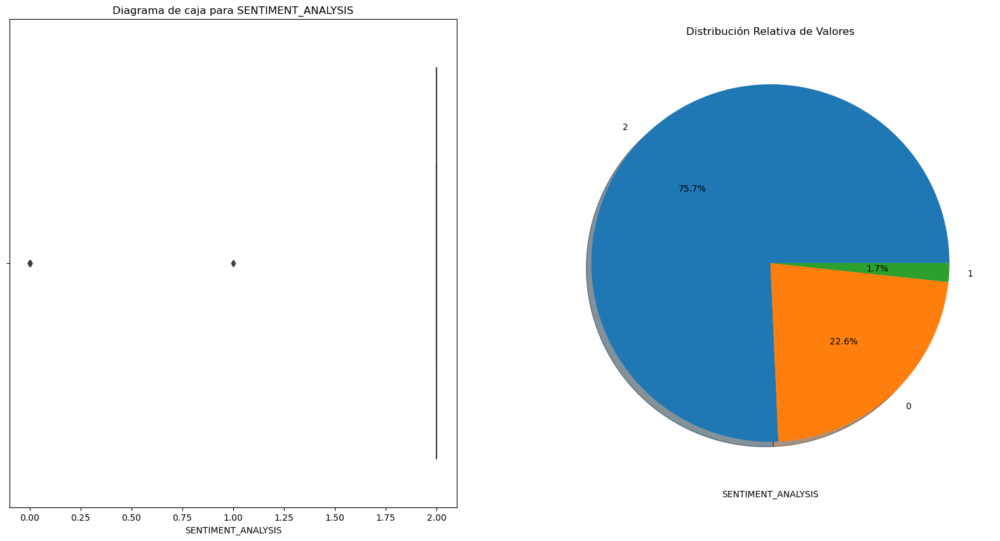



Estadísticas Básicas


count    177.000000
mean       1.531073
std        0.839640
min        0.000000
25%        2.000000
50%        2.000000
75%        2.000000
max        2.000000
Name: SENTIMENT_ANALYSIS, dtype: float64
----------------------------------------------------------------------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------------------------------------------------------------------




In [55]:
descripcion_distribucion(df_TRIP)

# **CENSO**

## _Censo._

### <h2 align= 'center'><u>Análisis general</u></h2>

StatementMeta(, 76ae3ccc-0ff3-43ab-b08b-381e5e4bde92, 57, Finished, Available)

INFORME PRELIMINAR SOBRE CARACTERISTICAS DEL DATASET:

--Dimensiones del DataFrame--
Filas: 1575710
Columnas: 3

--Numero de datos--
4727130

--Filas y Columnas--
Filas: muestra de indices-------> [0, 1, 2, 3, 4]  -----> Desde 0  Hasta 1575709
Columnas: ['METROPOLITAN_STATISTICAL_AREA_SIZE', 'STATE_CODE', 'REGISTRATION_YEAR']

--Tipo de columnas--
METROPOLITAN_STATISTICAL_AREA_SIZE     int64
STATE_CODE                            object
REGISTRATION_YEAR                      int64
dtype: object

--Cantidad de registros duplicados--
1573117

INFORME PRELIMINAR SOBRE LA COLUMNA/FEATURE METROPOLITAN_STATISTICAL_AREA_SIZE:

--Numero de datos nulos--
0

--Valores unicos en la columna--
Ej: [2 3 4 6 5]  -----> Desde 2  Hasta 0

--Estadisticos Principales de la columna--
Media: 3.63
Desviacion Estandar: 2.58
Primer cuartil: 0.0
Mediana: 4.0
Tercer cuartil: 6.0

--Valores extremos--
Valor maximo: 7
Valor minimo: 0

--Distribucion de frecuencias (primeros valores con mayor cantidad de frecuencia

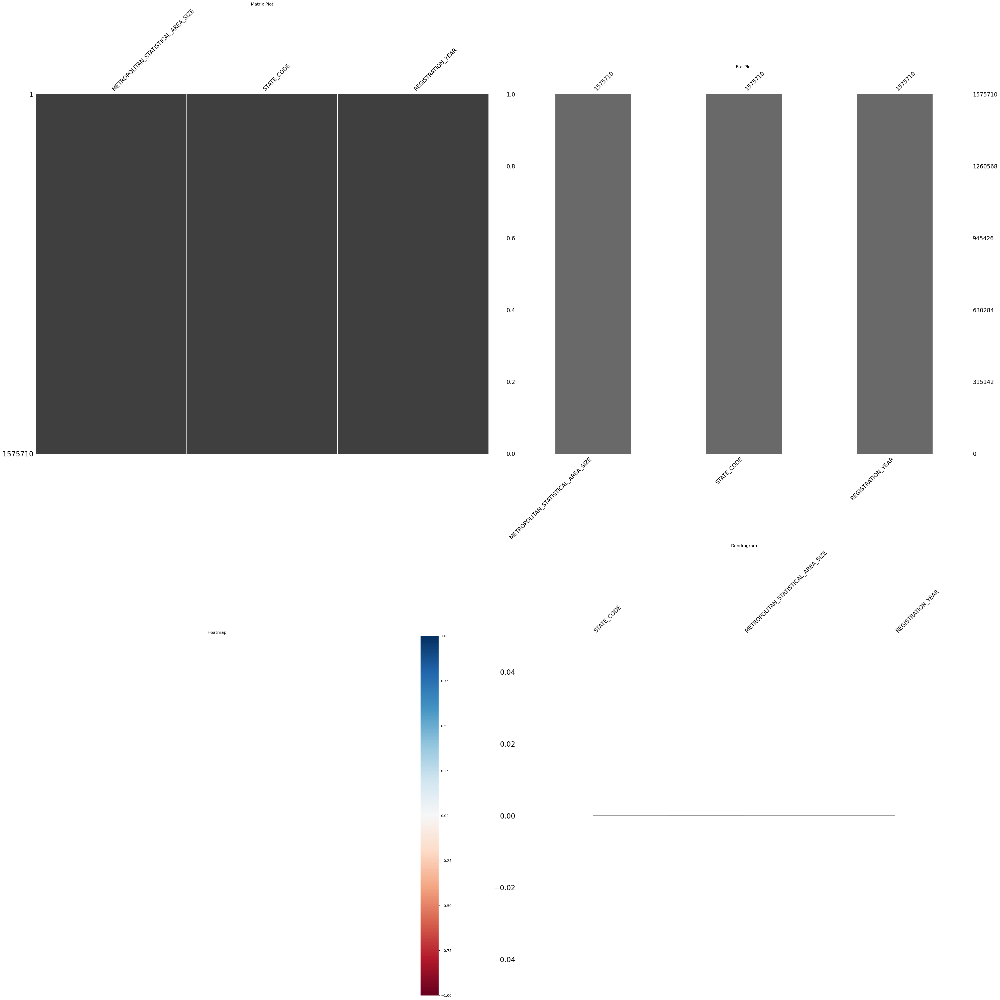

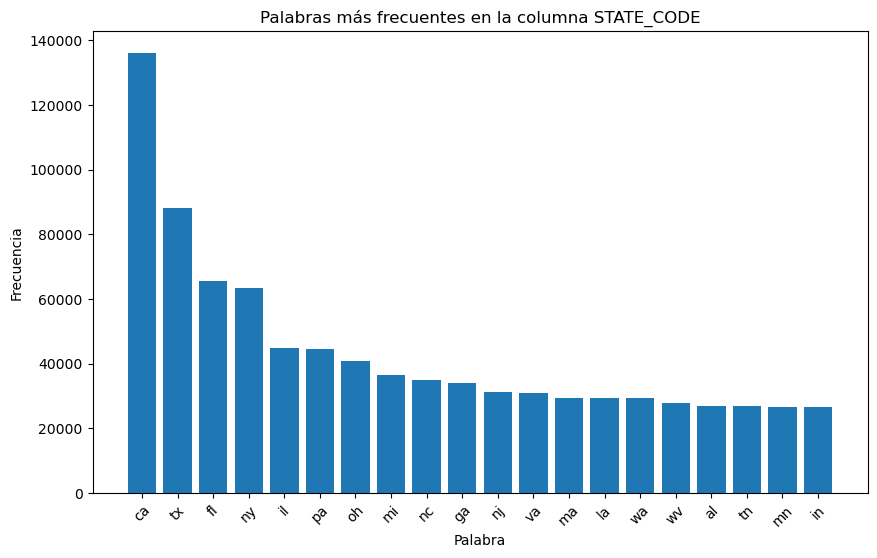

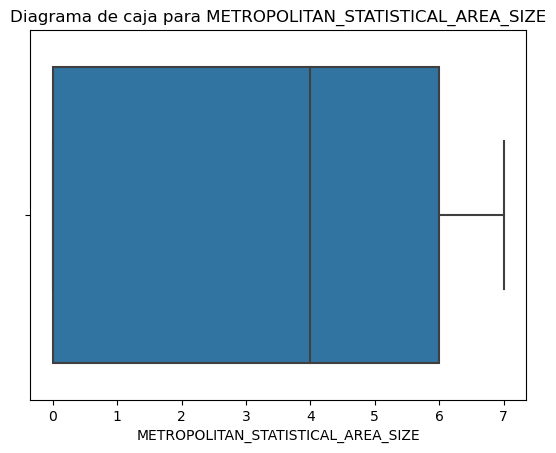

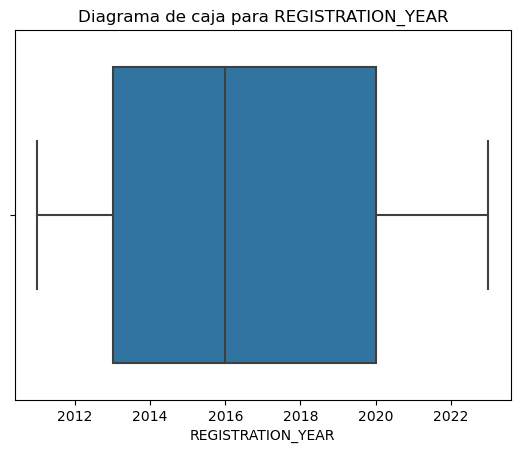

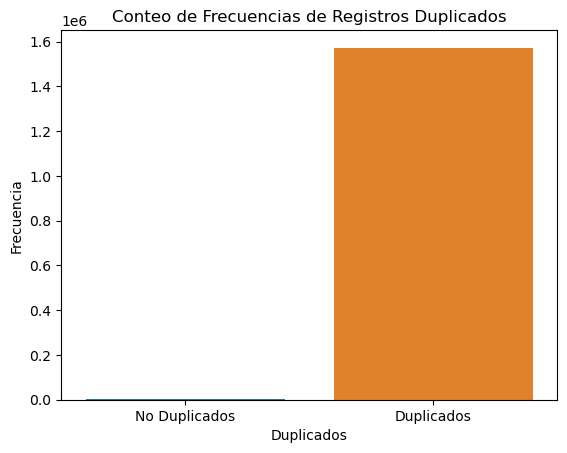

(                         nombre_campo       tipo_datos  no_nulos_%  nulos_%  \
 0  METROPOLITAN_STATISTICAL_AREA_SIZE  [<class 'int'>]       100.0      0.0   
 1                          STATE_CODE  [<class 'str'>]       100.0      0.0   
 2                   REGISTRATION_YEAR  [<class 'int'>]       100.0      0.0   
 
    nulos  
 0      0  
 1      0  
 2      0  ,
 '~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~oo~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~',
 [None, None, None])

In [56]:
informe_general(df_CENSO)

### <h2 align= 'center'><u>Análisis Descriptivo</u></h2>

StatementMeta(, 76ae3ccc-0ff3-43ab-b08b-381e5e4bde92, 58, Finished, Available)

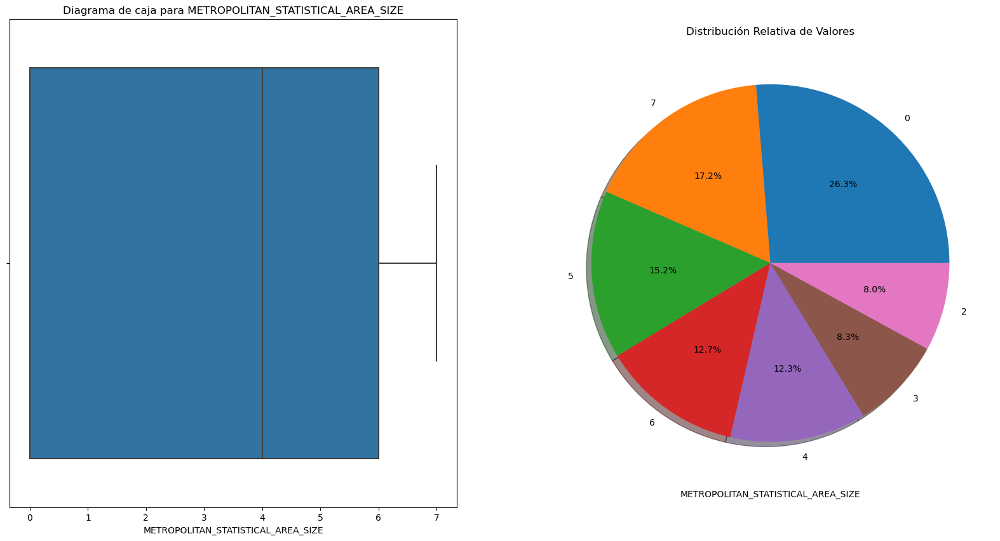



Estadísticas Básicas


count    1.575710e+06
mean     3.627893e+00
std      2.583966e+00
min      0.000000e+00
25%      0.000000e+00
50%      4.000000e+00
75%      6.000000e+00
max      7.000000e+00
Name: METROPOLITAN_STATISTICAL_AREA_SIZE, dtype: float64
----------------------------------------------------------------------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------------------------------------------------------------------




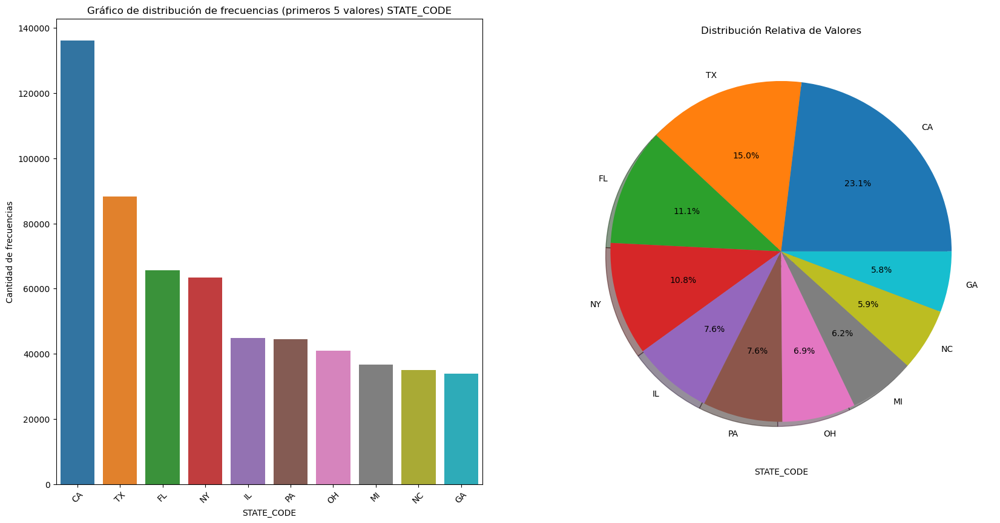



Estadísticas Básicas


count     1575710
unique         51
top            CA
freq       136044
Name: STATE_CODE, dtype: object
----------------------------------------------------------------------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------------------------------------------------------------------




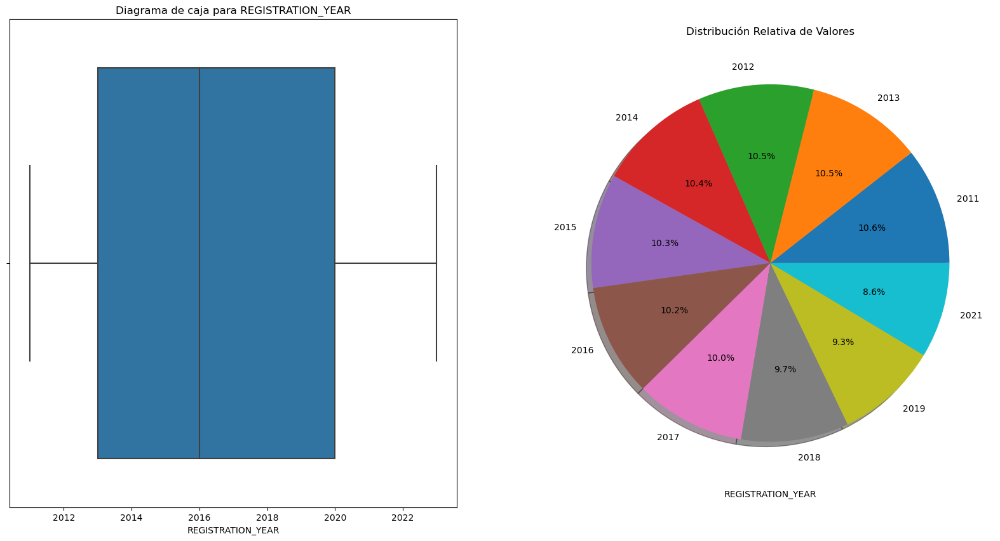



Estadísticas Básicas


count    1.575710e+06
mean     2.016638e+03
std      3.688359e+00
min      2.011000e+03
25%      2.013000e+03
50%      2.016000e+03
75%      2.020000e+03
max      2.023000e+03
Name: REGISTRATION_YEAR, dtype: float64
----------------------------------------------------------------------------------------------------------------------------------------------------------------
----------------------------------------------------------------------------------------------------------------------------------------------------------------




In [57]:
descripcion_distribucion(df_CENSO)

# <h1 align='center'>**ANÁLISIS DE CORRELACIONES DE COLUMNAS**</h1>

StatementMeta(, efb51a3a-4f6c-40b4-9f85-f65390734ff5, 21, Finished, Available)

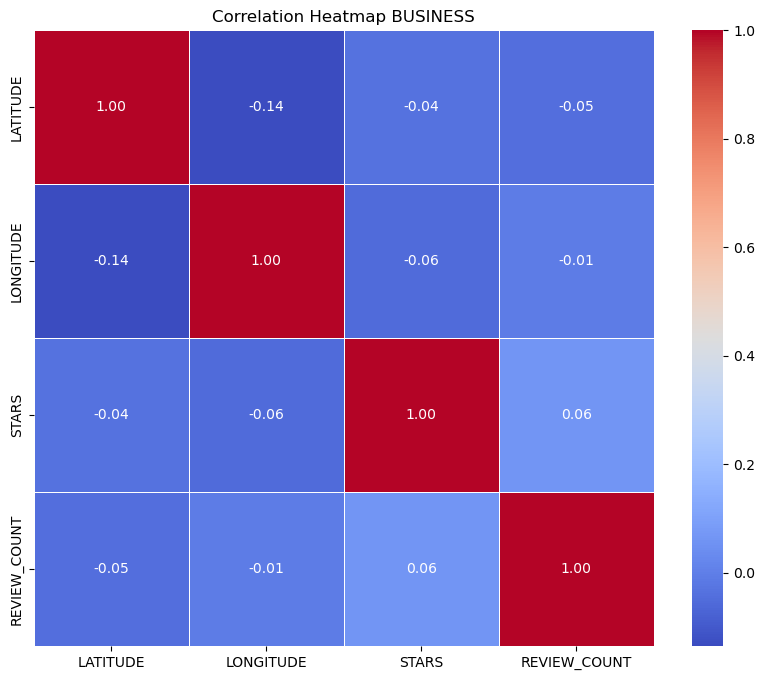

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------


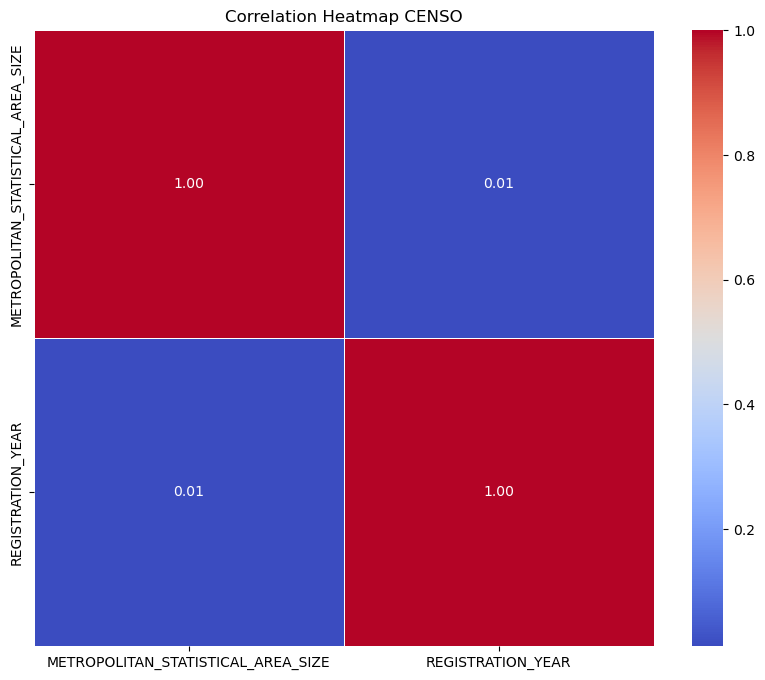

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------


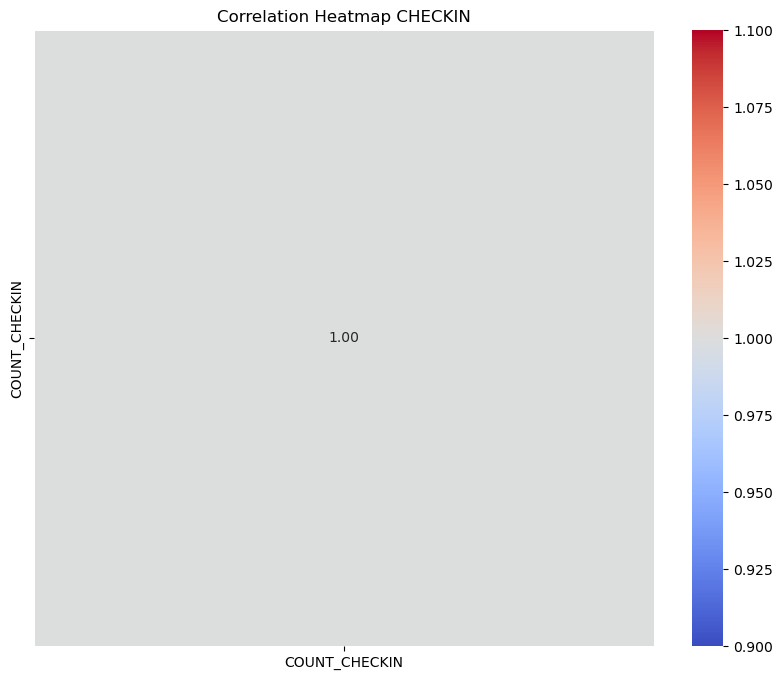

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------


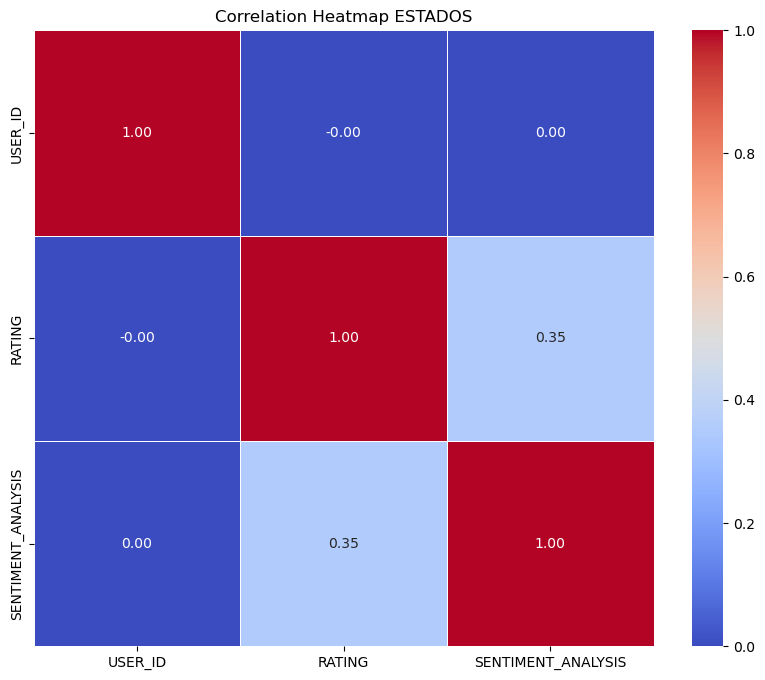

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------


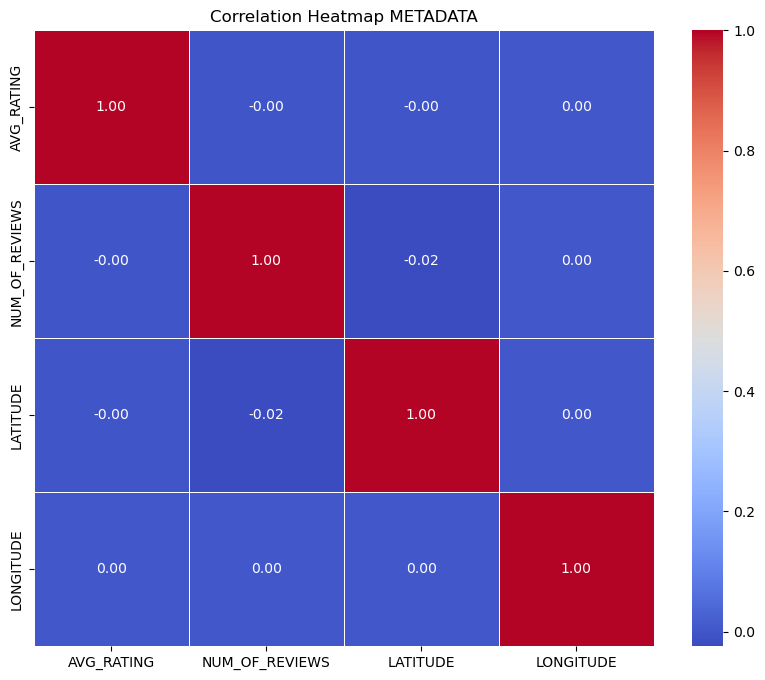

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------


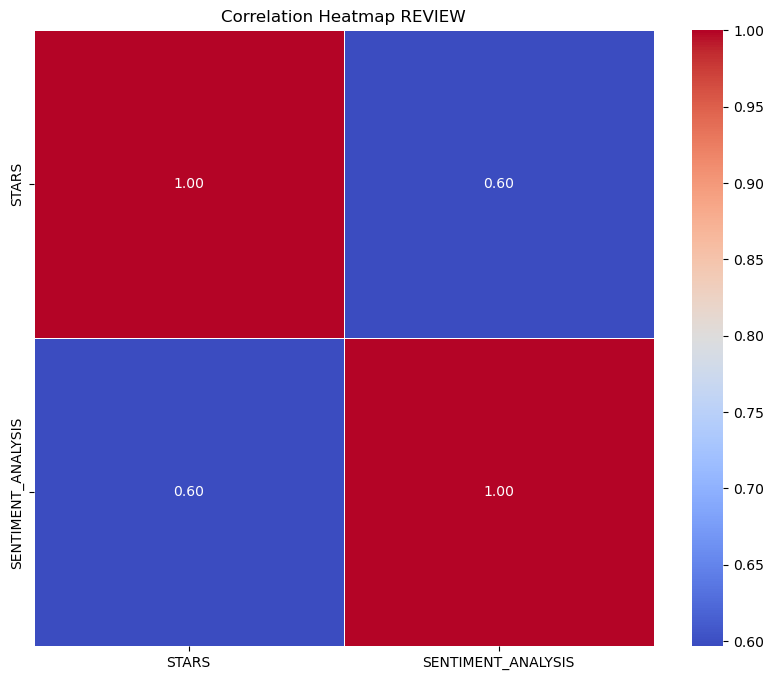

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------


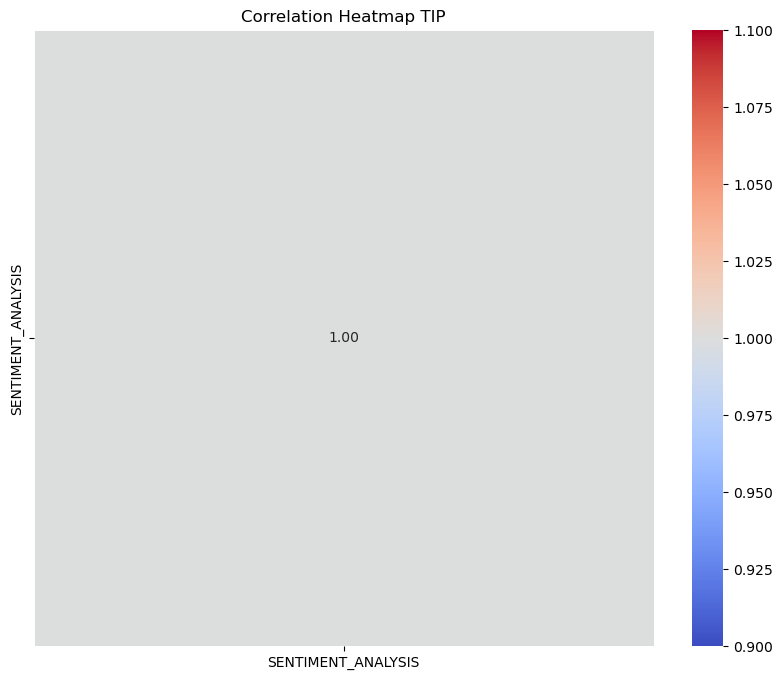

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------


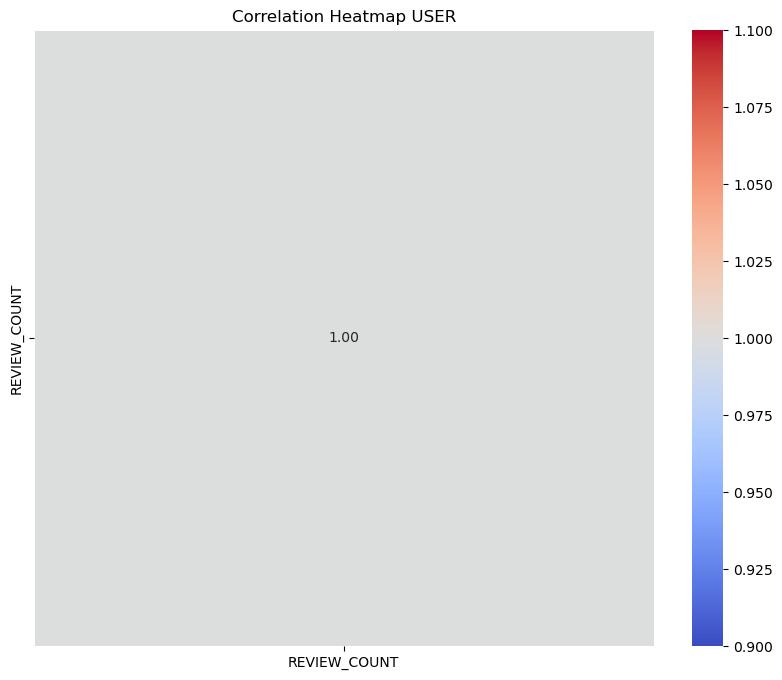

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------


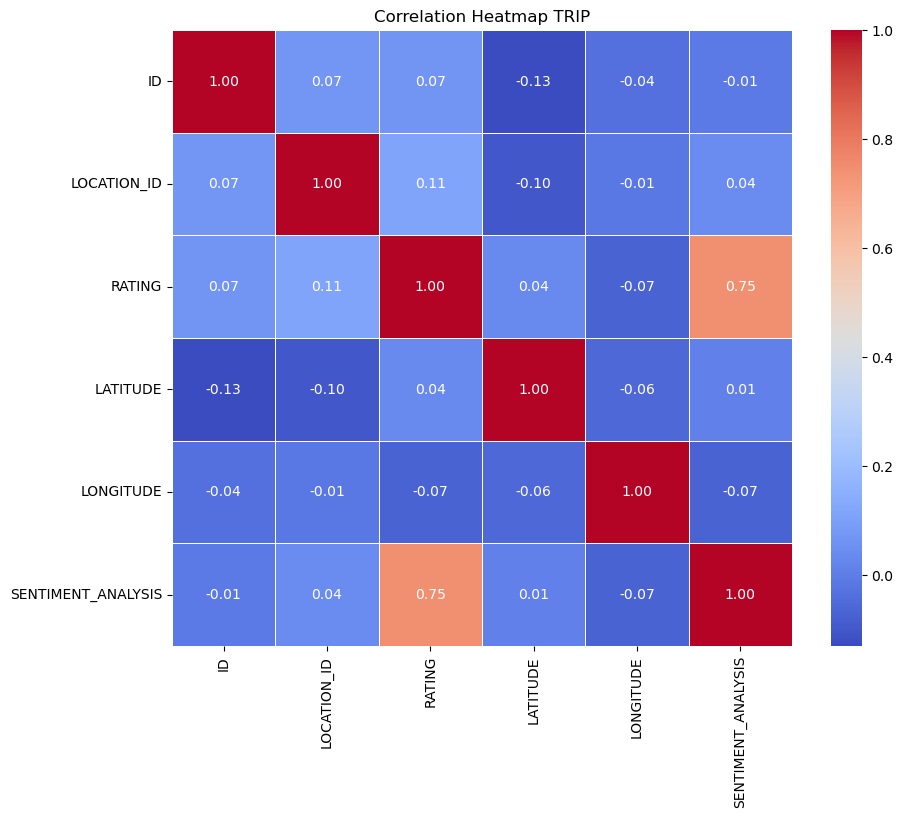

------------------------------------------------------------------------------------------------------------------------
------------------------------------------------------------------------------------------------------------------------


In [19]:
for dataset, titulo in zip(lista_df, etiquetas):
    correlaciones_heatmap(dataset,titulo)

# <h1 align= 'center'>**ANÁLISIS DE INFORMACIÓN BRINDADA POR LOS DATOS**</h>

Partiendo del plan de expansión para el periodo 2024 - 2026 que la cadena hotelera Wyndham Hotels & Resorts tiene en agenda para sus negocios, con el propósito de lograr la expansión de Hoteles de la línea premium, efectuamos la siguiente exploración de los datos para brindar una herramientas de control y análisis de esta inversión, con el fin de que las decisiones sean tomadas de forma informada, basada en datos disponibles y de acceso público.  
Para ello realizaremos preguntas concretas por cada dataset y serán respondidas con datos.


# **YELP**

## _Review._

¿Cuáles son los 10 usuarios que más calificaciones han dado (STARS)?  

StatementMeta(, 0fc8c020-2632-44a0-90e3-b057ca4b9c8e, 30, Finished, Available)

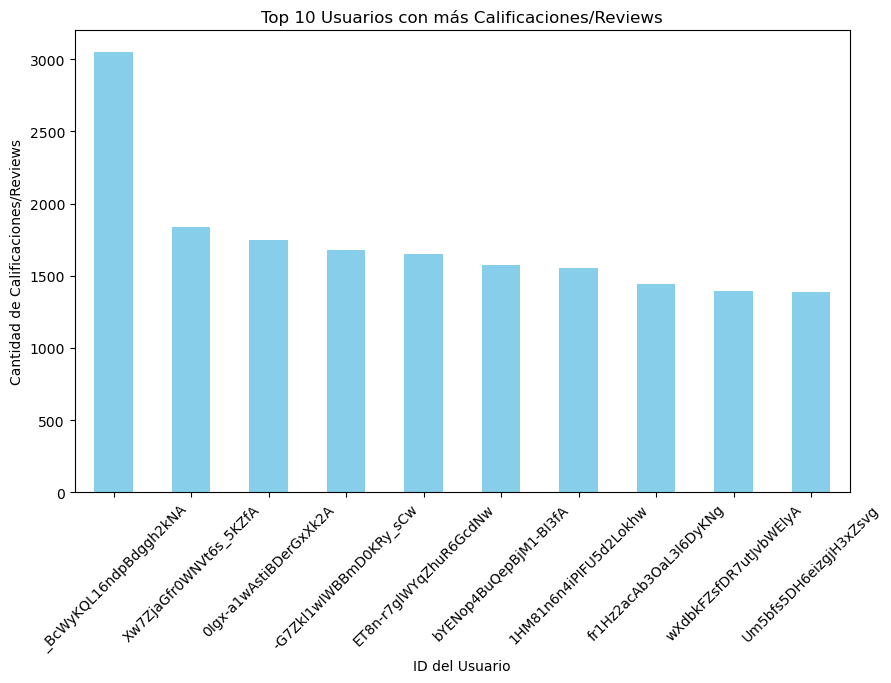

In [28]:
graficar_top_10_usuarios_mas_calificaciones(df_REVIEW)

¿Cómo varía la distribución de calificaciones a lo largo del tiempo (DATE)? 

StatementMeta(, 45d13fc6-0dfb-4230-afaf-7fe626b0c78f, 28, Finished, Available)

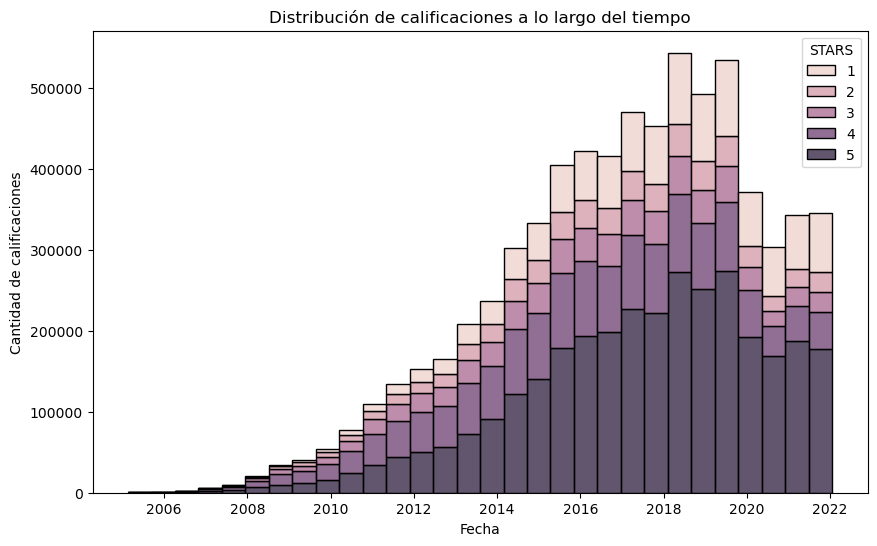

In [26]:
distribucion_calificaciones_por_fecha(df_REVIEW)

¿Qué tendencia muestra el análisis de sentimiento en relación con las calificaciones?  

StatementMeta(, 45d13fc6-0dfb-4230-afaf-7fe626b0c78f, 29, Finished, Available)

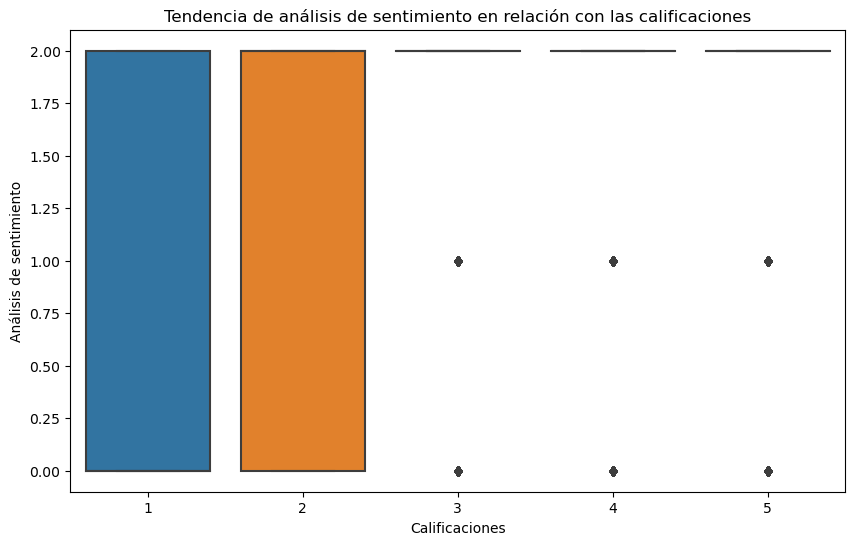

In [27]:
tendencia_sentimiento_y_calificaciones(df_REVIEW)

¿Cuál es la tendencia de las calificaciones (STARS) a lo largo del tiempo (DATE)?  

StatementMeta(, 45d13fc6-0dfb-4230-afaf-7fe626b0c78f, 30, Finished, Available)

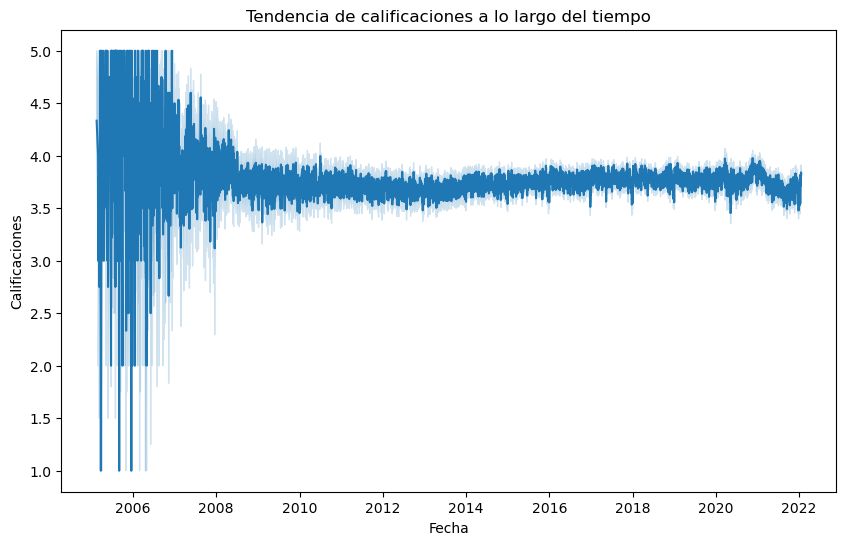

In [28]:
tendencia_calificaciones_por_fecha(df_REVIEW)

¿Existe alguna correlación entre la longitud de las revisiones y el análisis de sentimiento?  

StatementMeta(, 56897517-a7cc-497e-83d8-af77e7a5c3c4, 32, Finished, Available)

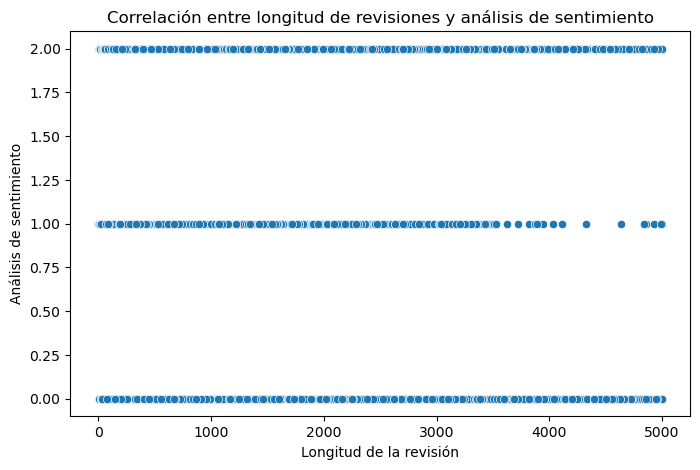

In [30]:
correlacion_longitud_sentimiento(df_REVIEW)


¿Hay algún patrón en el análisis de sentimiento de las revisiones en función de la ubicación geográfica del usuario?  

StatementMeta(, 56897517-a7cc-497e-83d8-af77e7a5c3c4, 47, Finished, Available)

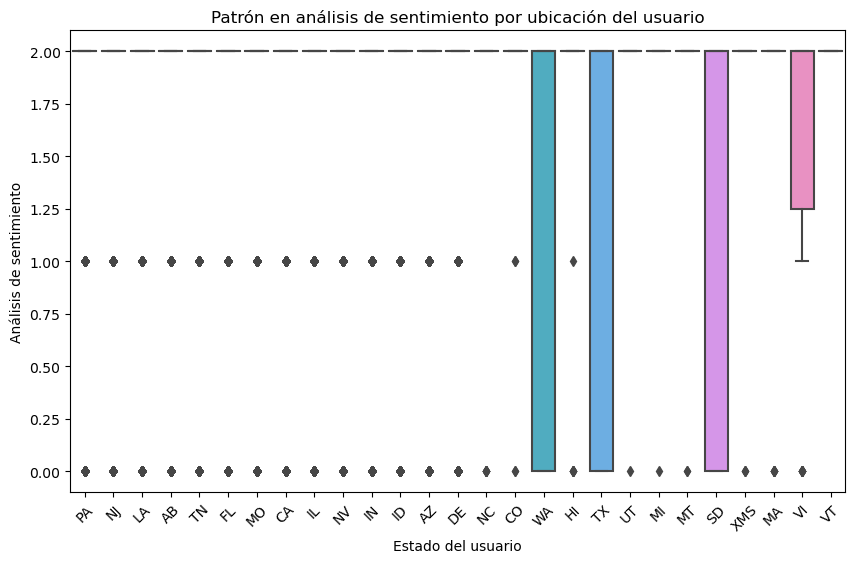

In [45]:
patron_sentimiento_por_ubicacion(df_REVIEW, df_BUSINESS)

¿Hay algún patrón en el análisis de sentimiento de las reseñas de hoteles en función de la ubicación geográfica del usuario?



StatementMeta(, d6ece8bd-9308-4148-b1c8-7a3d5b1fc8e9, 24, Finished, Available)

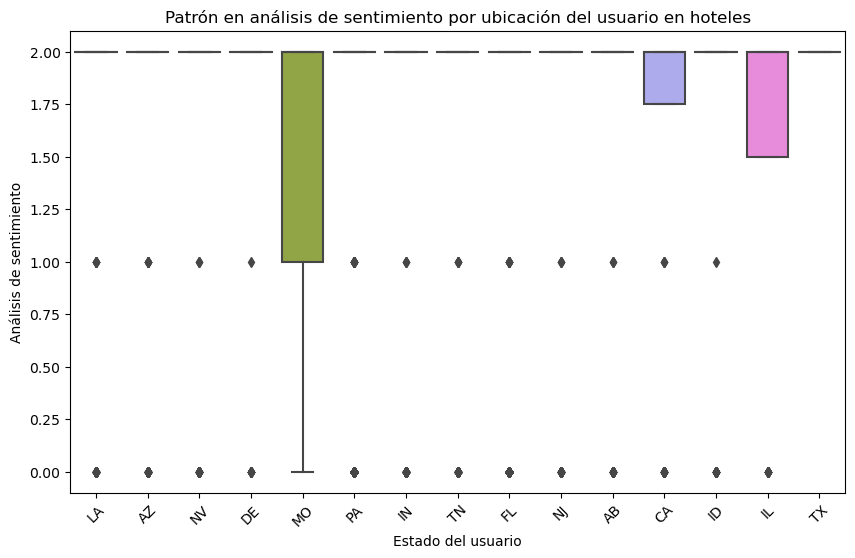

In [22]:
patron_sentimiento_por_ubicacion_hoteles(df_REVIEW, df_BUSINESS)


Estas preguntas ayudan a identificar a los usuarios más activos en términos de calificaciones, explorar cualquier tendencia temporal en la distribución de calificaciones y entender cómo se relaciona el análisis de sentimientos con las calificaciones dadas por los usuarios.

## _User._

¿Cuáles son los 10 usuarios con mayor cantidad de revisiones (REVIEW_COUNT)?

StatementMeta(, 0fc8c020-2632-44a0-90e3-b057ca4b9c8e, 32, Finished, Available)

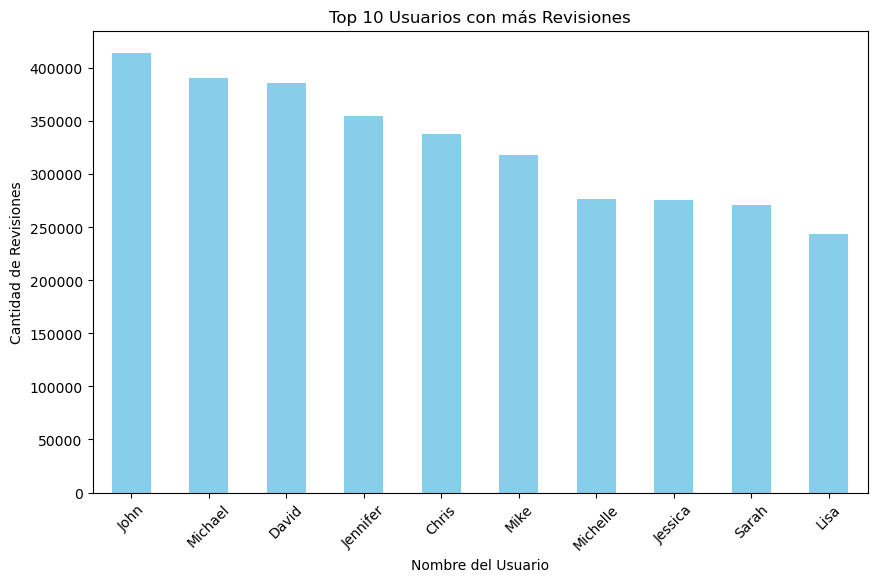

In [30]:
graficar_top_10_usuarios_con_mas_revisiones(df_USER)


¿Cuál es la distribución de la cantidad de revisiones por usuario?  

StatementMeta(, 45d13fc6-0dfb-4230-afaf-7fe626b0c78f, 33, Finished, Available)

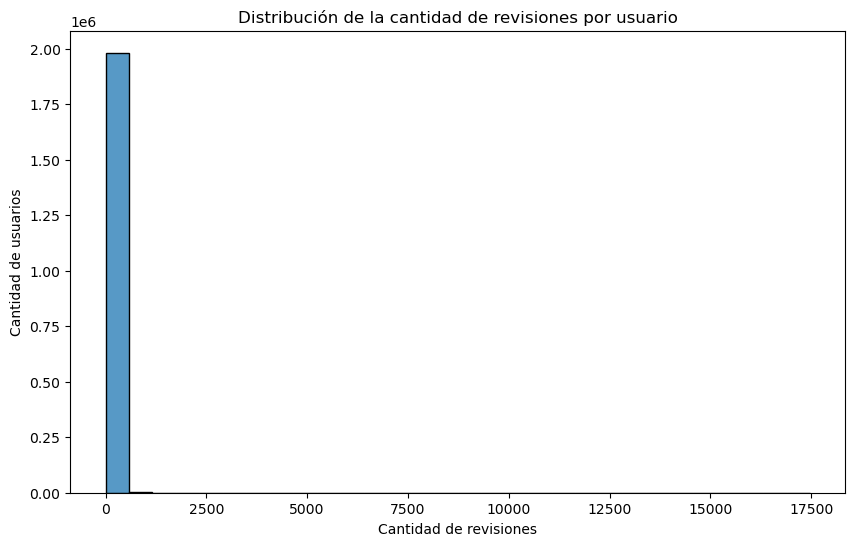

In [31]:
distribucion_revisiones_por_usuario(df_USER)

¿Hay alguna relación entre el nombre del usuario y la cantidad de revisiones que realiza?  

StatementMeta(, d6ece8bd-9308-4148-b1c8-7a3d5b1fc8e9, 36, Finished, Available)

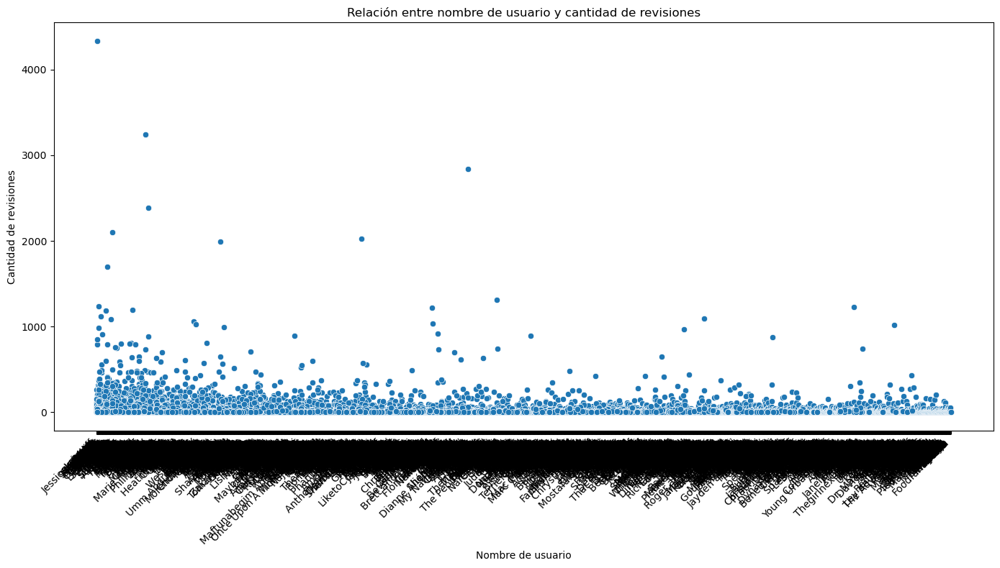

In [34]:
relacion_nombre_revisiones_mejorado(df_USER)

Estas preguntas permite identificar a los usuarios más activos, comprender la distribución de la cantidad de revisiones por usuario y explorar posibles patrones entre el nombre del usuario y su actividad de revisión.

## _Tip._

¿Cuáles son los 10 negocios que más consejos (TIPS) han recibido? 

In [41]:
negocio_con_mas_consejos(df_TIP, df_BUSINESS)

StatementMeta(, d6ece8bd-9308-4148-b1c8-7a3d5b1fc8e9, 43, Finished, Available)

,Business ID,Nombre del negocio,Cantidad de consejos
1,FEXhWNCMkv22qG04E83Qjg,Café Du Monde,2571
2,-QI8Qi8XWH3D8y8ethnajA,Philadelphia International Airport - PHL,1010
3,_ab50qdWOk0DdB6XOrBitw,Acme Oyster House,932
4,ytynqOUb3hjKeJfRj5Tshw,Reading Terminal Market,827
5,Eb1XmmLWyt_way5NNZ7-Pw,Louis Armstrong New Orleans International Airp...,825
6,c_4c5rJECZSfNgFj7frwHQ,Tampa International Airport,749
7,ac1AeYqs8Z4_e2X5M3if2A,Oceana Grill,612
8,GBTPC53ZrG1ZBY3DT8Mbcw,Luke,608
9,iSRTaT9WngzB8JJ2YKJUig,Mother's Restaurant,606
10,GXFMD0Z4jEVZBCsbPf4CTQ,Hattie B’s Hot Chicken - Nashville,579


StatementMeta(, d6ece8bd-9308-4148-b1c8-7a3d5b1fc8e9, 50, Finished, Available)

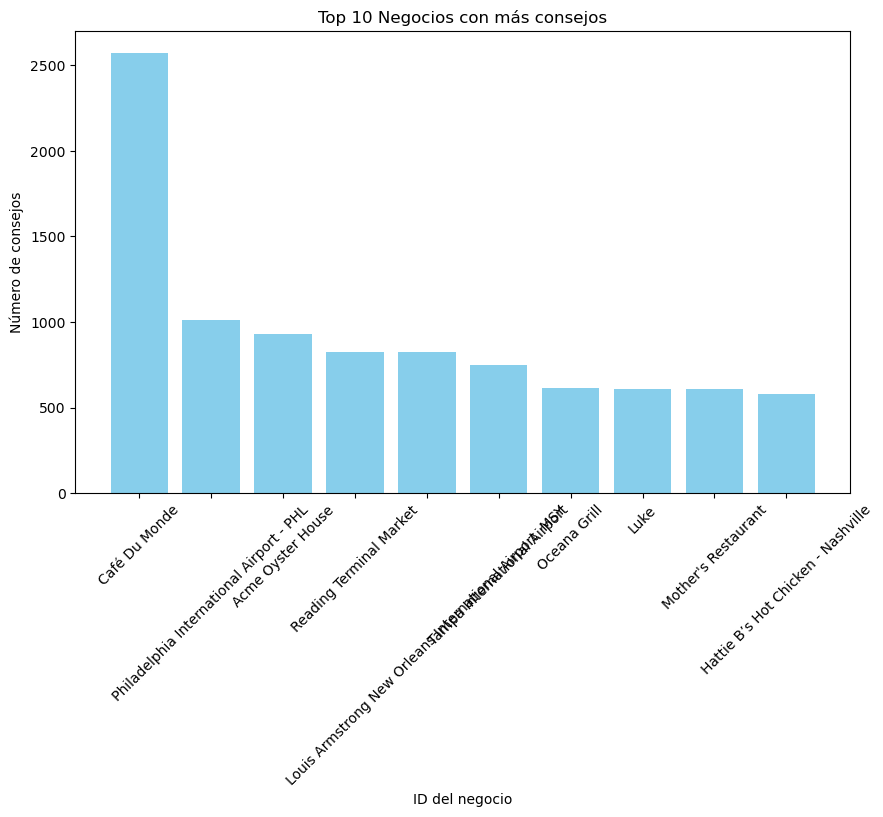

In [48]:
graficar_top_negocios_consejos(df_TIP, df_BUSINESS)

¿Cómo varía la cantidad de consejos en función de la fecha (DATE)?  

StatementMeta(, 45d13fc6-0dfb-4230-afaf-7fe626b0c78f, 36, Finished, Available)

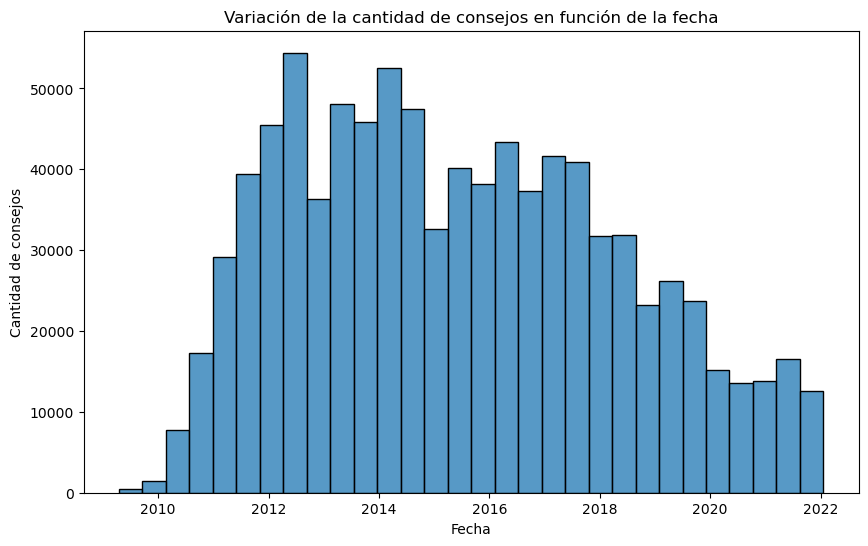

In [34]:
variacion_consejos_por_fecha(df_TIP)

¿Hay alguna relación entre la cantidad de consejos y la ubicación del negocio? 

StatementMeta(, d6ece8bd-9308-4148-b1c8-7a3d5b1fc8e9, 34, Finished, Available)

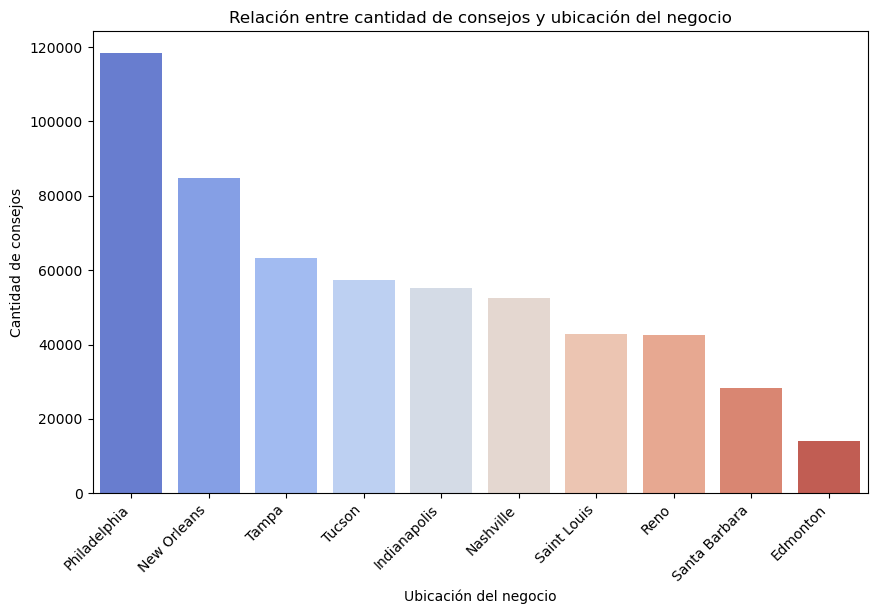

In [32]:
relacion_consejos_ubicacion(df_TIP, df_BUSINESS)

Estas preguntas permiten identificar los negocios más populares en términos de consejos recibidos, explorar cualquier tendencia temporal en la cantidad de consejos y entender si la ubicación del negocio influye en la cantidad de consejos recibidos.

## _Business._

¿Cuáles son las 10 ciudades con la mayor cantidad de negocios (BUSINESS_ID) y hoteles?   

In [51]:
top_ciudades_negocios = ciudad_con_mas_negocios(df_BUSINESS)
top_ciudades_hoteles = ciudades_con_mas_hoteles(df_BUSINESS)
print("Top 10 ciudades con más negocios:")
print(top_ciudades_negocios)
print("\nTop 10 ciudades con más hoteles:")
print(top_ciudades_hoteles)


StatementMeta(, d6ece8bd-9308-4148-b1c8-7a3d5b1fc8e9, 53, Finished, Available)

Top 10 ciudades con más negocios:
CITY
Philadelphia     14551
Tucson            9241
Tampa             9041
Indianapolis      7521
Nashville         6968
New Orleans       6192
Reno              5922
Edmonton          5051
Saint Louis       4818
Santa Barbara     3826
Name: count, dtype: int64

Top 10 ciudades con más hoteles:
CITY
New Orleans      620
Nashville        460
Philadelphia     393
Tampa            387
Indianapolis     344
Tucson           343
Santa Barbara    258
Reno             204
Saint Louis      197
Clearwater       131
Name: count, dtype: int64


StatementMeta(, d6ece8bd-9308-4148-b1c8-7a3d5b1fc8e9, 55, Finished, Available)

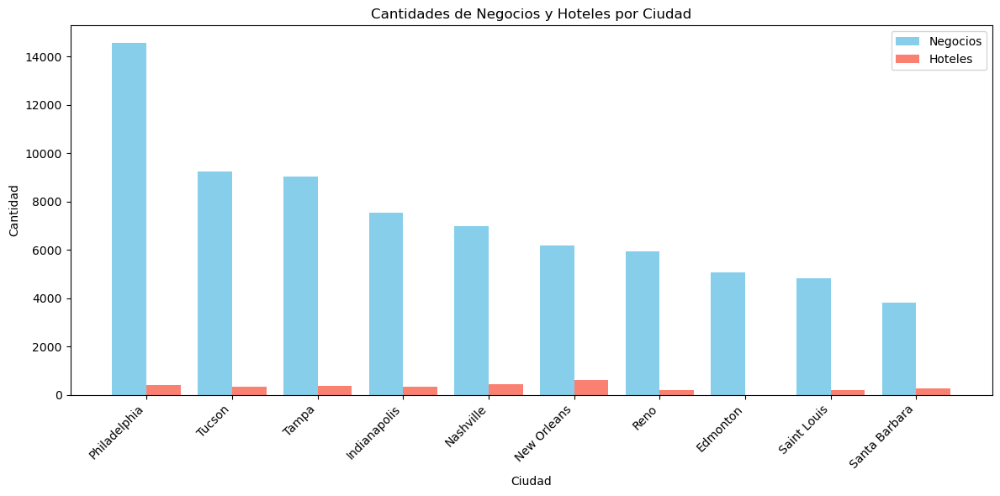

In [53]:
graficar_ciudades(df_BUSINESS)

  
¿Cuál es la distribución de las calificaciones (STARS) de los negocios?  


StatementMeta(, 45d13fc6-0dfb-4230-afaf-7fe626b0c78f, 39, Finished, Available)

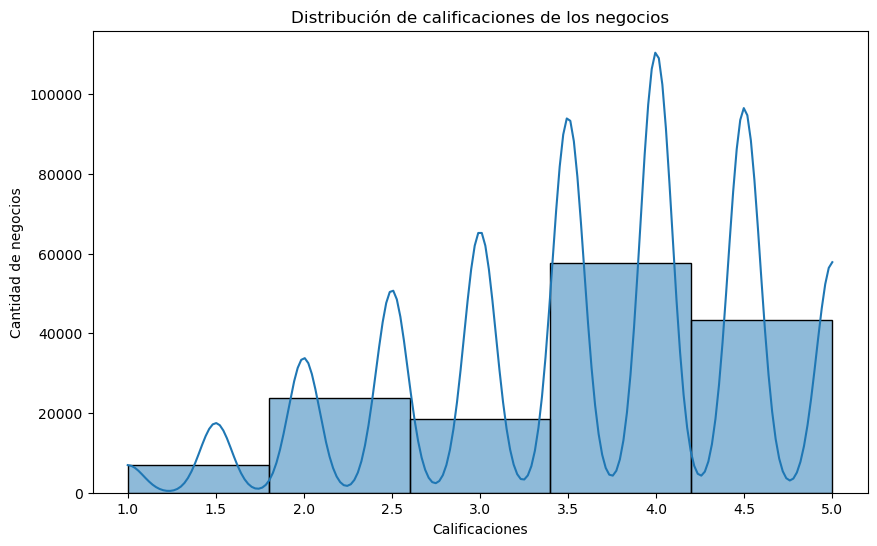

In [37]:
distribucion_calificaciones_negocios(df_BUSINESS)

¿Qué categoría (CATEGORIES) tiene la mayor cantidad de negocios?  


StatementMeta(, d6ece8bd-9308-4148-b1c8-7a3d5b1fc8e9, 63, Finished, Available)

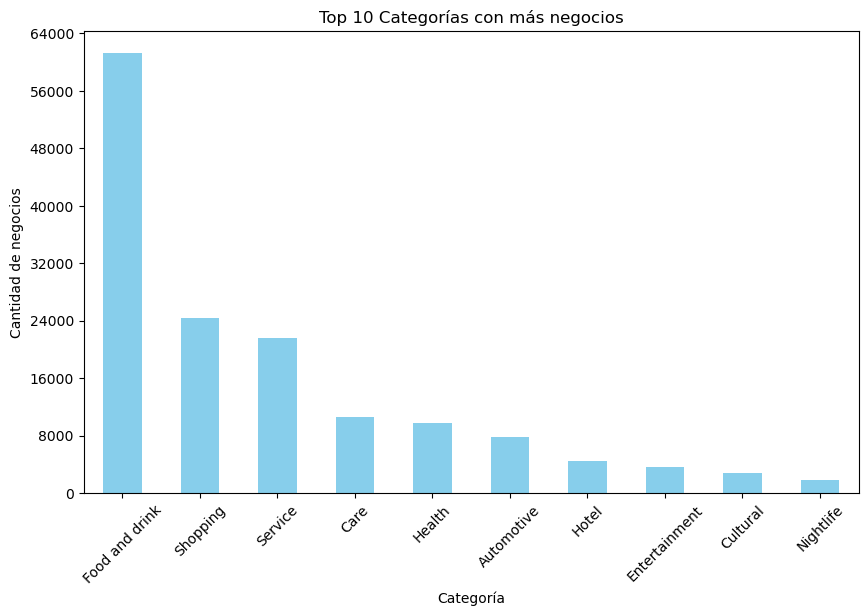

In [61]:
graficar_categorias_con_mas_negocios(df_BUSINESS)

¿Hay alguna correlación entre la cantidad de revisiones (REVIEW_COUNT) y la calificación del negocio (STARS)?  


StatementMeta(, 45d13fc6-0dfb-4230-afaf-7fe626b0c78f, 52, Finished, Available)

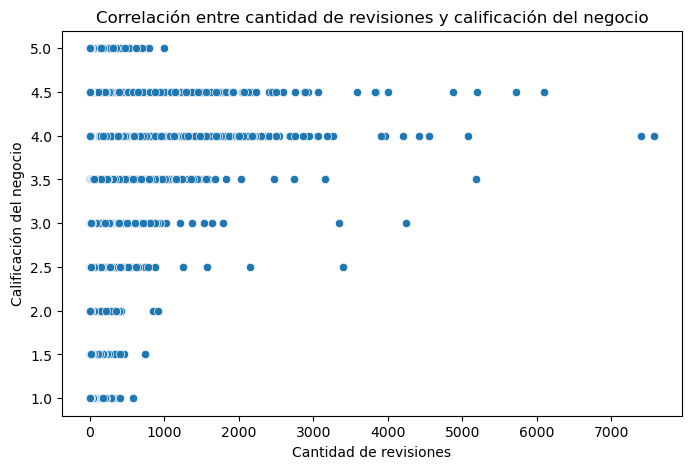

In [50]:
correlacion_revisiones_calificacion(df_BUSINESS)

¿Cómo varía el análisis de sentimiento de las revisiones en función de las categorías (CATEGORIES) del negocio?  


StatementMeta(, d6ece8bd-9308-4148-b1c8-7a3d5b1fc8e9, 71, Finished, Available)

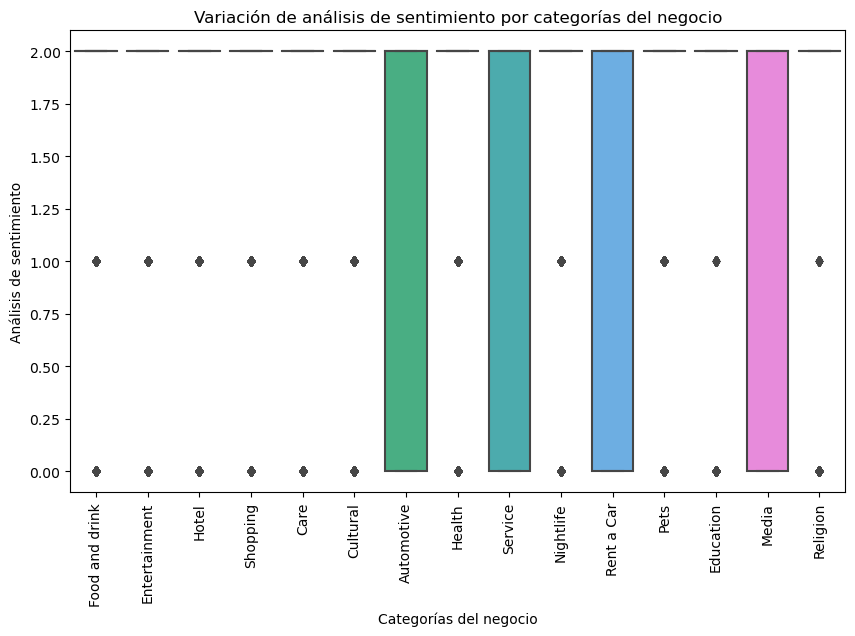

In [69]:
variacion_sentimiento_por_categorias(df_REVIEW, df_BUSINESS)

¿Qué categoría de negocio tiene la calificación promedio más alta y cuál tiene la más baja?

StatementMeta(, d6ece8bd-9308-4148-b1c8-7a3d5b1fc8e9, 69, Finished, Available)

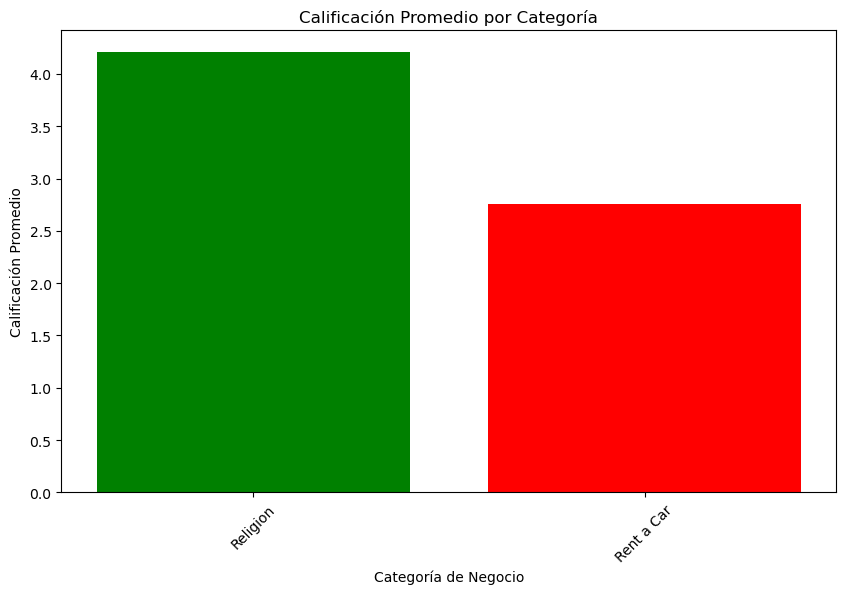

In [67]:
graficar_calificacion_promedio_por_categoria(df_BUSINESS)


Estas preguntas ayudan a identificar las ciudades más activas en términos de negocios, comprender la distribución de las calificaciones de los negocios y explorar las categorías más comunes de los negocios.


## _Checkin._

¿Cuáles son los 10 negocios con la mayor cantidad de check-ins (COUNT_CHECKIN)? 

StatementMeta(, d6ece8bd-9308-4148-b1c8-7a3d5b1fc8e9, 76, Finished, Available)

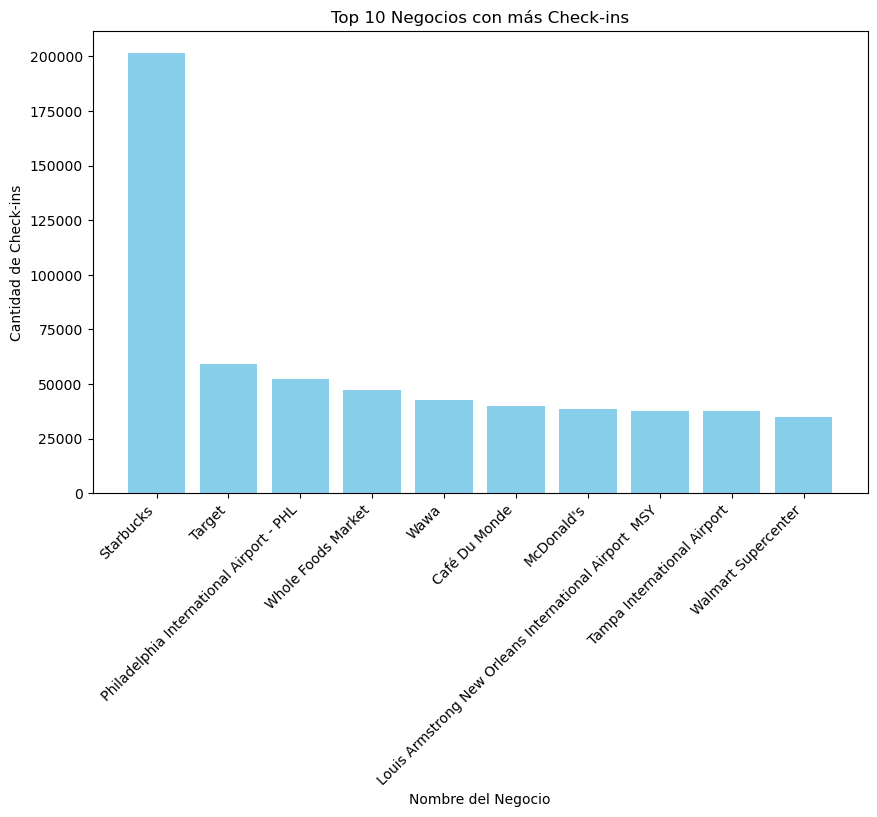

In [74]:
graficar_top_10_negocios_con_mas_checkins(df_CHECKIN, df_BUSINESS)

¿Cómo varía la cantidad de check-ins en función de la fecha (DATE), por mes y año?  

StatementMeta(, 0fc8c020-2632-44a0-90e3-b057ca4b9c8e, 42, Finished, Available)

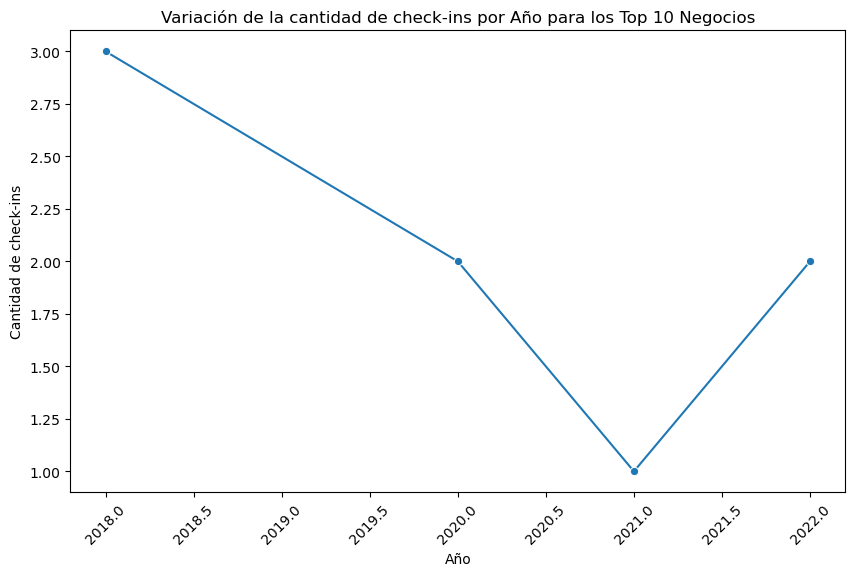

In [40]:
variacion_checkins_por_anio_top_10_negocios(df_CHECKIN, df_BUSINESS)

¿Hay alguna relación entre la cantidad de check-ins y la ubicación del negocio (LATITUDE y LONGITUDE)?  

StatementMeta(, 45d13fc6-0dfb-4230-afaf-7fe626b0c78f, 48, Finished, Available)

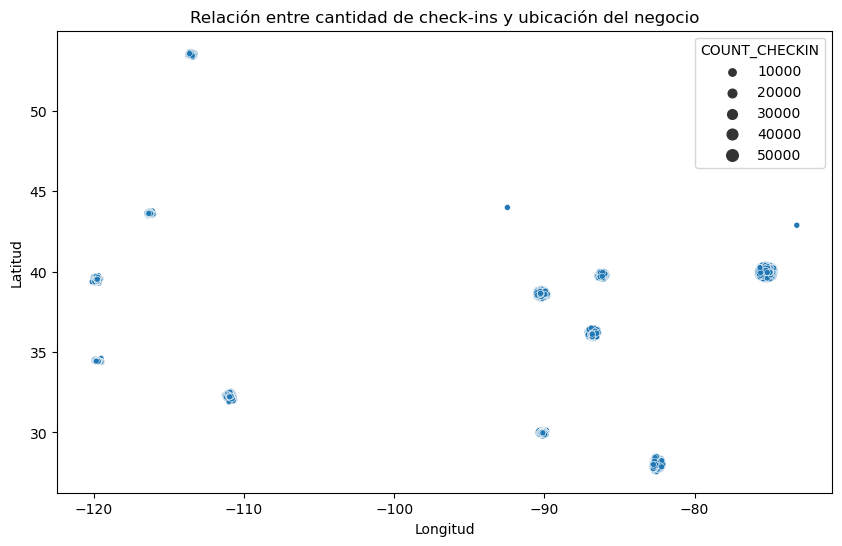

In [46]:
relacion_checkins_ubicacion(df_CHECKIN, df_BUSINESS)

Estas preguntas ayudan a identificar los negocios más populares en términos de check-ins, explorar cualquier tendencia en la cantidad de check-ins a lo largo del tiempo y entender si la ubicación del negocio influye en la cantidad de check-ins.

# **GOOGLE**

## _Metadata._

¿Cuáles son los 10 negocios con el promedio de calificación más alto (AVG_RATING)? 

StatementMeta(, 0fc8c020-2632-44a0-90e3-b057ca4b9c8e, 44, Finished, Available)

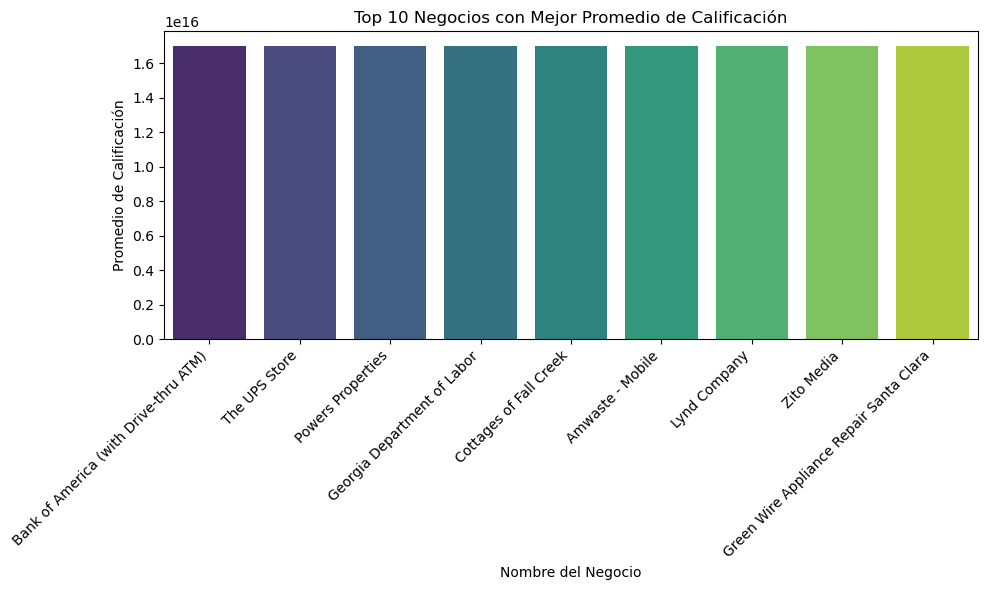

In [42]:
graficar_top_10_negocios_con_mejor_promedio_calificacion(df_METADATA)


¿Cuáles son el top 10 hoteles con mejor promedio de calificación?

StatementMeta(, 0fc8c020-2632-44a0-90e3-b057ca4b9c8e, 91, Finished, Available)

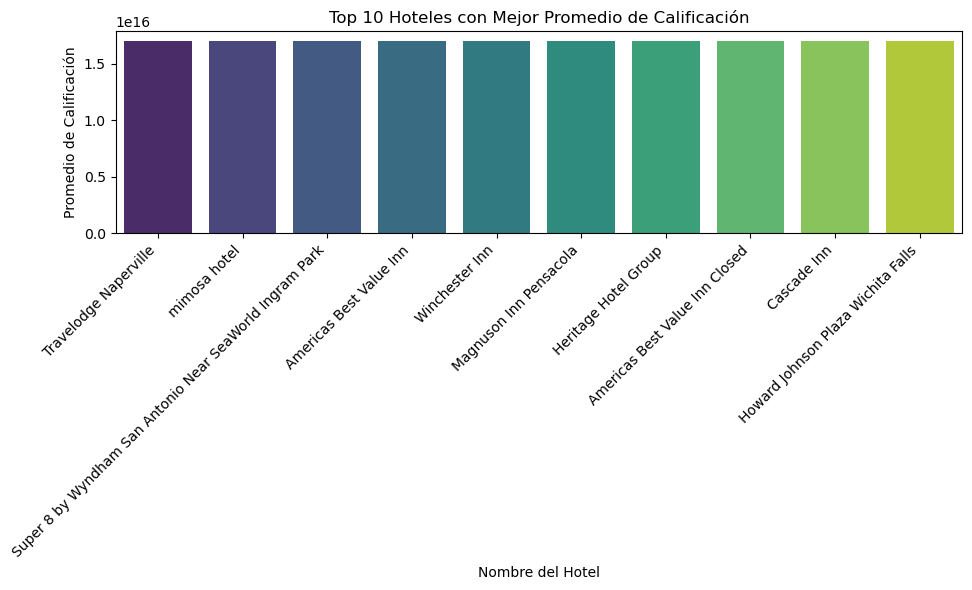

In [89]:
graficar_top_10_hoteles_con_mejor_promedio_calificacion(df_METADATA)

¿Cuáles son las 10 categorias (CATEGORY SUMMARY) con la mayor cantidad de negocios?  

StatementMeta(, 0fc8c020-2632-44a0-90e3-b057ca4b9c8e, 47, Finished, Available)

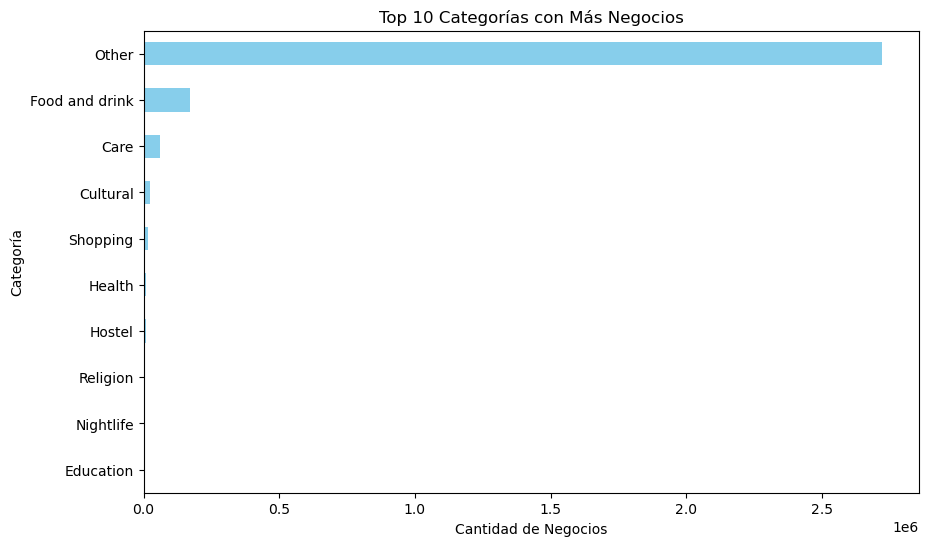

In [45]:
graficar_top_10_categorias_con_mas_negocios(df_METADATA)

¿Cuál es la relación entre el top 10 de negocios y su ubicación geográfica (LATITUDE y LONGITUDE)?

StatementMeta(, 0fc8c020-2632-44a0-90e3-b057ca4b9c8e, 101, Finished, Available)

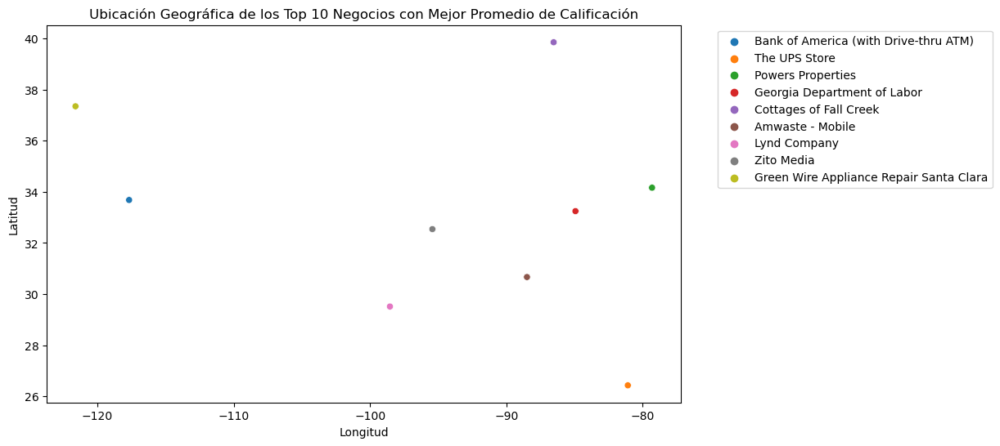

In [99]:
graficar_ubicacion_top_10_negocios(df_METADATA)

¿Cuál es la relación entre el top 10 de hoteles y su ubicación geográfica (LATITUDE y LONGITUDE)?


In [42]:
graficar_ubicacion_top_10_hoteles(df_METADATA)

StatementMeta(, d12ee513-017a-48d4-bd42-d273b59548d3, 42, Finished, Available)

No se encontraron hoteles en el conjunto de datos.
No se encontraron hoteles en el conjunto de datos.


¿Cuál es la distribución de las calificaciones promedio (AVG_RATING) para cada categoría (CATEGORY) de negocio?  

StatementMeta(, 0fc8c020-2632-44a0-90e3-b057ca4b9c8e, 62, Finished, Available)

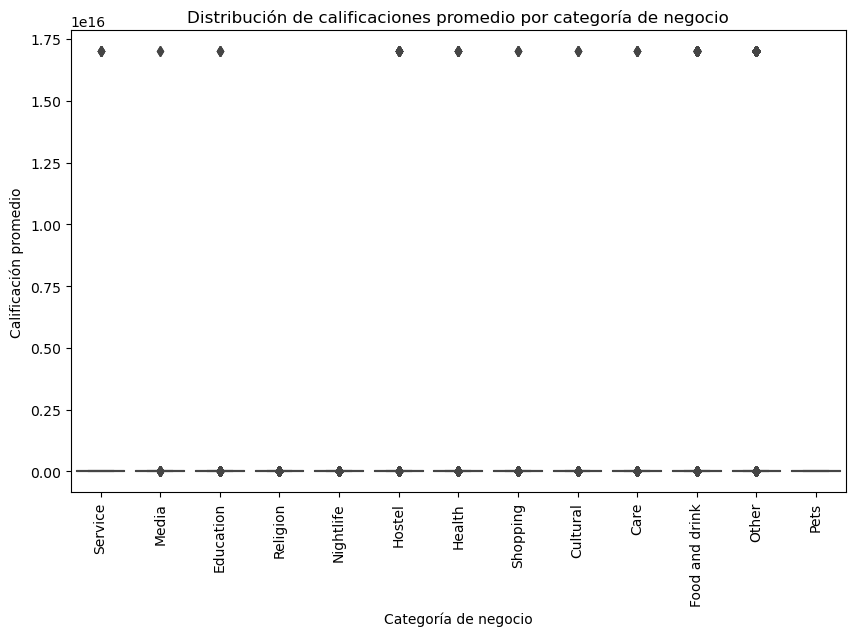

In [60]:
distribucion_calificaciones_por_categoria(df_METADATA)


¿Existe alguna relación entre la ubicación geográfica (LATITUDE y LONGITUDE) y la calificación promedio de los negocios?

StatementMeta(, 45d13fc6-0dfb-4230-afaf-7fe626b0c78f, 60, Finished, Available)

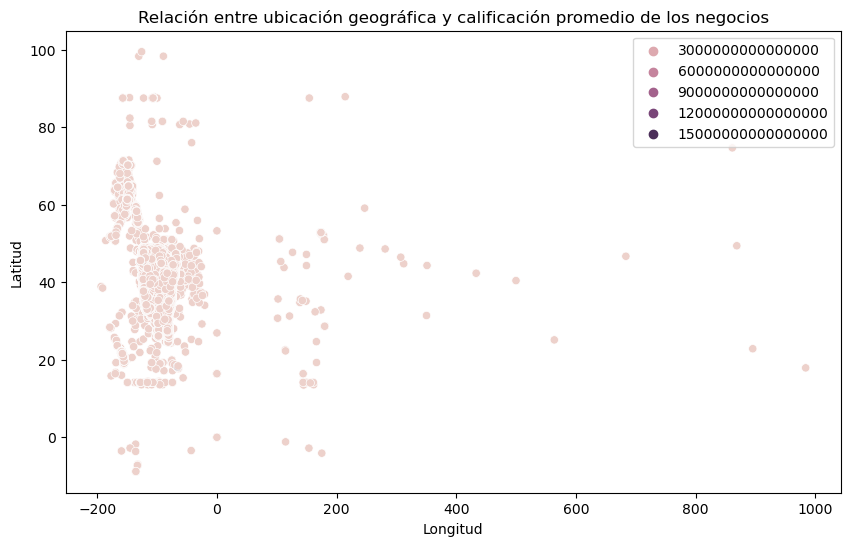

In [58]:
relacion_ubicacion_calificacion(df_METADATA)

¿Cómo varía el análisis de sentimiento en función de la categoría del negocio?  


StatementMeta(, 0fc8c020-2632-44a0-90e3-b057ca4b9c8e, 74, Finished, Available)

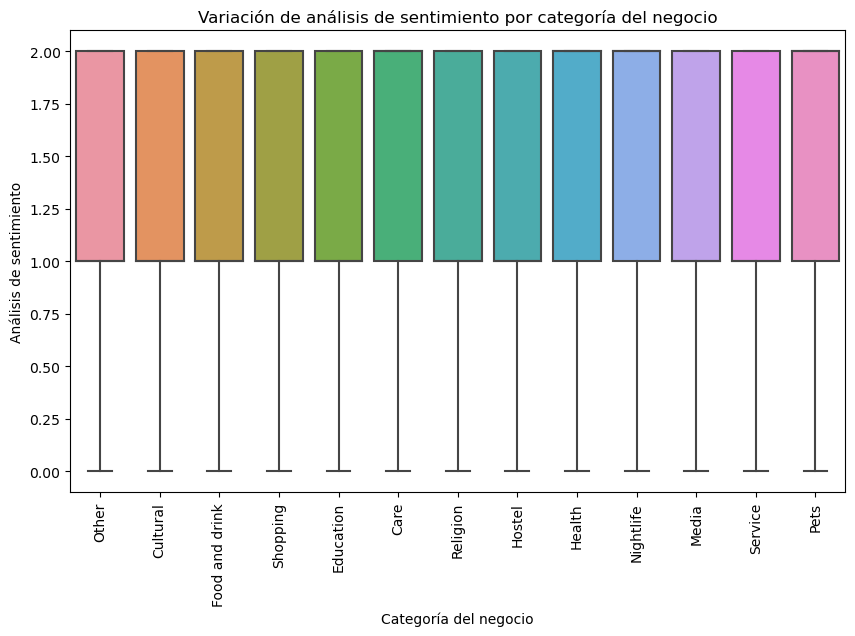

In [72]:
variacion_sentimiento_por_categoria(df_ESTADOS, df_METADATA)

  
Estas preguntas permiten identificar los negocios con la mejor calificación promedio, explorar las categorías más comunes de los negocios y entender posibles patrones geográficos relacionados con las categorías de los negocios.

## _Estados._

¿Cuál es la distribución de las calificaciones (RATING) de los usuarios?  

StatementMeta(, 0fb142f1-1807-4378-bfee-19c59e7e5616, 25, Finished, Available)

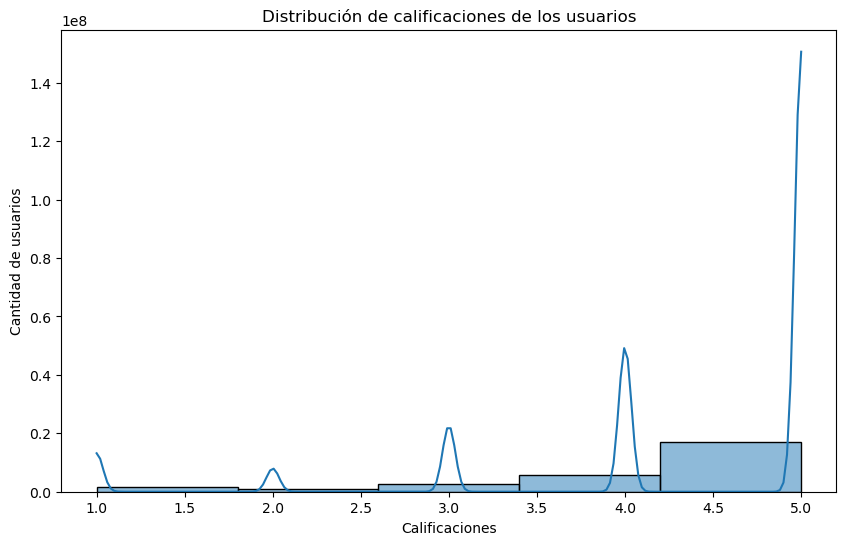

In [23]:
distribucion_calificaciones_usuarios(df_ESTADOS)


¿Cuál es el estado (STATE) con mayor cantidad de registros?  


StatementMeta(, 0fc8c020-2632-44a0-90e3-b057ca4b9c8e, 82, Finished, Available)

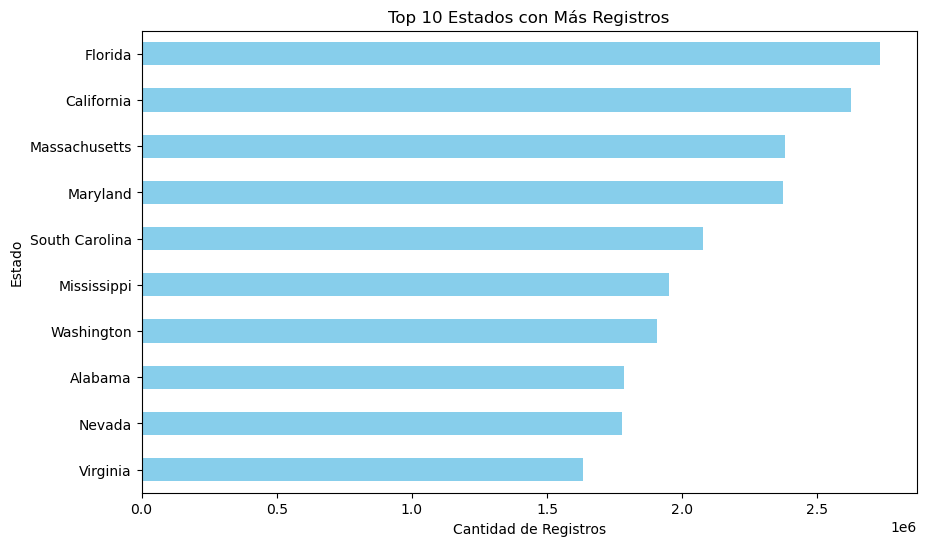

In [80]:
graficar_top_10_estados_con_mas_registros(df_ESTADOS)

¿Qué tendencia muestra el análisis de sentimiento (SENTIMENT_ANALYSIS) en relación con las fechas (DATE) de los registros?  


StatementMeta(, 0fb142f1-1807-4378-bfee-19c59e7e5616, 28, Finished, Available)

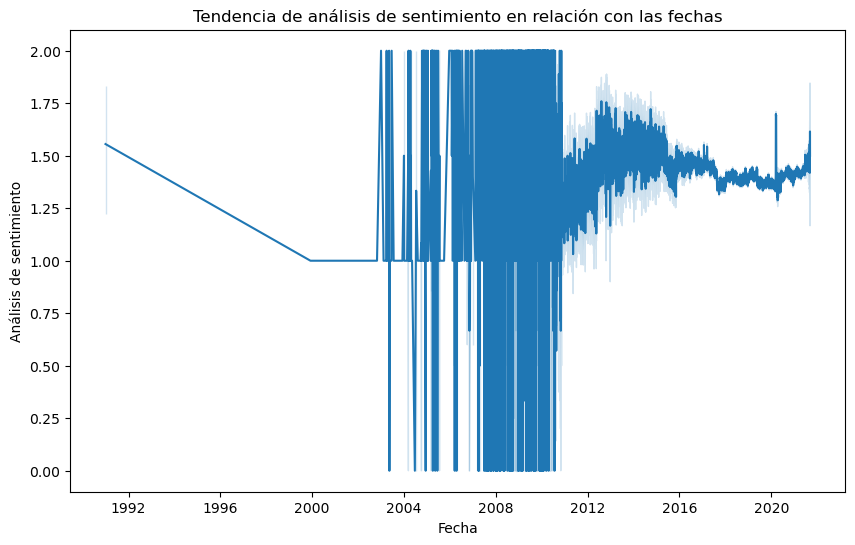

In [26]:
tendencia_sentimiento_por_fecha(df_ESTADOS)

¿Cómo varía el análisis de sentimiento (SENTIMENT_ANALYSIS) en función de las diferentes calificaciones (RATING)?  


StatementMeta(, 0fb142f1-1807-4378-bfee-19c59e7e5616, 29, Finished, Available)

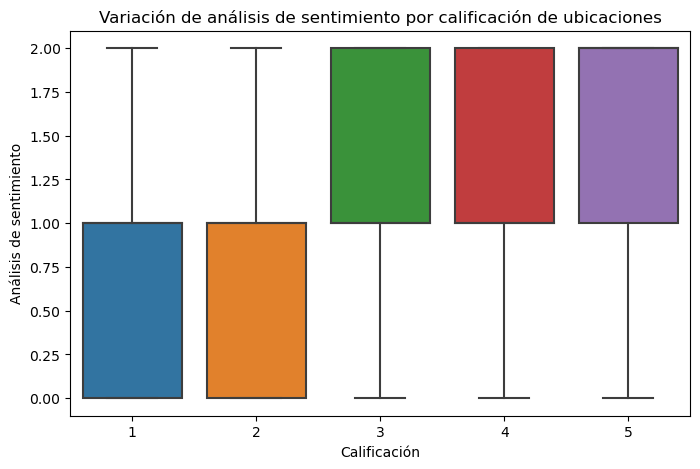

In [27]:
 variacion_sentimiento_por_calificacion(df_ESTADOS)

¿Existe alguna relación entre la fecha (DATE) y el análisis de sentimiento de las revisiones?  


StatementMeta(, 0fb142f1-1807-4378-bfee-19c59e7e5616, 30, Finished, Available)

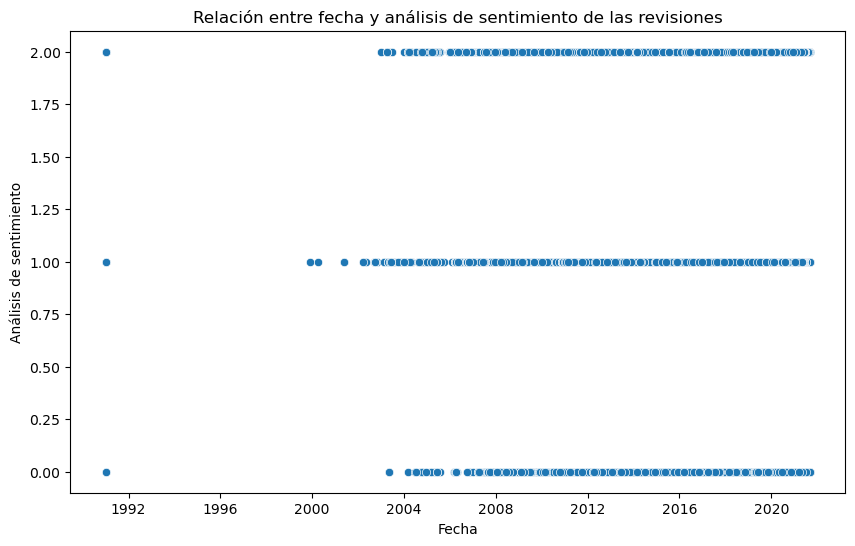

In [28]:
relacion_fecha_sentimiento(df_ESTADOS)

¿Cuál es la distribución de las calificaciones (RATING) para cada estado (STATE)?  

StatementMeta(, 0fb142f1-1807-4378-bfee-19c59e7e5616, 31, Finished, Available)

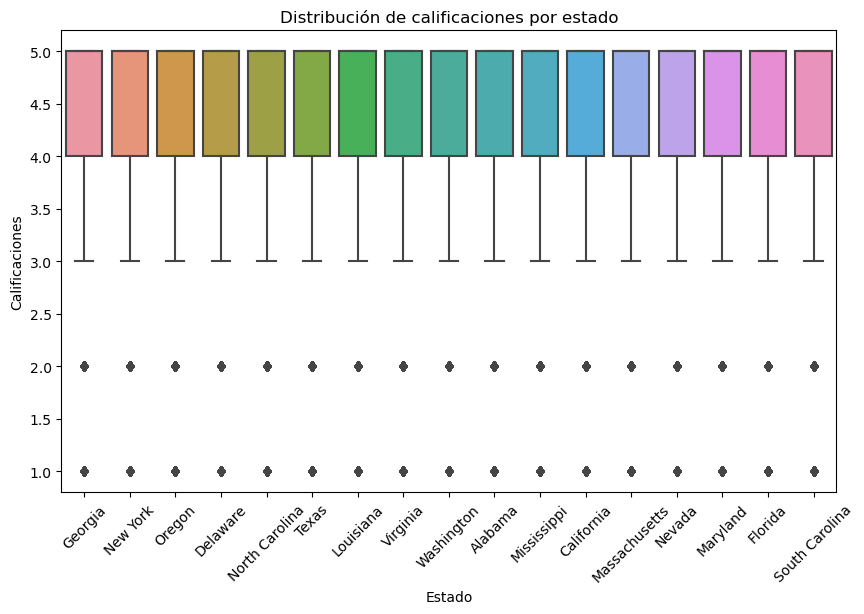

In [29]:
 distribucion_calificaciones_por_estado(df_ESTADOS)

Estas preguntas nos ayudarán a comprender la distribución de las calificaciones de los usuarios, identificar los estados más representados en los datos y explorar cualquier tendencia en el análisis de sentimientos a lo largo del tiempo.

# **TRIP ADVISOR**

## _Trip._

¿Cuáles son las 10 ubicaciones con el mayor número de visitas (ID)?  

StatementMeta(, d12ee513-017a-48d4-bd42-d273b59548d3, 51, Finished, Available)

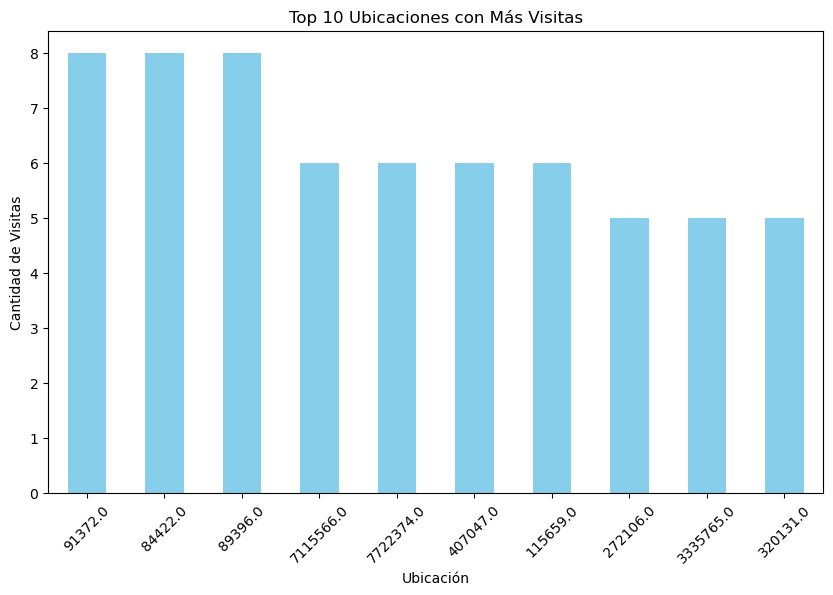

In [51]:
graficar_top_10_ubicaciones_con_mas_visitas(df_TRIP)

¿Cómo varía la distribución de calificaciones (RATING) en función del estado (STATE)?  


StatementMeta(, 0fb142f1-1807-4378-bfee-19c59e7e5616, 34, Finished, Available)

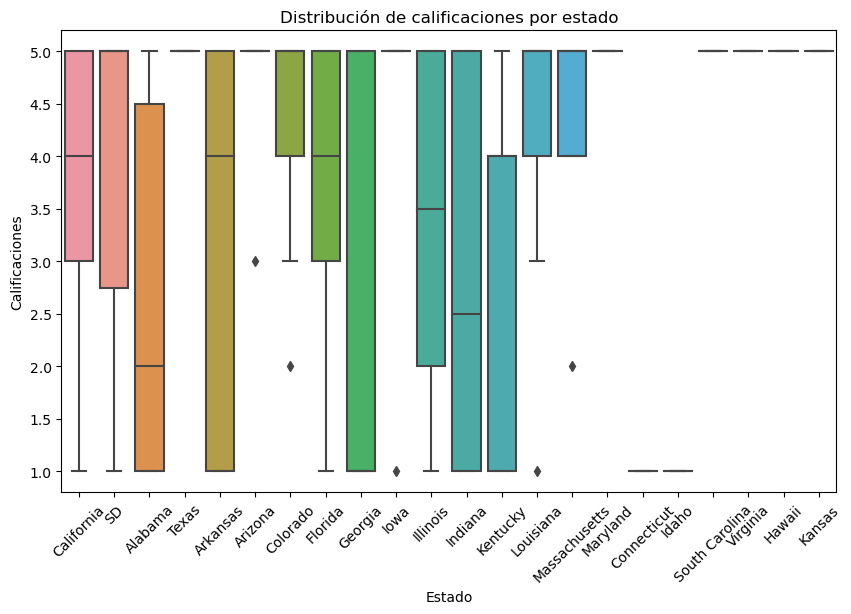

In [32]:
distribucion_calificaciones_por_estado(df_TRIP)

¿Qué tendencia muestra el análisis de sentimiento en relación con las visitas?  


StatementMeta(, 0fb142f1-1807-4378-bfee-19c59e7e5616, 35, Finished, Available)

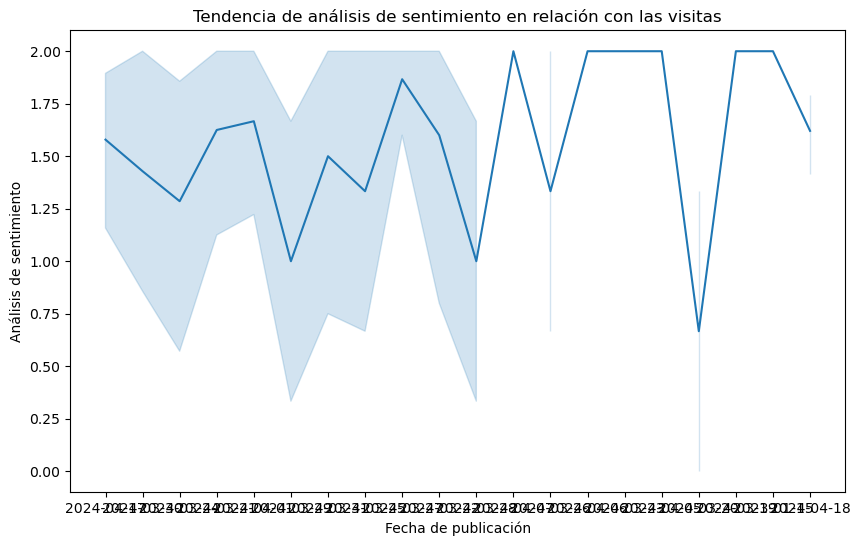

In [33]:
tendencia_sentimiento_por_visitas(df_TRIP)

¿Cómo varía el análisis de sentimiento en función de la calificación de las ubicaciones (RATING)?  


StatementMeta(, 0fb142f1-1807-4378-bfee-19c59e7e5616, 36, Finished, Available)

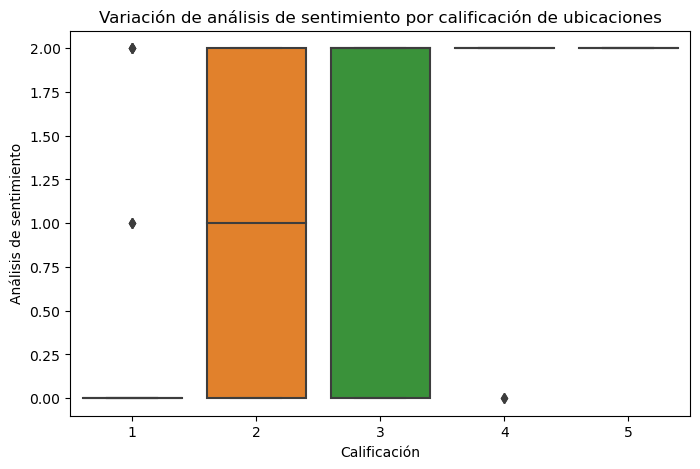

In [34]:
variacion_sentimiento_por_calificacion(df_TRIP)

¿Existe alguna relación entre el número de visitas (ID) y la calificación promedio de las ubicaciones?  


StatementMeta(, 56897517-a7cc-497e-83d8-af77e7a5c3c4, 51, Finished, Available)

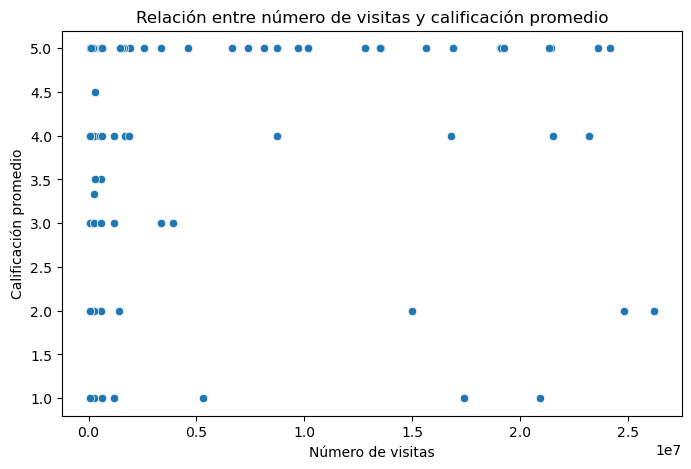

In [49]:
relacion_visitas_calificacion_promedio(df_TRIP)

¿Qué tipo de análisis de sentimiento prevalece en las ubicaciones con altas calificaciones?  


StatementMeta(, 0fb142f1-1807-4378-bfee-19c59e7e5616, 38, Finished, Available)

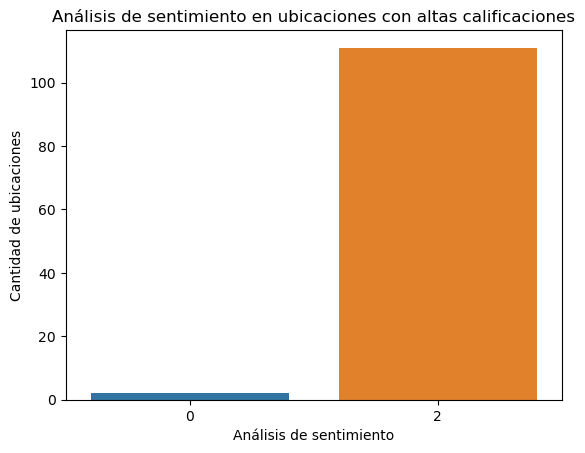

In [36]:
sentimiento_en_ubicaciones_con_altas_calificaciones(df_TRIP)

Estas preguntas nos ayudarán a identificar las ubicaciones más visitadas, explorar la distribución de calificaciones por estado y entender cómo se relaciona el análisis de sentimientos con las visitas realizadas.

# **CENSO**

## _Censo._

¿Cuál es el tamaño promedio de las áreas estadísticas metropolitanas (METROPOLITAN_STATISTICAL_AREA_SIZE)?   


In [37]:
tamaño_promedio_areas_estadisticas(df_CENSO)

StatementMeta(, 0fb142f1-1807-4378-bfee-19c59e7e5616, 39, Finished, Available)

3.6278934575524686

¿Cuáles son los 10 estados con mayor cantidad de registros?  


StatementMeta(, d12ee513-017a-48d4-bd42-d273b59548d3, 54, Finished, Available)

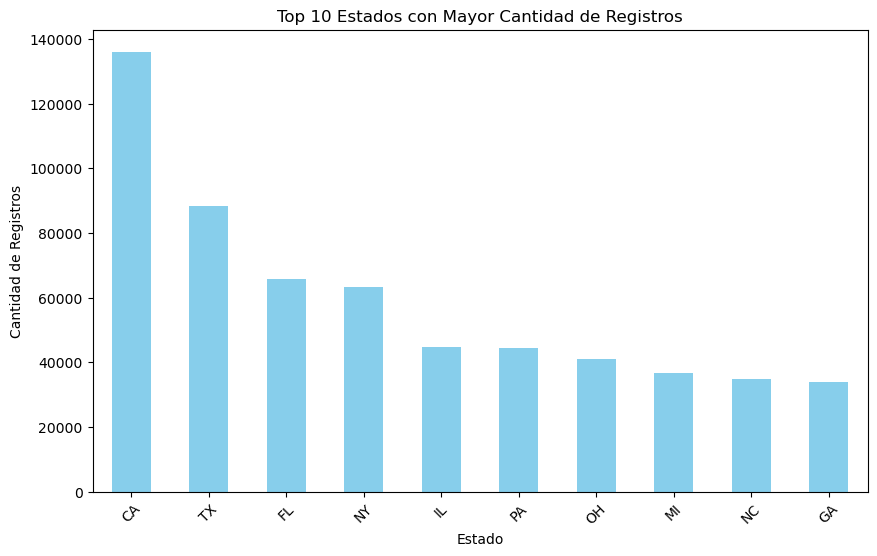

In [54]:
graficar_top_10_estados_con_mas_registros(df_CENSO)

¿Cómo varía la cantidad de registros en función del año de registro (REGISTRATION_YEAR)?  


StatementMeta(, 0fb142f1-1807-4378-bfee-19c59e7e5616, 41, Finished, Available)

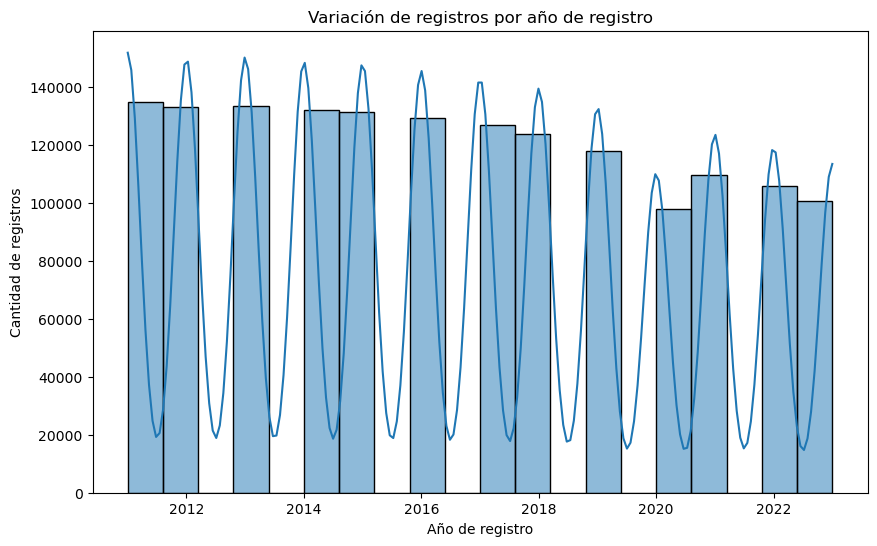

In [39]:
variacion_registros_por_año(df_CENSO)

Estas preguntas nos permitirán entender el tamaño promedio de las áreas estadísticas metropolitanas, identificar los estados más representados en los datos y explorar cualquier tendencia en la cantidad de registros a lo largo de los años.

# <h1 align= 'center'>**VISUALIZACIÓN DE SENTIMIENTOS**</h>

## _Estados._

In [ ]:
visualize_reviews(df_ESTADOS)

## _Review._

In [46]:
visualize_reviews(df_REVIEW)

StatementMeta(, feccef4b-c867-465c-80fb-95beaf0f2752, 48, Submitted, Running)

## _Tip._

StatementMeta(, feccef4b-c867-465c-80fb-95beaf0f2752, 42, Finished, Available)

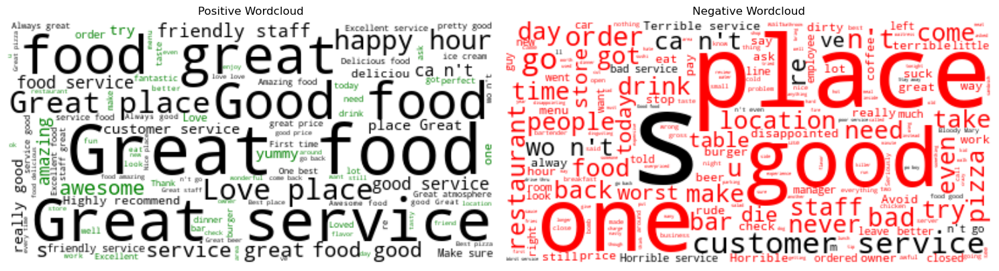

In [40]:
visualize_reviews(df_TIP)

En este análisis con nube de palabras analizamos el contexto en los hoteles Wyndham con el Webscraping realizado en la empresa Tripadvisor, analizamos en este caso los negocios relacionados al turismo y podemos observar en el gráfico de la izquierda reseñas positivas en dónde “great food” habla de la comida es excelente, proporcionan los locales un buen servicio muy aceptable.

Por el contrario en el gráfico de nube de palabras de la derecha es el contraste, habla de un mal servicio donde el consumidor se decepcionó.
También podemos aportar los aspectos más fuertes que destacan la calidad de la comida como el servicio dando como resultado tienen una experiencia positiva en general destacándose palabras como “great”, “love”.

Un aspecto débil a mejorar es el servicio y la experiencia en general porque “bad”, “service” y “worst” son notables.

Aquí haremos un párrafo aparte de “place” porque pudimos observar que aparece tanto en los comentarios positivos como negativos y podemos indicar que la ubicación es un punto de enfoque a analizar como lo es en este trabajo.

Por último como consultora, nuestra oportunidad de mejora está focalizada en el servicio y atención al cliente. Es un factor importante a la hora de realizar capacitaciones al personal.


## _Trip._

StatementMeta(, feccef4b-c867-465c-80fb-95beaf0f2752, 38, Finished, Available)

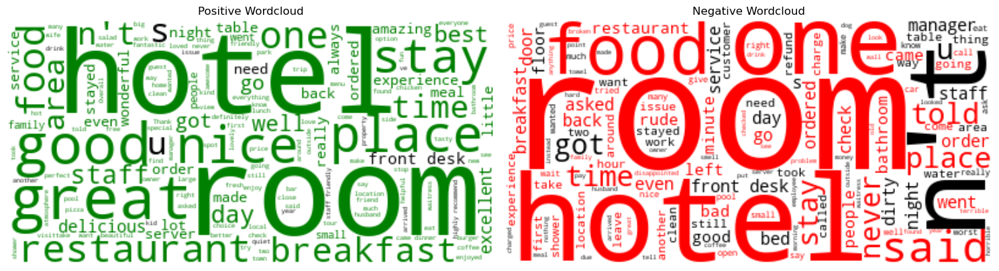

In [36]:
visualize_reviews(df_TRIP)

Continuando con el análisis del Webscraping de Tripadvisor, nos posicionaremos en los hoteles.

Aquí al igual que el script anterior, primero analizaremos la nube de palabras de la izquierda dónde toma aspectos positivos del “hotel”, “room”, “place” es dónde se cumplió con la expectativa que tenía el cliente respecto a la relación precio calidad ofreciendo un buen servicio e infraestructura en general.

Ya centrándonos un poco más en el servicio propio de los hoteles, hay una aceptación generalizada en “stay”, “service” y el “breakfast” dónde la relación servicio, espacio o ambientación es acorde a una percepción placentera en el servicio que se consume.

Por el contrario nos encontramos en la segunda nube de palabras con reseñas negativas que tocan los mismos tópicos de las reseñas positivas pero resaltando “front desk”, “time” o el producto “bad”.
Hablaremos de aspectos más fuertes en dónde la calidad del hotel, la habitación en general tienen servicios acordes y la experiencia es agradable.
Por el contrario, la habitación y la comunicación en el hotel debe ser un tema de mejora para el establecimiento.
Una oportunidad de mejora es el servicio al cliente, un aspecto fundamental en la percepción del cliente.
 

# <h1 align= 'center'>**CONCLUSIONES**</h1>

Comprensión de los datos: El EDA permite explorar y comprender los datos en profundidad. Ayuda a identificar la distribución de los datos, valores atípicos, correlaciones entre variables y otras características importantes. Esta comprensión es esencial para tomar decisiones informadas sobre qué características incluir en el modelo y cómo procesarlas.   
Selección de características: El EDA proporciona información sobre qué características pueden ser relevantes para el problema en cuestión. Esto guía el proceso de selección de características, ayudando a identificar aquellas que tienen una relación significativa con la variable objetivo.    
Detección de problemas en los datos: Durante el EDA, se pueden identificar problemas como datos faltantes, valores atípicos o inconsistencias en los datos. Abordar estos problemas es crucial para construir modelos de ML robustos y precisos.   
Validación de suposiciones: El EDA permite validar las suposiciones hechas sobre los datos y el problema en estudio. Por ejemplo, si se asume que ciertas variables están correlacionadas, el EDA puede confirmar o refutar esta suposición.    
Optimización de recursos: Al comprender mejor los datos, se pueden optimizar los recursos utilizados en el desarrollo de modelos de ML. Esto incluye decidir qué técnicas de preprocesamiento son necesarias y cuánto tiempo y esfuerzo dedicar a cada etapa del proceso.    
En resumen, un informe de EDA proporciona una base sólida para el feature engineering y el desarrollo de modelos de ML, al proporcionar información crucial sobre los datos que guía las decisiones en todo el proceso de construcción del modelo.    

# <h1 align= 'center'>**DICCIONARIO DE DATOS**</h1>

# Diccionario.

<details>
<summary><strong>YELP</strong></summary>
<ul>
    <details>
    <summary>REVIEW</summary>
    <ul>
    <br><br>
    Contiene las reseñas completas, incluyendo el user_id que escribió el review y el business_id por el cual se escribe la reseña.
    <br><br>
    
| NOMBRE DE LA COLUMNA | TIPO DE DATO | CONTENIDO |
|-------------------|--------------|-----------|
| REVIEW_ID         | String       | "zdSx_SD6obEhz9VrW9uAWA" |
| USER_ID           | String       | "Ha3iJu77CxlrFm-vQRs_8g" |
| BUSINESS_ID       | String       | "tnhfDv5Il8EaGSXZGiuQGg" |
| STARS             | Entero       | 4 |
| DATE              | String       | "2016-03-09" |
| SENTIMENT_ANALYSIS| Entero       | 0 |
    
</ul>
</details>
<br>
    <details>
    <summary>USER</summary>
    <ul>
    <br><br>
    Data del usuario incluyendo referencias a otros usuarios amigos y a toda la metadata asociada al usuario.
    <br><br>
    
| NOMBRE DE LA COLUMNA  | TIPO DE DATO | CONTENIDO |
|--------------------|--------------|-----------|
| USER_ID            | String       | "Ha3iJu77CxlrFm-vQRs_8g" |
| NAME               | String       | "Sebastien" |
| REVIEW_COUNT       | Entero       | 56 |
    
</ul>
</details>
<br>    
    <details>
    <summary>TIP</summary>
    <ul>
    <br><br>
    Tips escritos por el usuario. Los tips son más cortas que las reseñas y tienden a dar sugerencias rápidas.
    <br><br>
    
| NOMBRE DE LA COLUMNA   | TIPO DE DATO | CONTENIDO |
|------------------------|--------------|-----------|
| USER_ID             | String       | "49JhAJh8vSQ-vM4Aourl0g" |
| BUSINESS_ID         | String       | "tnhfDv5Il8EaGSXZGiuQGg" |
| DATE                | String       | "2013-09-20" | 
| SENTIMENT_ANALYSIS  | Entero       | 1 |

</ul>
</details>
<br>    
    <details>
    <summary>BUSINESS</summary>
    <ul>
    <br><br>
    Contiene información del comercio, incluyendo localización, atributos y categorías.
    <br><br>

| NOMBRE DE COLUMNA | TIPO DE DATO | CONTENIDO |
|-------------------|--------------|-----------|
| BUSINESS_ID       | String       | "tnhfDv5Il8EaGSXZGiuQGg" |
| NAME              | String       | "Garaje" |
| CITY              | String       | "San Francisco" |
| STATE             | String       | "CA" |
| LATITUDE          | Float        | 37.7817529521 |
| LONGITUDE         | Float        | -122.39612197 |
| STARS             | Float        | 4.5 |
| REVIEW_COUNT      | Entero       | 1198 |
| CATEGORIES        | Lista        | ["Mexican", "Burgers", "Gastropubs"] |
| CATEGORIEPERS     | String       | 'Shopping' |
    
</ul>
</details>    
<br>
    <details>
    <summary>CHECKIN</summary>
    <ul>
    <br><br>
    Contiene información del comercio, incluyendo localización, atributos y categorías.
    <br><br>

| NOMBRE DE COLUMNA | TIPO DE DATO | CONTENIDO |
|-------------------|--------------|-----------|
| BUSINESS_ID       | String       | "tnhfDv5Il8EaGSXZGiuQGg" |
| DATE              | String       | "2016-04-26 19:49:16, 2016-08-30 18:36:57, 2016-10-15 02:45:18, 2016-11-18 01:54:50, 2017-04-20 18:39:06, 2017-05-03 17:58:02" |
| COUNT_CHECKIN     | Entero       | "5" |


</ul>
</details>
</ul>
</details>

<details>
<summary><strong>GOOGLE</strong></summary>
<ul>
    <details>
    <summary>METADATA</summary>
    <ul>
    <br>
    En el archivo se dispone la metadata referente a información del comercio, incluyendo localización, atributos y categorías.
    <br><br>
    
| NOMBRE DE COLUMNA | TIPO DE DATO | CONTENIDO |
|--------------------|--------------|-----------|
| NAME               | String       | 'Walgreens Pharmacy' |
| ADDRESS            | String       | 'Walgreens Pharmacy, 124 E North St, Kendallville, IN 46755' |
| GMAP_ID            | String       | '0x881614ce7c13acbb:0x5c7b18bbf6ec4f7e' |
| AVG_RAITING        | Decimal      | 4.2 |
| NUM_OF_REVIEWS     | Entero       | 5 |
| URL                | String       | 'https://www.google.com/maps/place//data=!4m2!3m1!1s0x881614ce7c13acb b:0x5c7b18bbf6ec4f7e?authuser=-1&hl=en&gl=us' |
| CATEGORY           | String       | ['Pharmacy'] 
| CATEGORY_SUMARY    | String       | 'Shopping' |
| LATITUDE           | Decimal      | 41.451859999999996 |
| LONGITUDE          | Decimal      | -85.2666757 |

</ul>
</details>
<br>
    <details>
    <summary>ESTADOS</summary>
    <ul>
    <br>
    El archivo donde se disponibiliza las reviews de los usuarios de los estados de USA. 
    <br><br>
    
| NOMBRE DE COLUMNA | TIPO DE DATO    | CONTENIDO |
|-------------------|-----------------|-----------|
| USER_ID           | Entero/Decimal  | '101463350189962023774' |
| NAME              | String          | 'Jordan Adams' |
| RATING            | Entero          | 5 |
| GMAP_ID           | String          | '0x87ec2394c2cd9d2d:0xd1119cfbee0da6f3' |
| STATE             | String          | 'arizona' |
| DATE              | Date            | '2016-04-26' |

</ul>
</details>
</ul>
</details>

<details>
<summary><strong>TRIP ADVISOR</strong></summary>
<ul>
    <details>
    <summary>TRIPADVISOR</summary>
    <ul>
    <br><br>
    Contiene las reseñas completas del sitio web https://www.tripadvisor.com.ar/developers.
    <br><br>
    
| NOMBRE DE COLUMNA | TIPO DE DATO | CONTENIDO |
|-------------------|--------------|-----------|
| ID                | String       | "945868640" |
| LOCATION_ID       | String       | "7184808" |
| PUBLISH_DATE      | String       | "2024-04-08T14:18:25Z" |
| RATING            | Entero       | 4 |
| TITLE             | String       | 'Worth the visit if in the area' |
| USERNAME          | String       | 'tinkerbsb' |
| STATE		        | String       | 'Alabama' |
| NAME		        | String       | 'Foley' |
| LATITUDE	        | Float        | 30.40585 |
| LONGITUDE 	    | Float        | '-87.6838' |
| SENTIMENT_ANALISYS| Entero       | '2' |
    
</ul>
</details>
</ul>
</details>

<details>
<summary><strong>CENSO</strong></summary>
<ul>
    <details>
    <summary>CENSO</summary>
    <ul>
    <br><br>
    Contiene datos demográficos y estadísticas relacionadas con la población de Estados Unidos.
    <br><br>
    
| NOMBRE DE LA COLUMNA | TIPO DE DATO | CONTENIDO |
|----------------------|--------------|-----------|
| METROPOLITAN_STATICAL_AREA | Entero | '5' |
| STATE_ZONE          | Entero       | '1' |
| REGISTRATION_YEAR   | AÑO_REGISTRO| Entero       | '2011' |